In [3]:
%run setup.ipynb
%aimport peakfit
rcParams['figure.dpi'] = 120

In [4]:
ihs_raw = phase1_selection.ihs_raw
ihs_raw

Group(/, 5)
  groups: 5; 2L, 2R, 3L, 3R, X
  store: DirectoryStore

## Try filtering by selected allele count

In [12]:
seqid = '3R'
pop = 'BFS'

In [13]:
callset_phased = phase1_ar31.callset_phased
df_samples = phase1_ar3.df_samples
df_samples.head()

,ox_code,src_code,sra_sample_accession,population,country,region,contributor,contact,year,m_s,...,pca_3L_free_pc3,pca_3L_free_pc4,pca_2La_pc1,pca_2La_pc2,pca_2La_pc3,pca_2La_pc4,pca_2Rb_pc1,pca_2Rb_pc2,pca_2Rb_pc3,pca_2Rb_pc4
index,,,,,,,,,,,,,,,,,,,,,
0,AB0085-C,BF2-4,ERS223996,BFS,Burkina Faso,Pala,Austin Burt,Sam O'Loughlin,2012,S,...,-8.290940,-18.542768,-55.511389,32.682143,-1.833739,-0.381984,-38.934301,31.939383,19.345606,7.362004
1,AB0087-C,BF3-3,ERS224013,BFM,Burkina Faso,Bana,Austin Burt,Sam O'Loughlin,2012,M,...,-38.603076,76.915617,-51.856633,27.401249,2.586488,0.643100,-10.072879,29.007266,-21.736087,-30.309562
2,AB0088-C,BF3-5,ERS223991,BFM,Burkina Faso,Bana,Austin Burt,Sam O'Loughlin,2012,M,...,-35.553340,73.985488,-50.942456,28.572207,3.072583,-0.643137,12.281744,22.288417,-43.661301,-51.557140
3,AB0089-C,BF3-8,ERS224031,BFM,Burkina Faso,Bana,Austin Burt,Sam O'Loughlin,2012,M,...,-36.621568,76.453993,-51.169247,29.414975,2.198434,0.013562,-10.664072,29.601333,-16.831559,-25.452854
4,AB0090-C,BF3-10,ERS223936,BFM,Burkina Faso,Bana,Austin Burt,Sam O'Loughlin,2012,M,...,-36.097756,72.036309,-48.607416,26.407532,1.643226,0.102582,12.897113,22.194444,-48.882378,-52.420487


In [14]:
hap_samples = callset_phased[seqid]['samples'][:].astype('U').tolist()
len(hap_samples)

773

In [15]:
df_samples[df_samples.population == pop].sex.value_counts()

F    61
M    20
Name: sex, dtype: int64

In [16]:
# watch out for males on X!
pop_ixs = [hap_samples.index(s) for s in df_samples.ox_code[df_samples.population == pop] if s in hap_samples]
len(pop_ixs)

81

In [17]:
genotype = callset_phased[seqid]['calldata/genotype']
g_pop = allel.GenotypeDaskArray(callset_phased[seqid]['calldata/genotype'], chunks=(genotype.chunks[0]*64, None, None)).take(pop_ixs, axis=1)
g_pop

<GenotypeDaskArray shape=(10178803, 81, 2) dtype=int8>

In [18]:
ac_pop = g_pop.count_alleles(max_allele=1).compute()
ac_pop

<AlleleCountsArray shape=(10178803, 2) dtype=int64>
162   0
161   1
162   0
...
162   0
155   7
159   3

In [19]:
loc_asc = ac_pop.min(axis=1) > 1
np.count_nonzero(loc_asc)

2131744

In [20]:
h_asc = g_pop.compress(loc_asc, axis=0).to_haplotypes().compute()
h_asc

/home/aliman/src/github/malariagen/agam-selection-atlas/deps/conda/envs/agam-selection-atlas/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:


<HaplotypeArray shape=(2131744, 162) dtype=int8>
0 0 0 0 0 ... 0 0 0 1 1
0 0 0 0 0 ... 0 0 0 0 0
0 0 0 0 0 ... 0 0 0 0 0
...
0 0 0 0 0 ... 0 0 0 0 0
0 0 0 1 0 ... 0 0 0 0 0
0 0 0 0 1 ... 0 0 0 0 0

In [21]:
pos_asc = callset_phased[seqid]['variants/POS'][:][loc_asc]
pos_asc

array([    8391,     8448,     8534, ..., 53195273, 53196406, 53196408], dtype=int32)

In [22]:
ac_asc = ac_pop[loc_asc]
ac_asc

<AlleleCountsArray shape=(2131744, 2) dtype=int64>
152  10
159   3
157   5
...
158   4
155   7
159   3

In [23]:
ihs_values = allel.ihs(h_asc, pos_asc, min_ehh=0.05, min_maf=0.05, include_edges=True, gap_scale=2000, max_gap=200000)

In [27]:
miss = np.isnan(ihs_values)
ihs_nm = ihs_values[~miss]
pos_nm = pos_asc[~miss]
ac_nm = ac_asc[~miss]

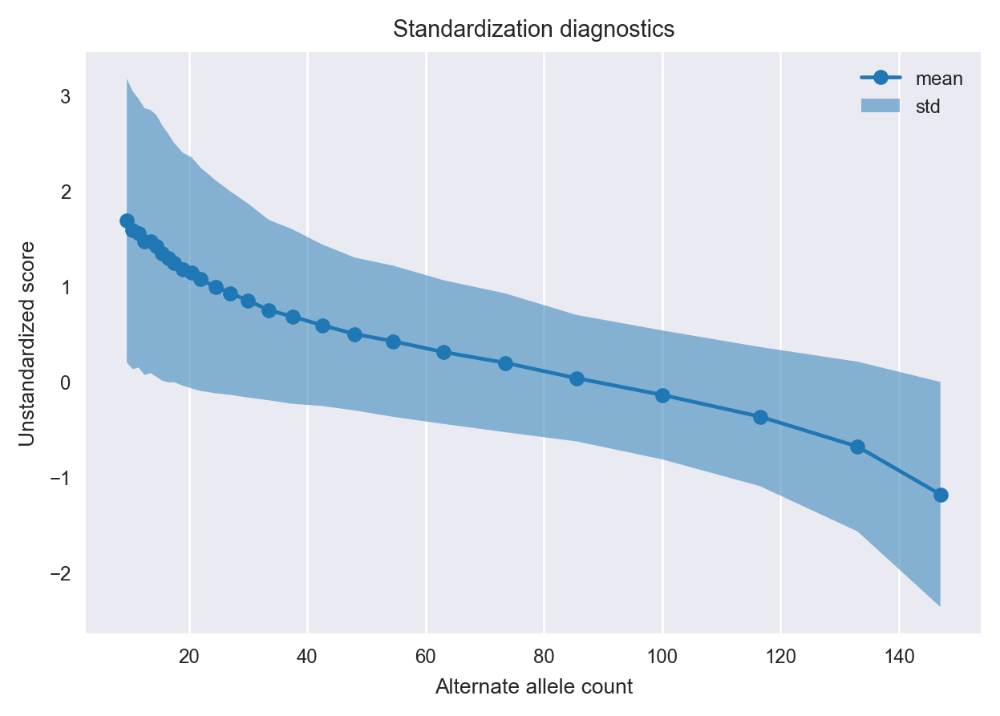

In [28]:
x = ac_nm[:, 1]
y = ihs_nm
ihs_std, _ = allel.standardize_by_allele_count(y, x, n_bins=30, diagnostics=True)

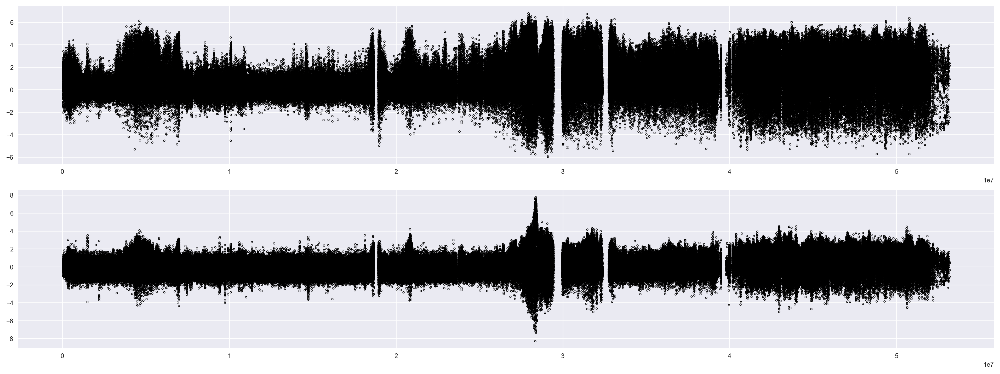

In [31]:
fig, axs = plt.subplots(nrows=2, figsize=(16, 6))
x = pos_nm
y1 = ihs_nm
y2 = ihs_std

axs[0].plot(x, y1, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5);
axs[1].plot(x, y2, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5);
fig.tight_layout()
#ax.set_xlim(8e6, 11e6);

In [67]:
ac_sel = np.where(ihs_std > 0, ac_nm[:, 1], ac_nm[:, 0])
ac_sel

array([ 10, 152,  15, ...,  11, 148,  10])

In [68]:
ac_sel.max()

153

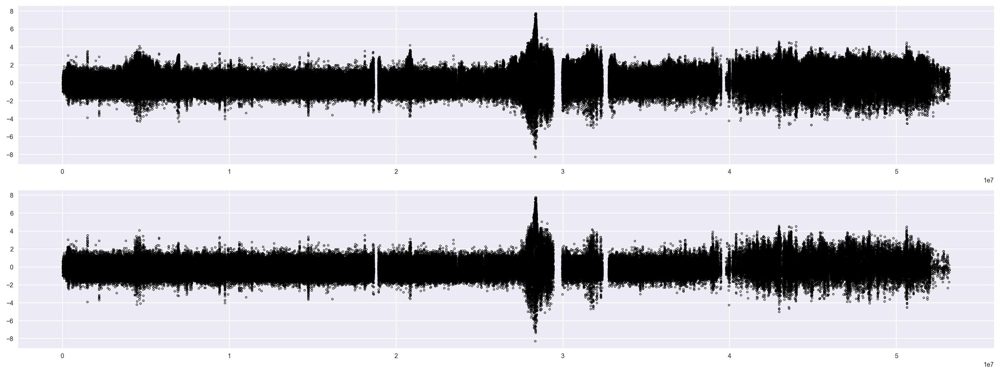

In [70]:
loc_flt = (ac_sel / ac_sel.max()) > 0.3
x1 = pos_nm
y1 = ihs_std
x2 = pos_nm[loc_flt]
y2 = ihs_std[loc_flt]

fig, axs = plt.subplots(nrows=2, figsize=(16, 6))

axs[0].plot(x1, y1, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5);
axs[1].plot(x2, y2, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5);
fig.tight_layout()


In [58]:
x2.shape[0] / (len(genome[seqid]) / 10000)

88.45600556564273

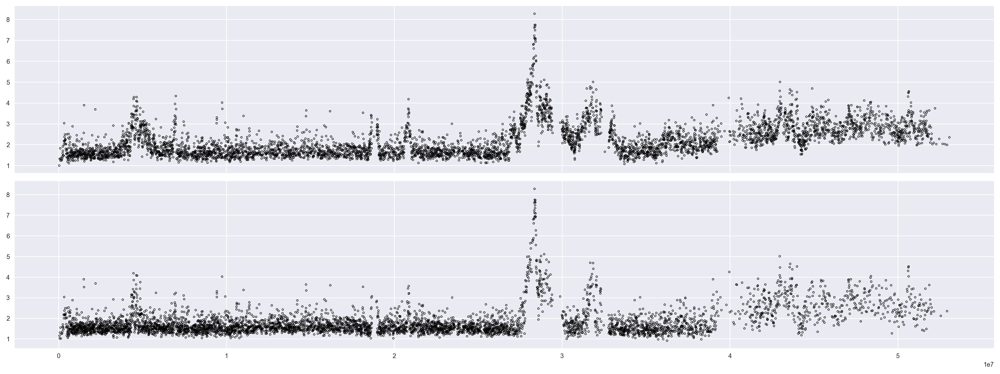

In [71]:
loc_flt = (ac_sel / ac_sel.max()) > 0.3
x1 = pos_nm
y1 = np.abs(ihs_std)
x2 = pos_nm[loc_flt]
y2 = np.abs(ihs_std[loc_flt])

x1w = allel.moving_statistic(x1, statistic=np.mean, size=int(x1.shape[0] / (len(genome[seqid]) / 10000)))
y1w = allel.moving_statistic(y1, statistic=np.max, size=int(x1.shape[0] / (len(genome[seqid]) / 10000)))
x2w = allel.moving_statistic(x2, statistic=np.mean, size=int(x2.shape[0] / (len(genome[seqid]) / 10000)))
y2w = allel.moving_statistic(y2, statistic=np.max, size=int(x2.shape[0] / (len(genome[seqid]) / 10000)))

fig, axs = plt.subplots(nrows=2, figsize=(16, 6), sharex=True)

axs[0].plot(x1w, y1w, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5);
axs[1].plot(x2w, y2w, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5);
fig.tight_layout()



## Try comparing major versus minor allele

In [3]:
seqid = '3R'
pop = 'BFS'

In [4]:
callset_phased = phase1_ar31.callset_phased

In [5]:
df_samples = phase1_ar3.df_samples
df_samples.head()

,ox_code,src_code,sra_sample_accession,population,country,region,contributor,contact,year,m_s,...,pca_3L_free_pc3,pca_3L_free_pc4,pca_2La_pc1,pca_2La_pc2,pca_2La_pc3,pca_2La_pc4,pca_2Rb_pc1,pca_2Rb_pc2,pca_2Rb_pc3,pca_2Rb_pc4
index,,,,,,,,,,,,,,,,,,,,,
0,AB0085-C,BF2-4,ERS223996,BFS,Burkina Faso,Pala,Austin Burt,Sam O'Loughlin,2012,S,...,-8.290940,-18.542768,-55.511389,32.682143,-1.833739,-0.381984,-38.934301,31.939383,19.345606,7.362004
1,AB0087-C,BF3-3,ERS224013,BFM,Burkina Faso,Bana,Austin Burt,Sam O'Loughlin,2012,M,...,-38.603076,76.915617,-51.856633,27.401249,2.586488,0.643100,-10.072879,29.007266,-21.736087,-30.309562
2,AB0088-C,BF3-5,ERS223991,BFM,Burkina Faso,Bana,Austin Burt,Sam O'Loughlin,2012,M,...,-35.553340,73.985488,-50.942456,28.572207,3.072583,-0.643137,12.281744,22.288417,-43.661301,-51.557140
3,AB0089-C,BF3-8,ERS224031,BFM,Burkina Faso,Bana,Austin Burt,Sam O'Loughlin,2012,M,...,-36.621568,76.453993,-51.169247,29.414975,2.198434,0.013562,-10.664072,29.601333,-16.831559,-25.452854
4,AB0090-C,BF3-10,ERS223936,BFM,Burkina Faso,Bana,Austin Burt,Sam O'Loughlin,2012,M,...,-36.097756,72.036309,-48.607416,26.407532,1.643226,0.102582,12.897113,22.194444,-48.882378,-52.420487


In [6]:
hap_samples = callset_phased[seqid]['samples'][:].astype('U').tolist()
len(hap_samples)

773

In [7]:
df_samples[df_samples.population == pop].sex.value_counts()

F    61
M    20
Name: sex, dtype: int64

In [8]:
# watch out for males on X!
pop_ixs = [hap_samples.index(s) for s in df_samples.ox_code[df_samples.population == pop] if s in hap_samples]
len(pop_ixs)

81

In [9]:
genotype = callset_phased[seqid]['calldata/genotype']
genotype.chunks

(678, 773, 2)

In [10]:
np.product(list(genotype.chunks))

1048188

In [11]:
g_pop = allel.GenotypeDaskArray(callset_phased[seqid]['calldata/genotype'], chunks=(genotype.chunks[0]*64, None, None)).take(pop_ixs, axis=1)
g_pop

<GenotypeDaskArray shape=(10178803, 81, 2) dtype=int8>

In [12]:
ac_pop = g_pop.count_alleles(max_allele=1).compute()
ac_pop

<AlleleCountsArray shape=(10178803, 2) dtype=int64>
162   0
161   1
162   0
...
162   0
155   7
159   3

In [13]:
loc_asc = ac_pop.min(axis=1) > 1
np.count_nonzero(loc_asc)

2131744

In [14]:
h_asc = g_pop.compress(loc_asc, axis=0).to_haplotypes().compute()
h_asc

/home/aliman/src/github/malariagen/agam-selection-atlas/deps/conda/envs/agam-selection-atlas/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:


<HaplotypeArray shape=(2131744, 162) dtype=int8>
0 0 0 0 0 ... 0 0 0 1 1
0 0 0 0 0 ... 0 0 0 0 0
0 0 0 0 0 ... 0 0 0 0 0
...
0 0 0 0 0 ... 0 0 0 0 0
0 0 0 1 0 ... 0 0 0 0 0
0 0 0 0 1 ... 0 0 0 0 0

In [15]:
pos_asc = callset_phased[seqid]['variants/POS'][:][loc_asc]
pos_asc

array([    8391,     8448,     8534, ..., 53195273, 53196406, 53196408], dtype=int32)

In [16]:
ac_asc = ac_pop[loc_asc]
ac_asc

<AlleleCountsArray shape=(2131744, 2) dtype=int64>
152  10
159   3
157   5
...
158   4
155   7
159   3

In [17]:
ihs_values = allel.ihs(h_asc, pos_asc, min_ehh=0.05, min_maf=0.05, include_edges=True, gap_scale=2000, max_gap=200000)

In [18]:
ihs_values.shape

(2131744,)

In [19]:
np.count_nonzero(~np.isnan(ihs_values))

728717

In [20]:
miss = np.isnan(ihs_values)
pos_nm = pos_asc[~miss]
ac_nm = ac_asc[~miss]
ihs_vals_nm = ihs_values[~miss]
loc_flip = ac_nm[:, 0] > ac_nm[:, 1]
ihs_vals_flipped = ihs_vals_nm.copy()
ihs_vals_flipped[loc_flip] = -ihs_vals_flipped[loc_flip]

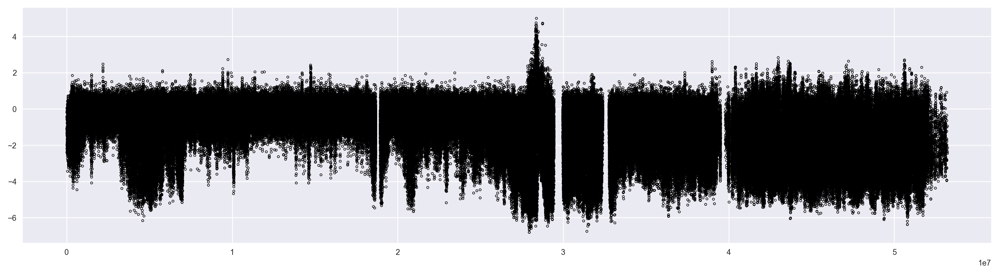

In [21]:
fig, ax = plt.subplots(figsize=(16, 4))
x = pos_nm
y = ihs_vals_flipped
ax.plot(x, y, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5);

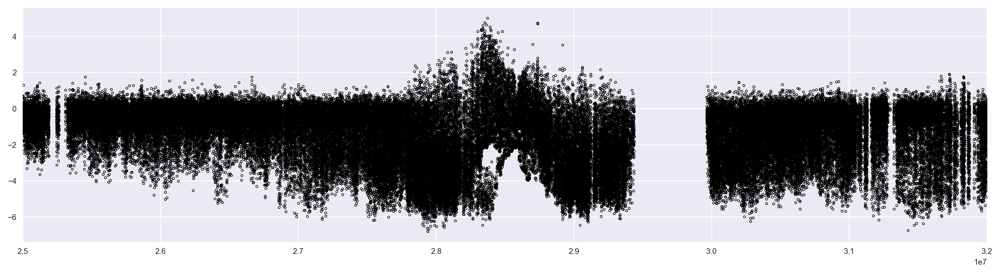

In [23]:
fig, ax = plt.subplots(figsize=(16, 4))
x = pos_nm
y = ihs_vals_flipped
ax.plot(x, y, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5);
ax.set_xlim(25e6, 32e6);

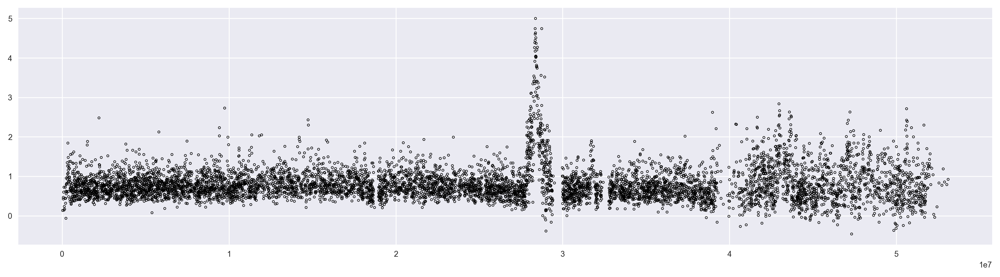

In [24]:
fig, ax = plt.subplots(figsize=(16, 4))
x = pos_nm
y = ihs_vals_flipped
xw = allel.moving_statistic(x, statistic=np.mean, size=100)
yw = allel.moving_statistic(y, statistic=np.max, size=100)
ax.plot(xw, yw, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5);
#ax.set_xlim(25e6, 32e6);

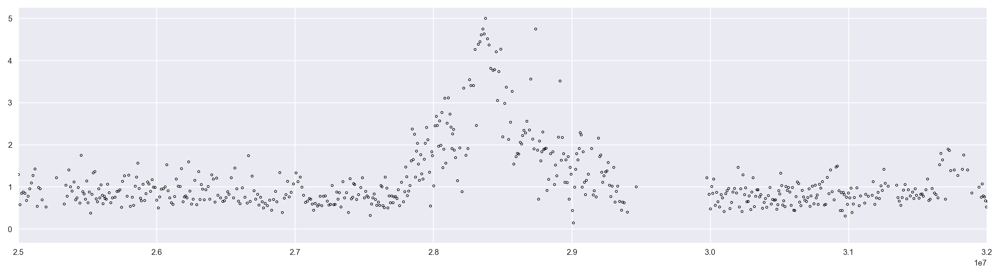

In [27]:
fig, ax = plt.subplots(figsize=(16, 4))
x = pos_nm
y = ihs_vals_flipped
xw = allel.moving_statistic(x, statistic=np.mean, size=200)
yw = allel.moving_statistic(y, statistic=np.max, size=200)
ax.plot(xw, yw, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5);
ax.set_xlim(25e6, 32e6);

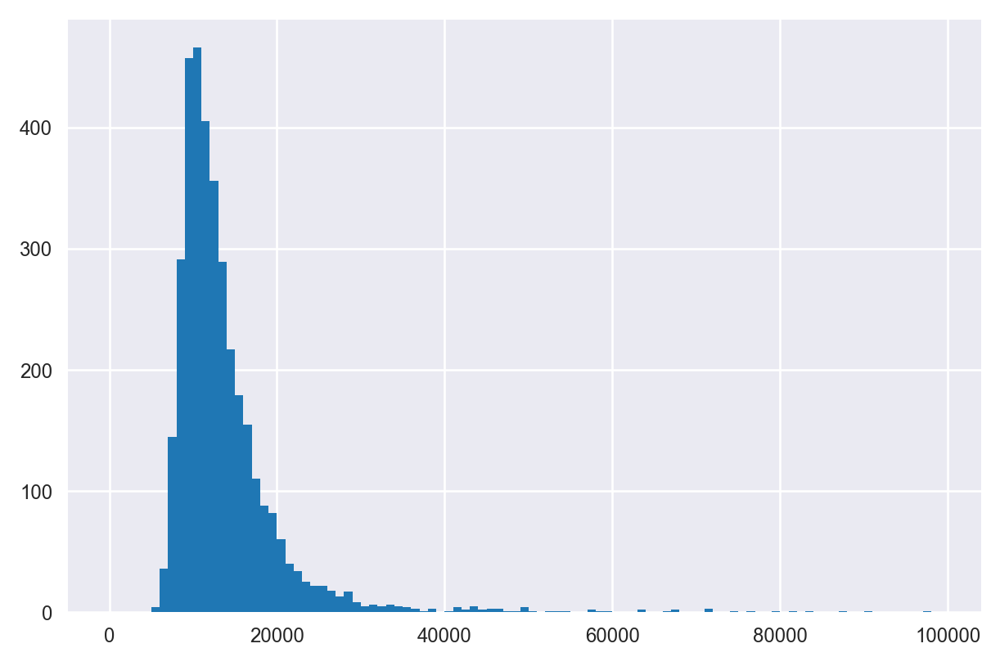

In [28]:
plt.hist(np.diff(xw), bins=np.arange(0, 100000, 1000));

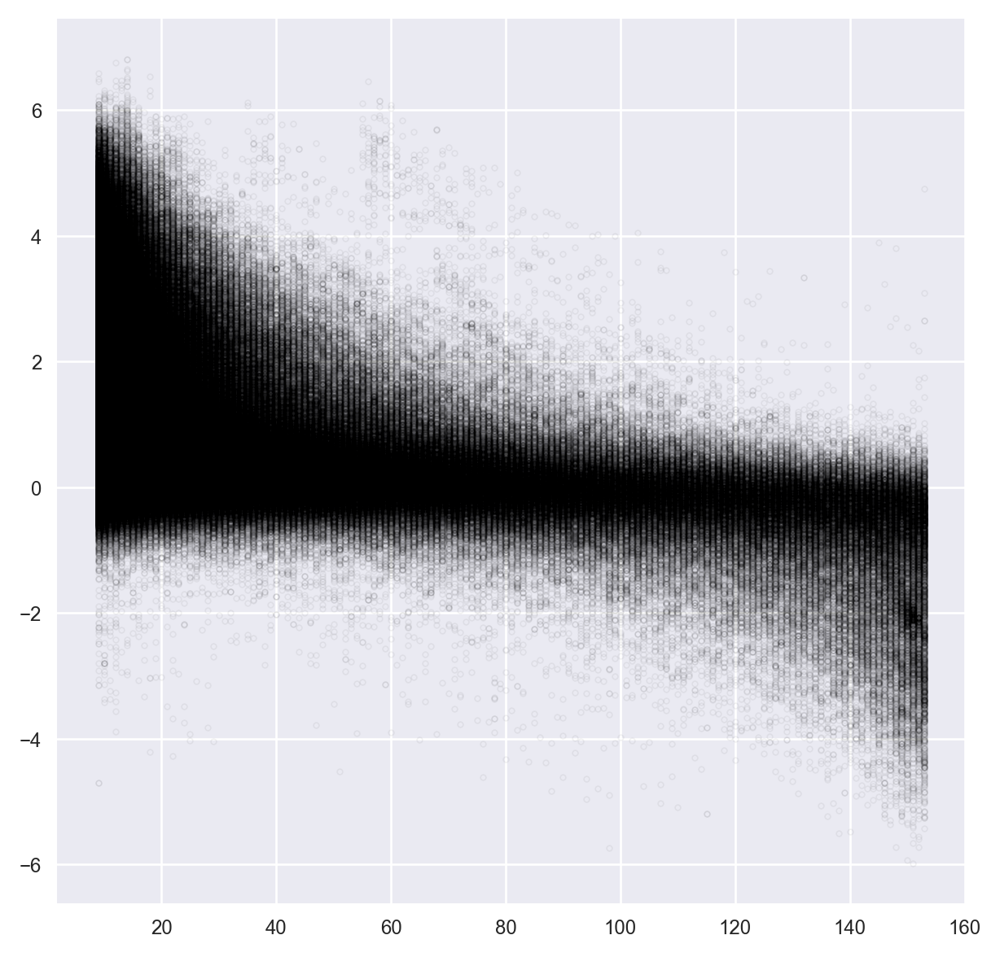

In [32]:
x = ac_nm[:, 1]
y = ihs_vals_nm
fig, ax = plt.subplots(figsize=(6, 6))
ax.plot(x, y, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5, alpha=.05);

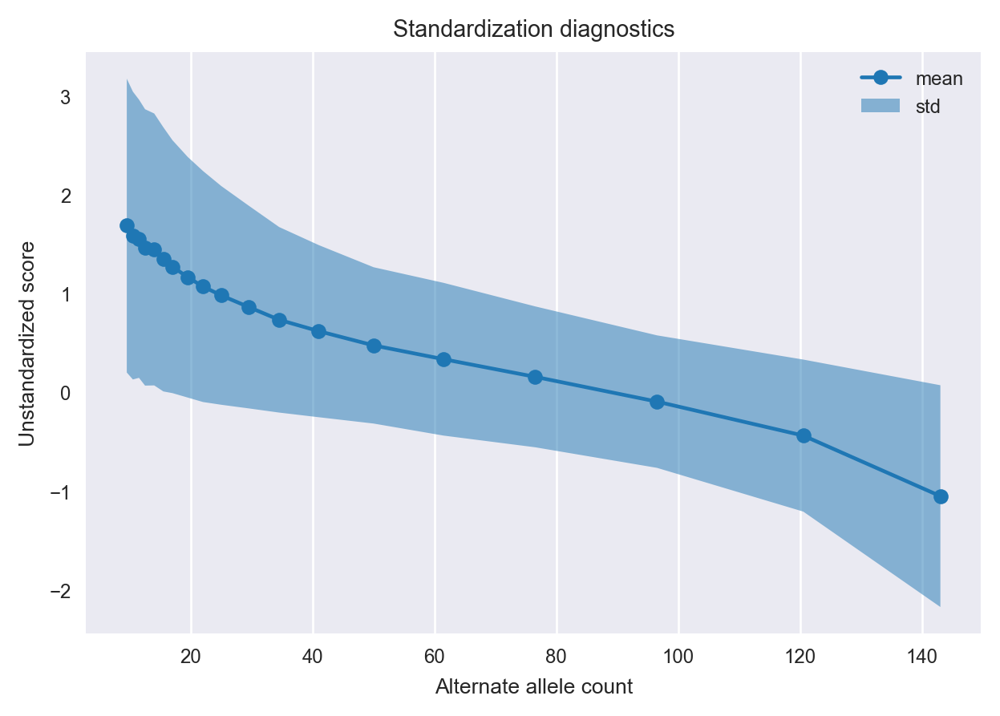

In [34]:
x = ac_nm[:, 1]
y = ihs_vals_nm
ihs_vals_std, _ = allel.standardize_by_allele_count(y, x, n_bins=20, diagnostics=True)


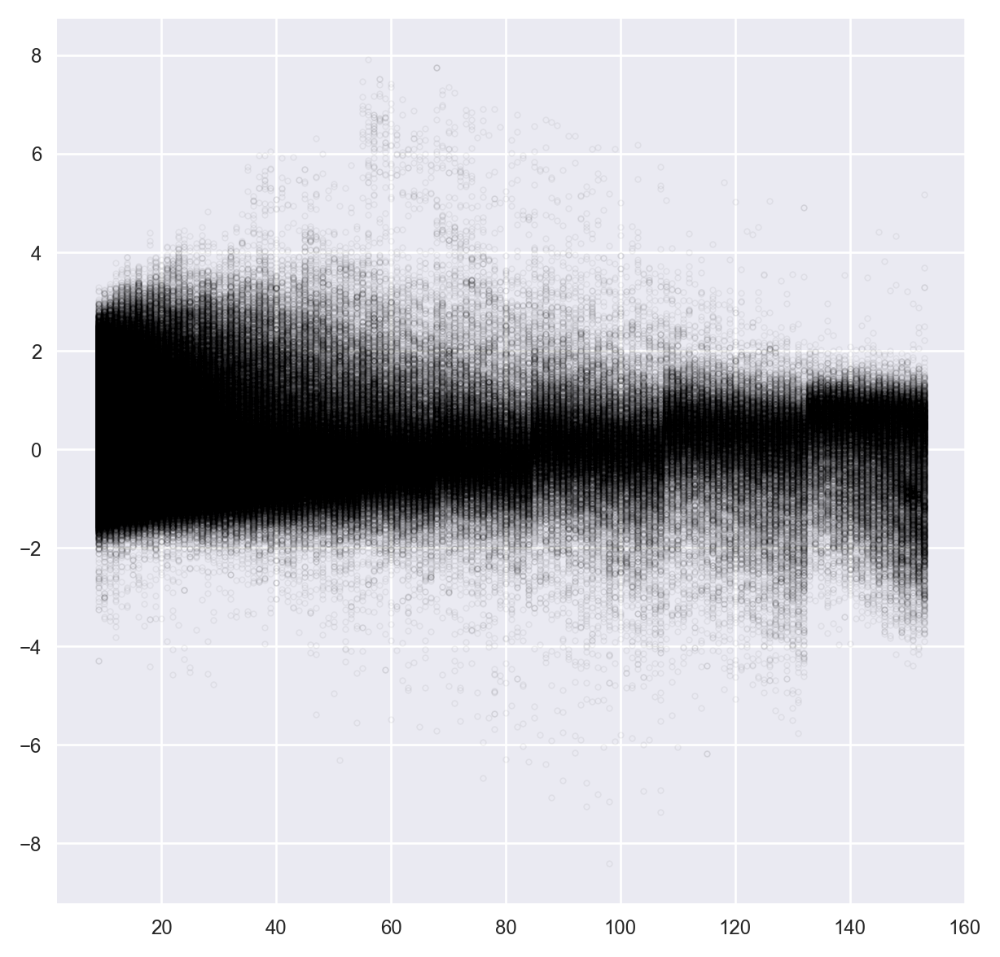

In [35]:
x = ac_nm[:, 1]
y = ihs_vals_std
fig, ax = plt.subplots(figsize=(6, 6))
ax.plot(x, y, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5, alpha=0.05);

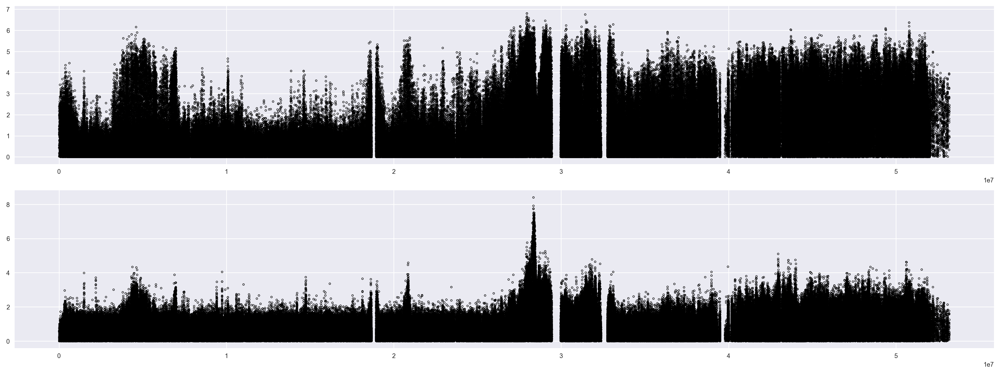

In [37]:
fig, axs = plt.subplots(nrows=2, figsize=(16, 6))
x = pos_nm
y1 = np.abs(ihs_vals_nm)
y2 = np.abs(ihs_vals_std)

axs[0].plot(x, y1, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5);
axs[1].plot(x, y2, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5);
fig.tight_layout()
#ax.set_xlim(8e6, 11e6);

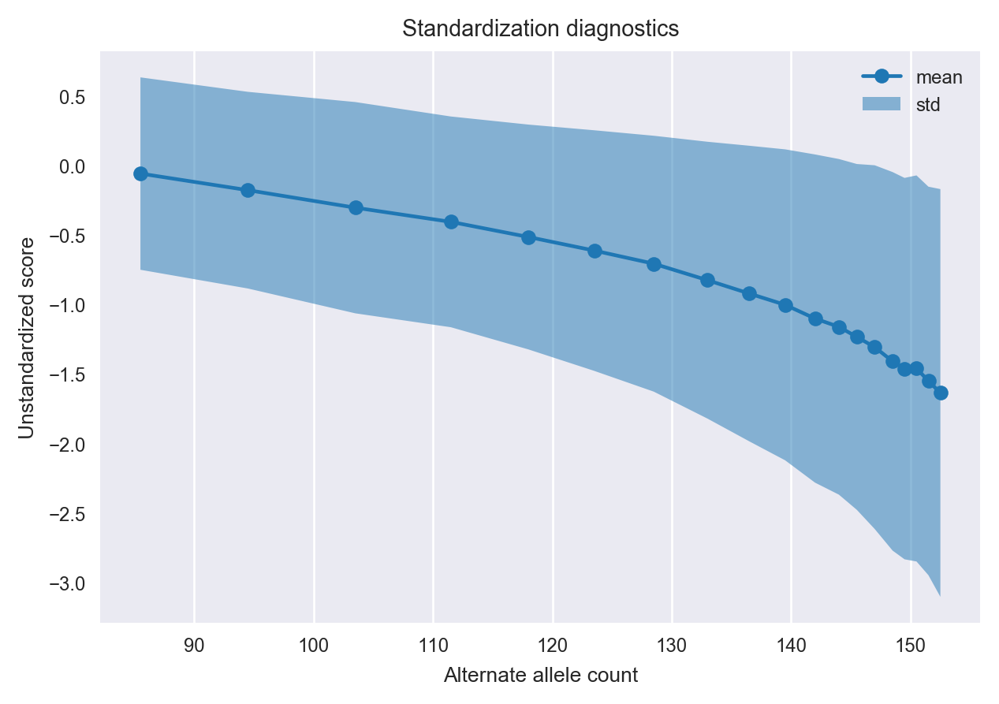

In [39]:
ac_maj = ac_nm.max(axis=1)
ihs_maj = ihs_vals_nm.copy()
ihs_maj[loc_flip] = -ihs_maj[loc_flip]
ihs_maj_std, _ = allel.standardize_by_allele_count(ihs_maj, ac_maj, n_bins=20, diagnostics=True)


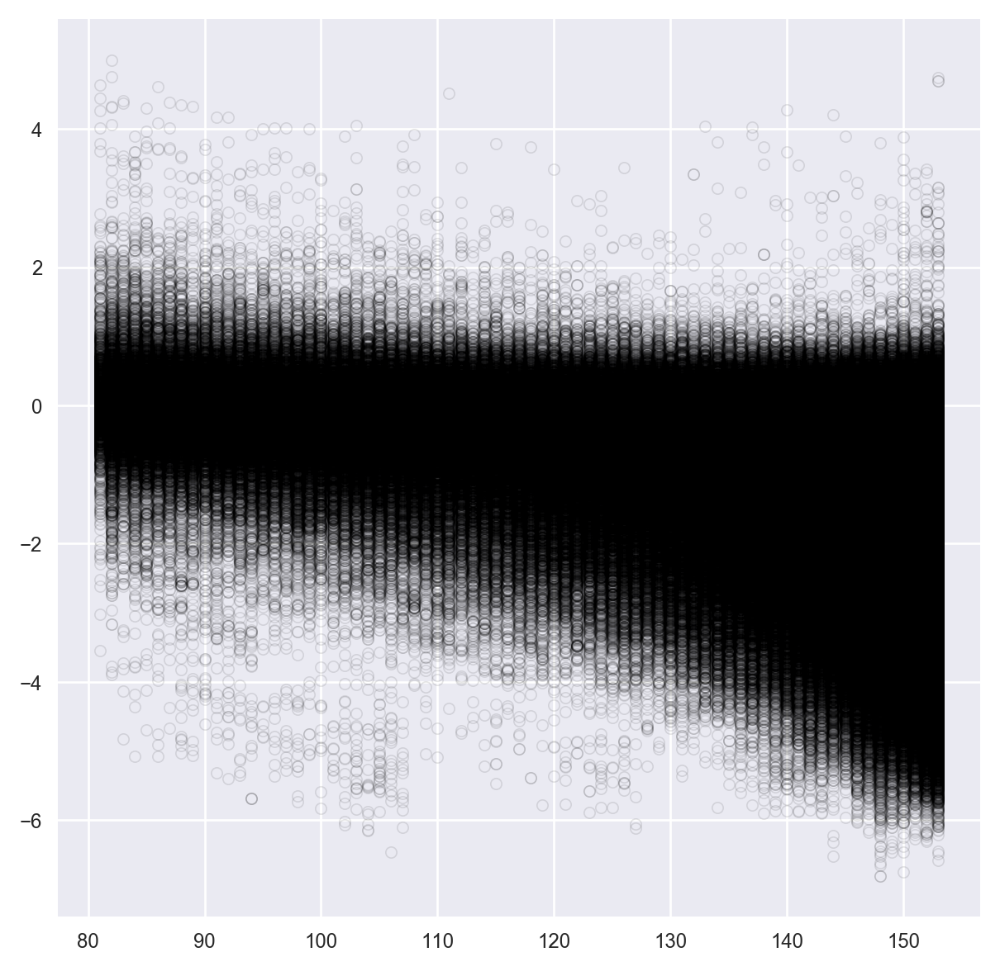

In [41]:
x = ac_maj
y = ihs_maj
fig, ax = plt.subplots(figsize=(6, 6))
ax.plot(x, y, marker='o', linestyle=' ', markersize=4, mfc='none', mec='k', mew=.5, alpha=.1);

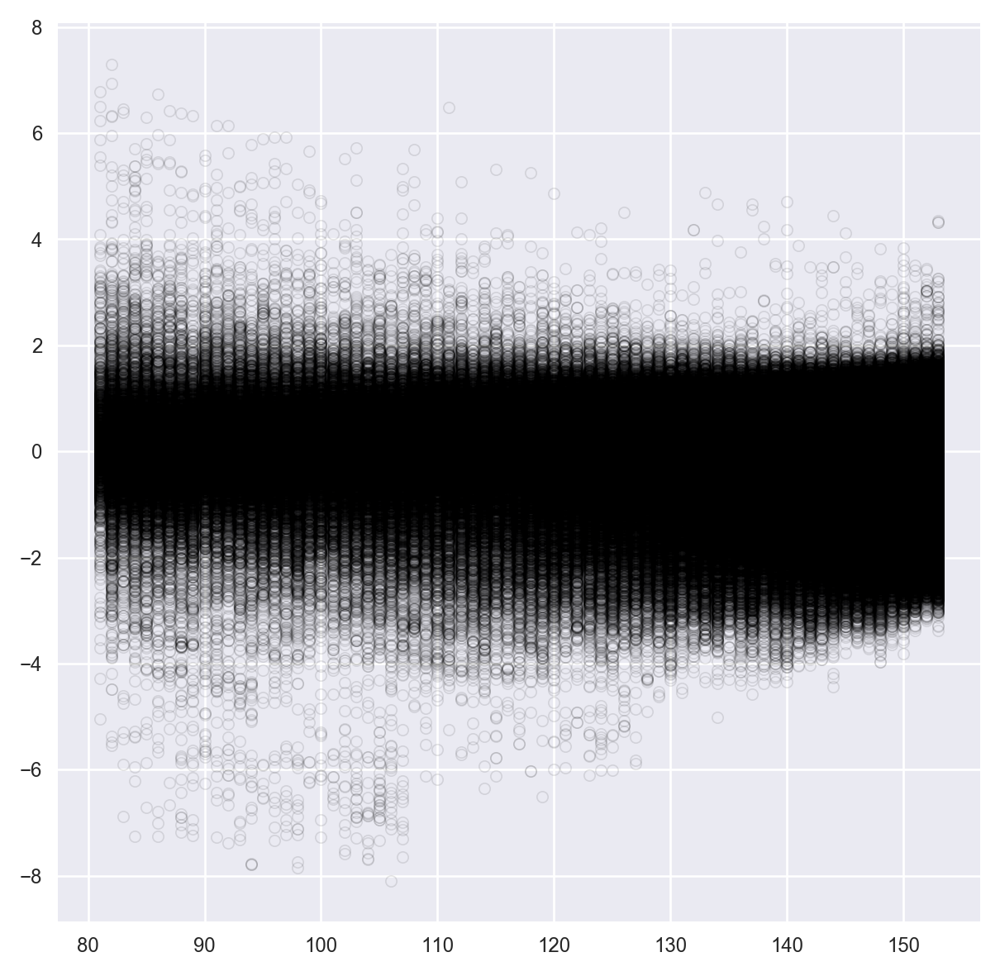

In [42]:
x = ac_maj
y = ihs_maj_std
fig, ax = plt.subplots(figsize=(6, 6))
ax.plot(x, y, marker='o', linestyle=' ', markersize=4, mfc='none', mec='k', mew=.5, alpha=.1);

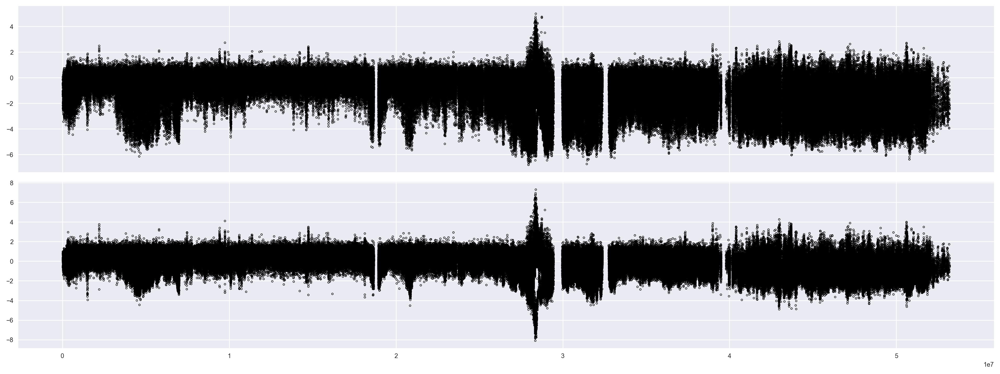

In [43]:
fig, axs = plt.subplots(nrows=2, figsize=(16, 6), sharex=True)
x = pos_nm
y1 = ihs_maj
y2 = ihs_maj_std

axs[0].plot(x, y1, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5);
axs[1].plot(x, y2, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5);
fig.tight_layout();
#axs[0].set_xlim(8e6, 11e6);

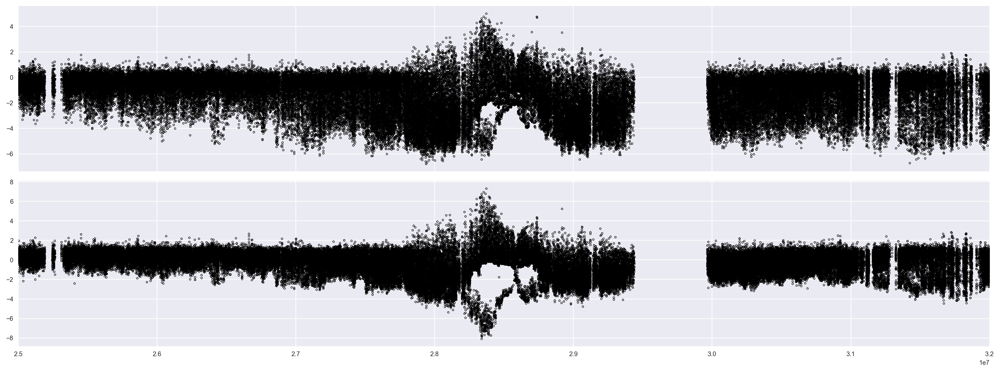

In [44]:
fig, axs = plt.subplots(nrows=2, figsize=(16, 6), sharex=True)
x = pos_nm
y1 = ihs_maj
y2 = ihs_maj_std

axs[0].plot(x, y1, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5);
axs[1].plot(x, y2, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5);
fig.tight_layout()
axs[0].set_xlim(25e6, 32e6);

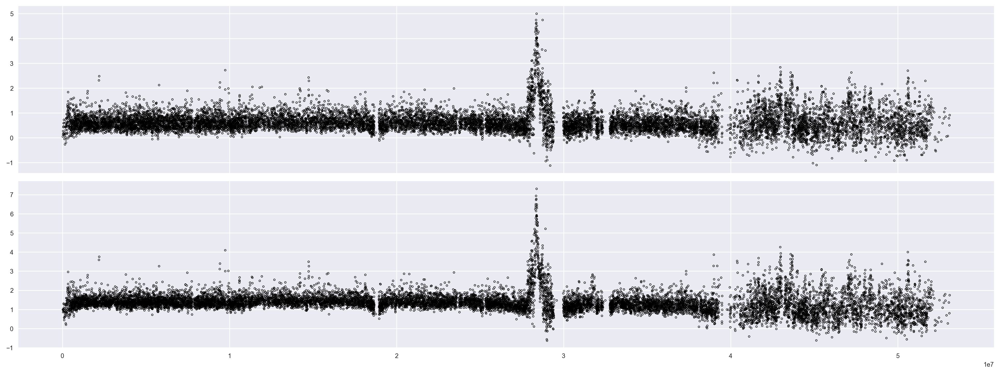

In [45]:
fig, axs = plt.subplots(nrows=2, figsize=(16, 6), sharex=True)
x = pos_nm
y1 = ihs_maj
y2 = ihs_maj_std
xw = allel.moving_statistic(x, statistic=np.mean, size=50)
y1w = allel.moving_statistic(y1, statistic=np.max, size=50)
y2w = allel.moving_statistic(y2, statistic=np.max, size=50)


axs[0].plot(xw, y1w, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5);
axs[1].plot(xw, y2w, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5);
fig.tight_layout();
#axs[0].set_xlim(8e6, 11e6);

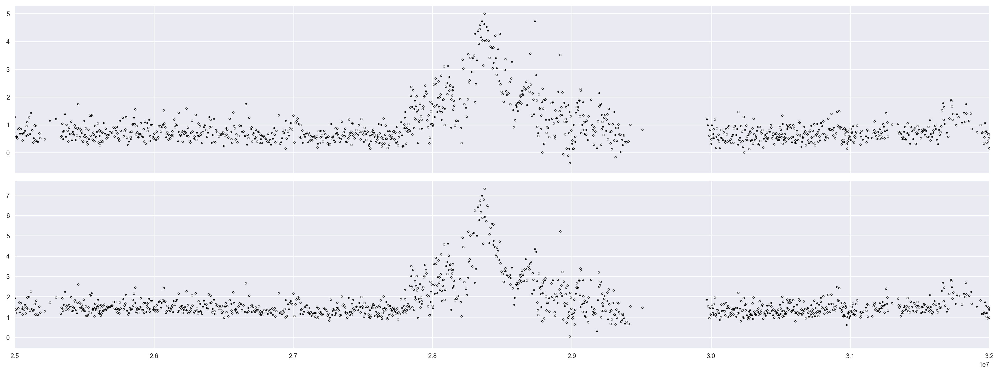

In [47]:
fig, axs = plt.subplots(nrows=2, figsize=(16, 6), sharex=True)
x = pos_nm
y1 = ihs_maj
y2 = ihs_maj_std
xw = allel.moving_statistic(x, statistic=np.mean, size=100)
y1w = allel.moving_statistic(y1, statistic=np.max, size=100)
y2w = allel.moving_statistic(y2, statistic=np.max, size=100)


axs[0].plot(xw, y1w, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5);
axs[1].plot(xw, y2w, marker='o', linestyle=' ', markersize=2, mfc='none', mec='k', mew=.5);
axs[0].set_xlim(25e6, 32e6)
fig.tight_layout();


## Legacy

In [3]:
populations = list(ihs_raw['X'])
populations

['AOM', 'BFM', 'BFS', 'CMS', 'CMS_savanna', 'GAS', 'GNS', 'GWA', 'KES', 'UGS']

In [4]:
list(ihs_raw['X/AOM'])

['AC', 'AF', 'CHROM', 'POS', 'iHS', 'iHS_chrom_std', 'iHS_gw_std']

In [5]:
seqids

('2R', '2L', '3R', '3L', 'X')

In [5]:
seqids

('2R', '2L', '3R', '3L', 'X')

In [9]:
def build_dataframe(pop, seqid=None, window_size=100):
    
    if seqid is None:
        df = pd.concat([build_dataframe(pop, seqid=seqid, window_size=window_size) for seqid in seqids])
        return df

    # extract whole genome raw values for percentile calculation
    ihs_raw_pop = np.concatenate([
        ihs_raw[seqid][pop]['iHS_gw_std'][:] for seqid in seqids
    ])

    # extract raw values for windowing
    grp = ihs_raw[seqid][pop]
    pos = grp['POS'][:]
    values = np.abs(grp['iHS_gw_std'][:])
    nomiss = ~np.isnan(values)
    pos_nomiss = pos[nomiss]
    values_nomiss = values[nomiss]
    
    # construct moving windows
    starts_col = allel.moving_statistic(pos_nomiss, statistic=lambda v: v[0], size=window_size)
    starts_col[0] = 1  # fix to start of sequence
    ends_col = np.append(starts_col[1:] - 1, [len(genome[seqid])])
    
    # summarise values in windows
    values_col = allel.moving_statistic(values_nomiss, statistic=np.max, size=window_size)
    
    # compute percentiles
    percentiles_col = [scipy.stats.percentileofscore(ihs_raw_pop, v) for v in values_col]
    
    # seqid column
    seqid_col = np.array([seqid] * len(starts_col))
    
    # build dataframe
    df = pd.DataFrame.from_items([
        ('seqid', seqid_col), 
        ('start', starts_col), 
        ('end', ends_col), 
        ('value', values_col)
        ('percentile', percentiles_col)
    ])
    return df


## Check peak fitters

In [10]:
df = build_dataframe('BFS', window_size=200)
df.head()

KeyboardInterrupt: 

In [8]:
df.tail()

,seqid,start,end,value
864,X,19522585,19566481,2.193167
865,X,19566482,19668847,2.030943
866,X,19668848,19838301,1.609615
867,X,19838302,21006690,1.706787
868,X,21006691,24393108,2.490370


In [9]:
starts, ends, values, percentiles = peakfit.extract_windowed_values(df, seqid=('2R', '2L'), genome=genome)

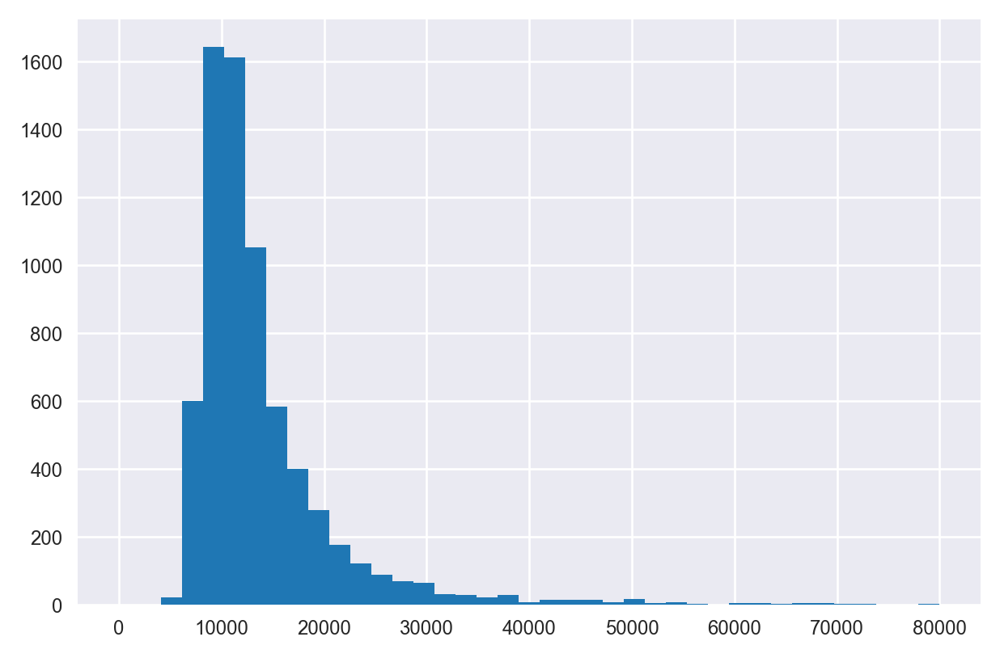

In [10]:
plt.hist(ends-starts, bins=np.linspace(0, 80000, 40));

In [11]:
amplitude = lmfit.Parameter(value=3, vary=True, min=0)
decay = lmfit.Parameter(value=1, vary=True, min=0.05, max=4)
sigma = lmfit.Parameter(value=1, vary=True, min=0.05, max=4)
skew = lmfit.Parameter(value=0, vary=True, min=-2, max=2)
baseline = lmfit.Parameter(value=1, vary=True, min=0, max=5)
no_ceiling = lmfit.Parameter(value=500, vary=False)
variable_ceiling = lmfit.Parameter(value=5, vary=True, min=0)
floor = lmfit.Parameter(value=0, vary=False)
null = lmfit.Parameter(value=1, vary=True, min=0)
peak_limit_frc = .2

exp_fitter = peakfit.ExponentialPeakFitter(
    amplitude=amplitude,
    decay=decay,
    baseline=baseline,
    ceiling=variable_ceiling,
    floor=floor,
    null=null,
    peak_limit_frc=peak_limit_frc,
)


skewed_exp_fitter = peakfit.SkewedExponentialPeakFitter(
    amplitude=amplitude,
    decay=decay,
    skew=skew,
    baseline=baseline,
    ceiling=variable_ceiling,
    floor=floor,
    null=null,
    peak_limit_frc=peak_limit_frc,
)


gauss_fitter = peakfit.GaussianPeakFitter(
    amplitude=amplitude,
    sigma=sigma,
    baseline=baseline,
    ceiling=no_ceiling,
    floor=floor,
    null=null,
    peak_limit_frc=peak_limit_frc,
)


skewed_gauss_fitter = peakfit.SkewedGaussianPeakFitter(
    amplitude=amplitude,
    sigma=sigma,
    skew=skew,
    baseline=baseline,
    ceiling=no_ceiling,
    floor=floor,
    null=null,
    peak_limit_frc=peak_limit_frc,
)


def inspect_peak_fits(center, flank):

    x = ((starts + ends) / 2).astype(int)
    x = gmap['2'].take(x - 1)
    y = values

    fit = exp_fitter.fit(x, y, center, flank)
    fig = peakfit.plot_peak_fit(fit, ylabel='IHS')
    fig.suptitle('Exponential', fontsize=12, fontweight='bold', y=1.03)
    plt.show()
    print(fit.peak_result.fit_report())

    fit = skewed_exp_fitter.fit(x, y, center, flank)
    fig = peakfit.plot_peak_fit(fit, ylabel='IHS')
    fig.suptitle('Skewed Exponential', fontsize=12, fontweight='bold', y=1.03)
    plt.show()
    print(fit.peak_result.fit_report())
    
    fit = gauss_fitter.fit(x, y, center, flank)
    fig = peakfit.plot_peak_fit(fit, ylabel='IHS')
    fig.suptitle('Gaussian', fontsize=12, fontweight='bold', y=1.03)
    plt.show()
    print(fit.peak_result.fit_report())

    fit = skewed_gauss_fitter.fit(x, y, center, flank)
    fig = peakfit.plot_peak_fit(fit, ylabel='IHS')
    fig.suptitle('Skewed Gaussian', fontsize=12, fontweight='bold', y=1.03)
    plt.show()
    print(fit.peak_result.fit_report())

    

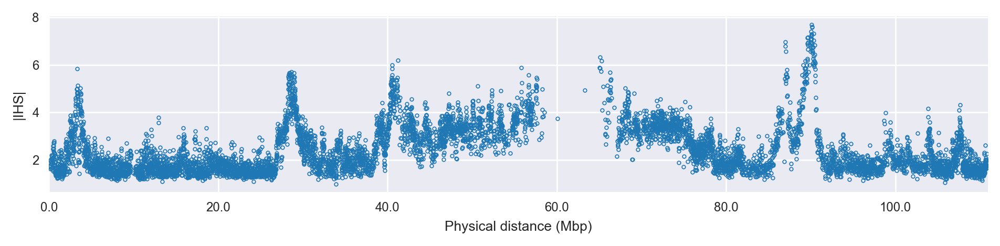

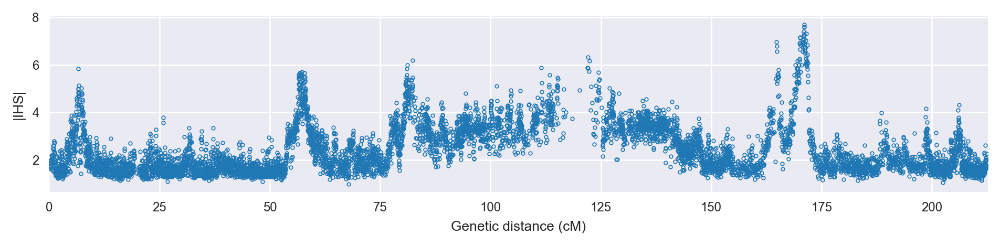

In [12]:
peakfit.plot_windowed_values(starts, ends, values, ylabel='|IHS|');
peakfit.plot_windowed_values(starts, ends, values, ylabel='|IHS|', gmap=gmap['2']);

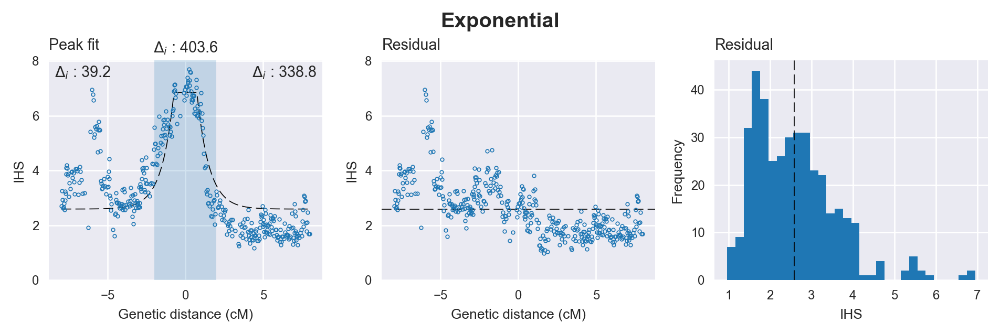

[[Model]]
    Model(exponential_peak)
[[Fit Statistics]]
    # function evals   = 51
    # data points      = 391
    # variables        = 4
    chi-square         = 395.619
    reduced chi-square = 1.022
    Akaike info crit   = 12.592
    Bayesian info crit = 28.467
[[Variables]]
    center:      0 (fixed)
    amplitude:   10.8797225 +/- 1.842878 (16.94%) (init= 3)
    decay:       0.78558137 +/- 0.098199 (12.50%) (init= 1)
    baseline:    2.59042990 +/- 0.070827 (2.73%) (init= 1)
    ceiling:     6.85320977 +/- 0.170902 (2.49%) (init= 5)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, decay)          = -0.937 
    C(decay, baseline)           = -0.522 
    C(amplitude, baseline)       =  0.352 



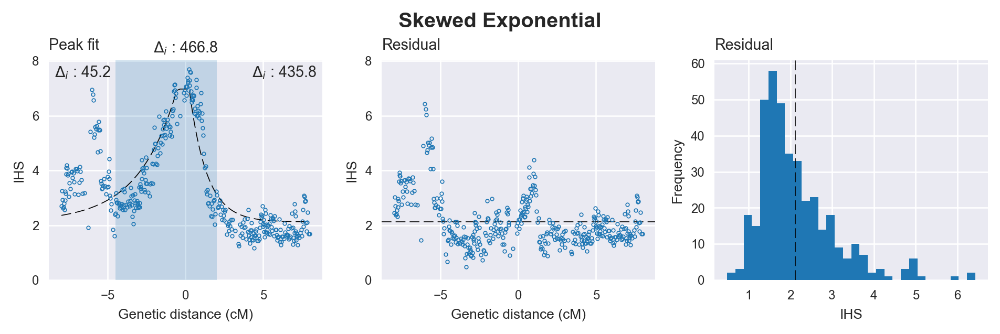

[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 166
    # data points      = 391
    # variables        = 5
    chi-square         = 334.885
    reduced chi-square = 0.868
    Akaike info crit   = -50.574
    Bayesian info crit = -30.731
[[Variables]]
    center:      0 (fixed)
    amplitude:   6.00929155 +/- 0.292013 (4.86%) (init= 3)
    decay:       1.12597558 +/- 0.114250 (10.15%) (init= 1)
    skew:        1.13661992 +/- 0.104338 (9.18%) (init= 0)
    baseline:    2.12069767 +/- 0.090295 (4.26%) (init= 1)
    ceiling:     6.97358030 +/- 0.268883 (3.86%) (init= 5)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(decay, baseline)           = -0.639 
    C(decay, skew)               = -0.575 
    C(amplitude, decay)          = -0.569 
    C(skew, baseline)            =  0.124 
    C(amplitude, baseline)       =  0.111 



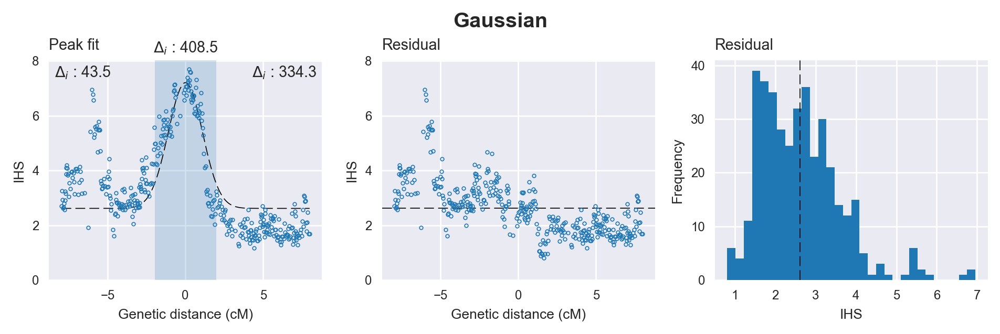

[[Model]]
    Model(gaussian)
[[Fit Statistics]]
    # function evals   = 19
    # data points      = 391
    # variables        = 3
    chi-square         = 392.678
    reduced chi-square = 1.012
    Akaike info crit   = 7.675
    Bayesian info crit = 19.581
[[Variables]]
    center:      0 (fixed)
    amplitude:   4.59170659 +/- 0.187116 (4.08%) (init= 3)
    sigma:       1.09986749 +/- 0.054976 (5.00%) (init= 1)
    baseline:    2.61470909 +/- 0.063685 (2.44%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, sigma)          = -0.438 
    C(sigma, baseline)           = -0.396 
    C(amplitude, baseline)       = -0.234 



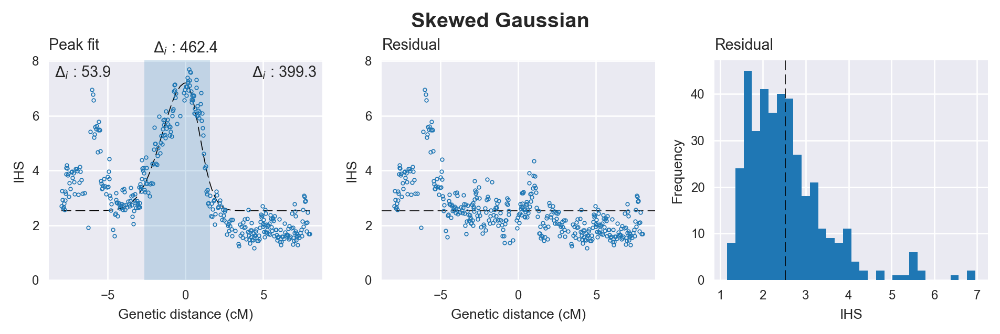

[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 53
    # data points      = 391
    # variables        = 4
    chi-square         = 340.431
    reduced chi-square = 0.880
    Akaike info crit   = -46.152
    Bayesian info crit = -30.277
[[Variables]]
    center:      0 (fixed)
    amplitude:   4.66482752 +/- 0.170147 (3.65%) (init= 3)
    sigma:       0.89938819 +/- 0.055394 (6.16%) (init= 1)
    skew:        0.71968139 +/- 0.095105 (13.21%) (init= 0)
    baseline:    2.52861217 +/- 0.061550 (2.43%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, skew)               = -0.702 
    C(amplitude, sigma)          = -0.341 
    C(sigma, baseline)           = -0.301 
    C(amplitude, baseline)       = -0.244 



In [13]:
inspect_peak_fits(center=170.8, flank=8)

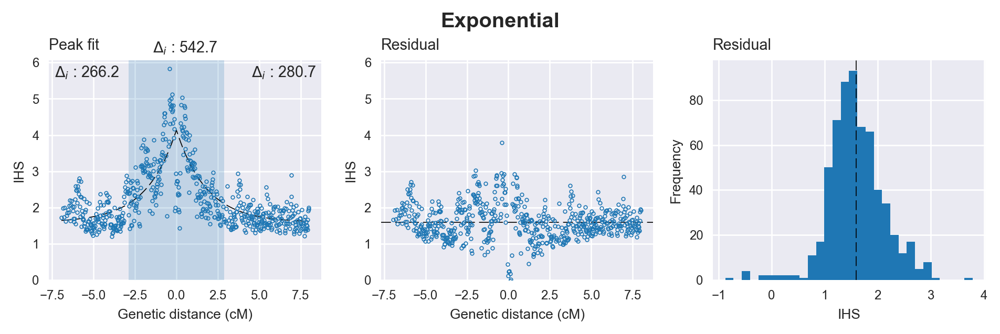

[[Model]]
    Model(exponential_peak)
[[Fit Statistics]]
    # function evals   = 33
    # data points      = 618
    # variables        = 4
    chi-square         = 174.978
    reduced chi-square = 0.285
    Akaike info crit   = -771.809
    Bayesian info crit = -754.103
[[Variables]]
    center:      0 (fixed)
    amplitude:   2.55039806 +/- 0        (0.00%) (init= 3)
    decay:       1.81193243 +/- 0        (0.00%) (init= 1)
    baseline:    1.58728097 +/- 0        (0.00%) (init= 1)
    ceiling:     5          +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)



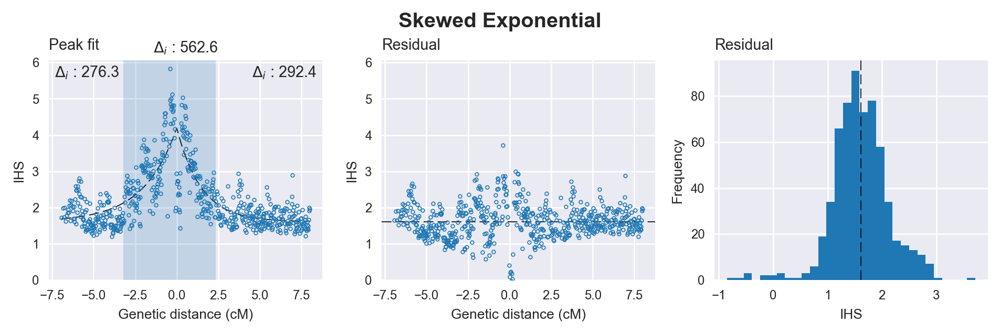

[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 51
    # data points      = 618
    # variables        = 5
    chi-square         = 168.895
    reduced chi-square = 0.276
    Akaike info crit   = -791.677
    Bayesian info crit = -769.544
[[Variables]]
    center:      0 (fixed)
    amplitude:   2.58666701 +/- 0        (0.00%) (init= 3)
    decay:       1.46237008 +/- 0        (0.00%) (init= 1)
    skew:        0.45239995 +/- 0        (0.00%) (init= 0)
    baseline:    1.60682935 +/- 0        (0.00%) (init= 1)
    ceiling:     5          +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)



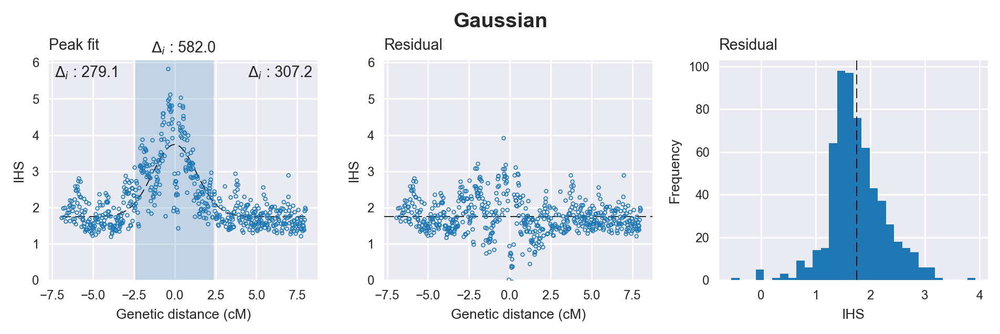

[[Model]]
    Model(gaussian)
[[Fit Statistics]]
    # function evals   = 27
    # data points      = 618
    # variables        = 3
    chi-square         = 164.739
    reduced chi-square = 0.268
    Akaike info crit   = -811.074
    Bayesian info crit = -797.794
[[Variables]]
    center:      0 (fixed)
    amplitude:   1.99186317 +/- 0.066508 (3.34%) (init= 3)
    sigma:       1.33714898 +/- 0.056193 (4.20%) (init= 1)
    baseline:    1.74745019 +/- 0.029044 (1.66%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, baseline)           = -0.480 
    C(amplitude, sigma)          = -0.344 
    C(amplitude, baseline)       = -0.310 



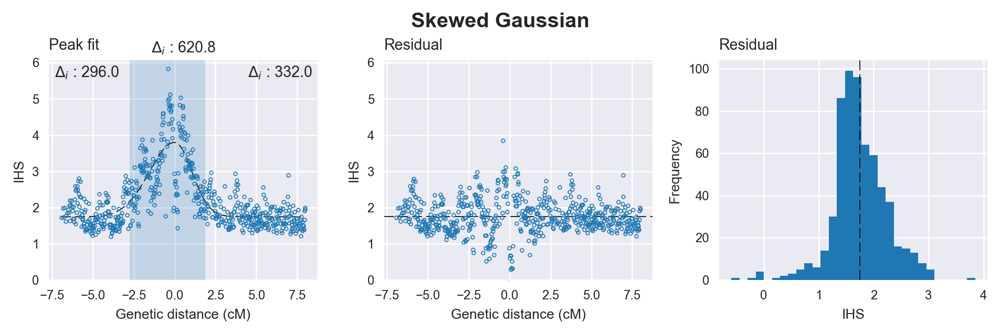

[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 28
    # data points      = 618
    # variables        = 4
    chi-square         = 154.210
    reduced chi-square = 0.251
    Akaike info crit   = -849.892
    Bayesian info crit = -832.186
[[Variables]]
    center:      0 (fixed)
    amplitude:   2.05316723 +/- 0.065294 (3.18%) (init= 3)
    sigma:       1.05813460 +/- 0.054893 (5.19%) (init= 1)
    skew:        0.54038467 +/- 0.082047 (15.18%) (init= 0)
    baseline:    1.74449301 +/- 0.027963 (1.60%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, skew)               = -0.650 
    C(sigma, baseline)           = -0.354 
    C(amplitude, baseline)       = -0.304 
    C(amplitude, sigma)          = -0.275 



In [14]:
inspect_peak_fits(center=7, flank=8)

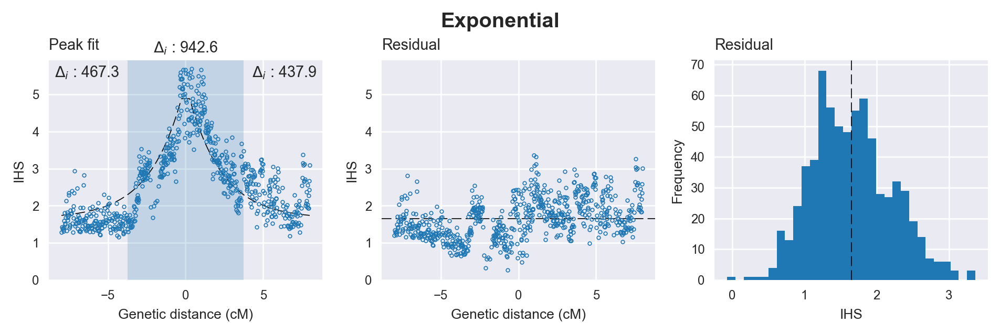

[[Model]]
    Model(exponential_peak)
[[Fit Statistics]]
    # function evals   = 43
    # data points      = 693
    # variables        = 4
    chi-square         = 207.235
    reduced chi-square = 0.301
    Akaike info crit   = -828.572
    Bayesian info crit = -810.408
[[Variables]]
    center:      0 (fixed)
    amplitude:   3.66213975 +/- 0.099040 (2.70%) (init= 3)
    decay:       2.15517258 +/- 0.151565 (7.03%) (init= 1)
    baseline:    1.65125018 +/- 0.062682 (3.80%) (init= 1)
    ceiling:     4.88604233 +/- 0.109686 (2.24%) (init= 5)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(decay, baseline)           = -0.863 
    C(amplitude, decay)          = -0.399 



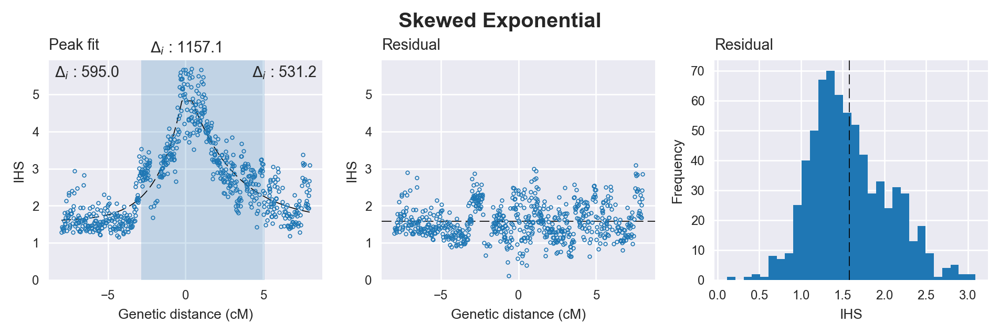

[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 78
    # data points      = 693
    # variables        = 5
    chi-square         = 151.651
    reduced chi-square = 0.220
    Akaike info crit   = -1042.978
    Bayesian info crit = -1020.273
[[Variables]]
    center:      0 (fixed)
    amplitude:   3.75043126 +/- 0.086227 (2.30%) (init= 3)
    decay:       2.93245633 +/- 0.159279 (5.43%) (init= 1)
    skew:       -0.84404217 +/- 0.055598 (6.59%) (init= 0)
    baseline:    1.58270197 +/- 0.049122 (3.10%) (init= 1)
    ceiling:     4.82676931 +/- 0.084323 (1.75%) (init= 5)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(decay, baseline)           = -0.777 
    C(amplitude, decay)          = -0.447 
    C(skew, baseline)            = -0.181 
    C(decay, skew)               = -0.140 



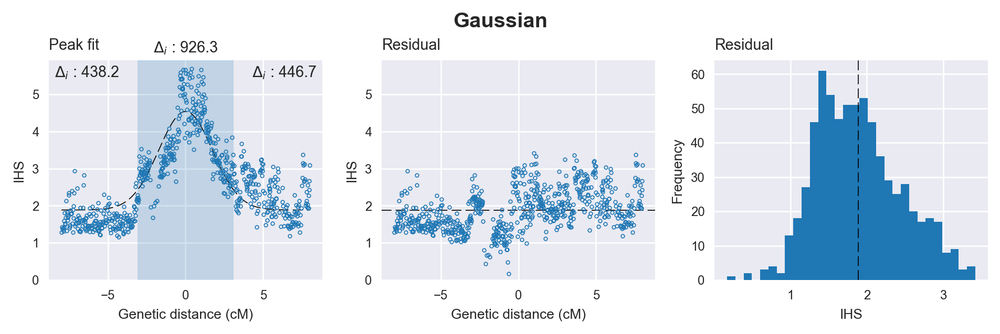

[[Model]]
    Model(gaussian)
[[Fit Statistics]]
    # function evals   = 27
    # data points      = 693
    # variables        = 3
    chi-square         = 212.793
    reduced chi-square = 0.308
    Akaike info crit   = -812.233
    Bayesian info crit = -798.610
[[Variables]]
    center:      0 (fixed)
    amplitude:   2.65468166 +/- 0.060810 (2.29%) (init= 3)
    sigma:       1.73301591 +/- 0.052649 (3.04%) (init= 1)
    baseline:    1.88618785 +/- 0.033810 (1.79%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, baseline)           = -0.577 
    C(amplitude, baseline)       = -0.407 
    C(amplitude, sigma)          = -0.191 



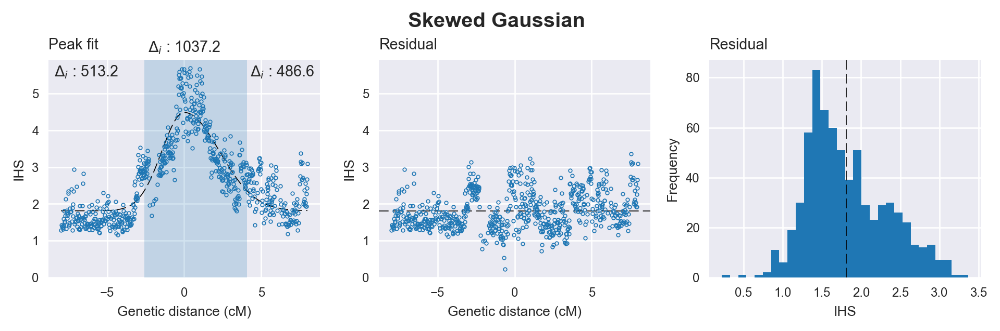

[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 68
    # data points      = 693
    # variables        = 4
    chi-square         = 180.816
    reduced chi-square = 0.262
    Akaike info crit   = -923.079
    Bayesian info crit = -904.915
[[Variables]]
    center:      0 (fixed)
    amplitude:   2.67461308 +/- 0.054729 (2.05%) (init= 3)
    sigma:       2.28317034 +/- 0.070766 (3.10%) (init= 1)
    skew:       -0.65235831 +/- 0.055225 (8.47%) (init= 0)
    baseline:    1.81286851 +/- 0.032789 (1.81%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, baseline)           = -0.527 
    C(amplitude, baseline)       = -0.437 
    C(sigma, skew)               = -0.423 
    C(amplitude, sigma)          = -0.148 



In [15]:
inspect_peak_fits(center=56.9, flank=8)

## Find peaks

In [16]:
df.head()

,seqid,start,end,value
0,2R,1,60156,1.725094
1,2R,60157,94962,1.982869
2,2R,94963,117545,1.736274
3,2R,117546,147228,1.997199
4,2R,147229,169082,1.616558


In [17]:
df.loc[df.seqid == 'X'].head()

,seqid,start,end,value
0,X,1,89053,2.467537
1,X,89054,138867,2.787443
2,X,138868,169644,2.271138
3,X,169645,193800,2.811027
4,X,193801,222297,2.301407


In [18]:
starts, ends, values, percentiles = peakfit.extract_windowed_values(df, seqid='X', genome=genome)

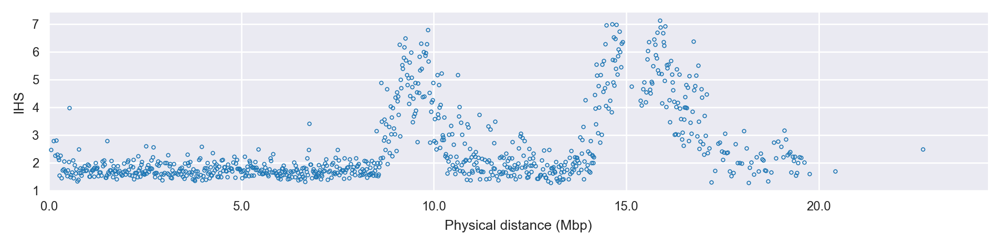

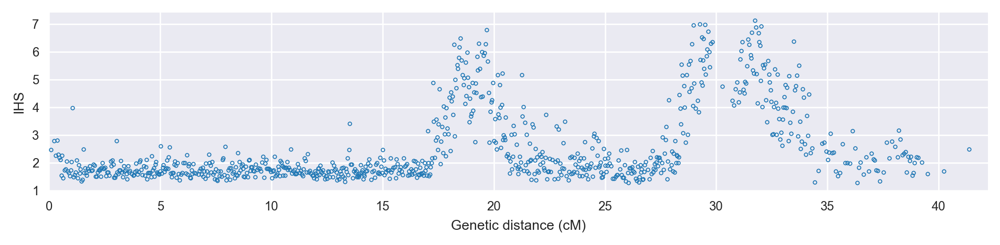

In [19]:
peakfit.plot_windowed_values(starts, ends, values, ylabel='IHS');
peakfit.plot_windowed_values(starts, ends, values, ylabel='IHS', gmap=gmap['X']);

In [20]:
centers = np.arange(1, ends[-1], 20000)

scan progress 0 2e-06
scan progress 100 4.00000199985
scan progress 200 8.00000200041
scan progress 300 12.000002001
scan progress 400 16.0000020015
scan progress 500 20.0000019985
scan progress 600 24.0000019955
scan progress 700 28.0000019925
scan progress 800 32.0000019896
scan progress 900 36.0000019937
scan progress 1000 40.0000019978
scan progress 1100 41.0146449953
scan progress 1200 42.0146449928
first peak: 468 515.176
Iteration 1
Peak center (index, location): 468, 9360001.0
Delta AIC: 515.2
Flank delta AICs: 323.9, 229.6
find limits of peak
peak limits: 8656281 10603551 433 532
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 23
    # data points      = 404
    # variables        = 4
    chi-square         = 155.096
    reduced chi-square = 0.388
    Akaike info crit   = -378.778
    Bayesian info crit = -362.772
[[Variables]]
    center:      0 (fixed)
    amplitude:   3.33818625 +/- 0.109646 (3.28%)

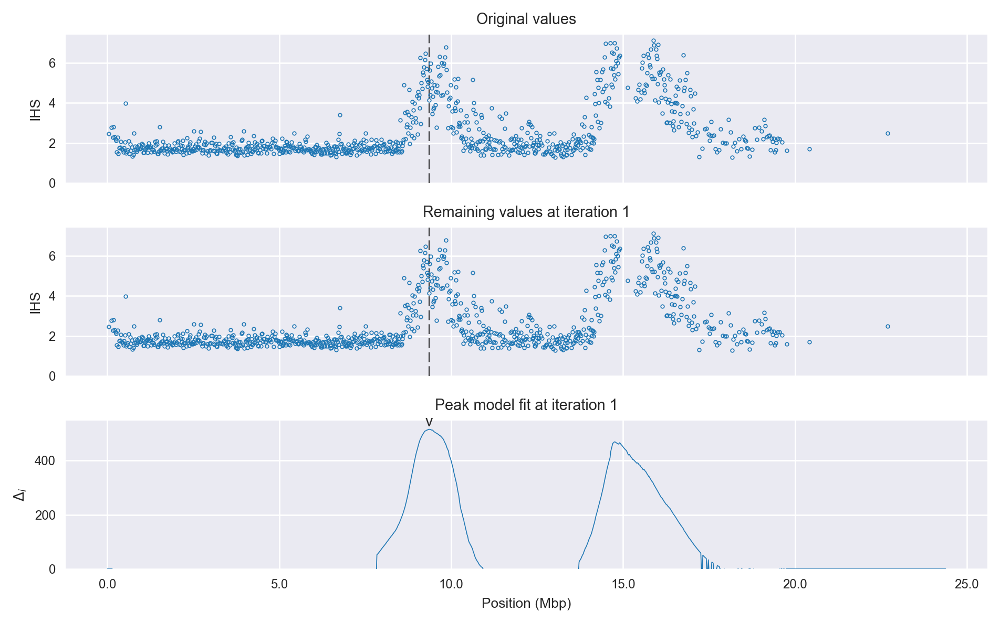

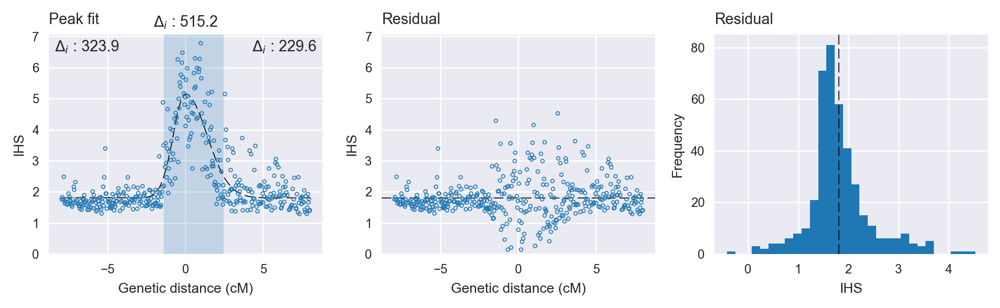

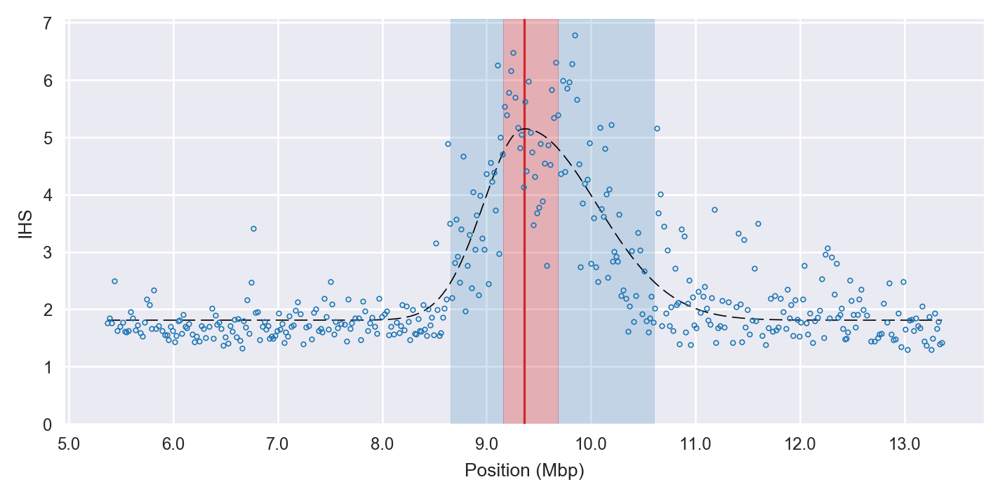

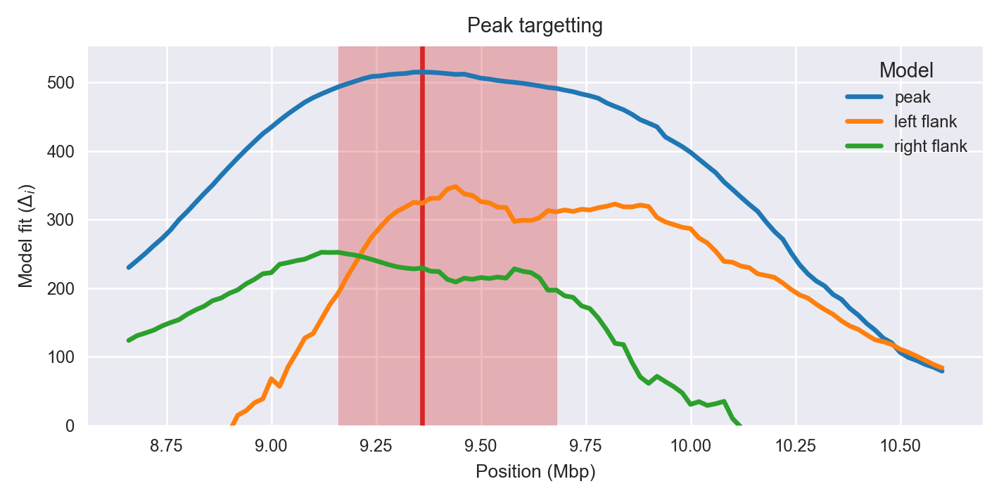

find the next peak
next peak: 738 477.562
Iteration 2
Peak center (index, location): 738, 14760001.0
Delta AIC: 477.6
Flank delta AICs: 275.9, 142.7
find limits of peak
peak limits: 14049136 17551700 703 879
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 38
    # data points      = 323
    # variables        = 4
    chi-square         = 180.883
    reduced chi-square = 0.567
    Akaike info crit   = -179.276
    Bayesian info crit = -164.165
[[Variables]]
    center:      0 (fixed)
    amplitude:   4.14605210 +/- 0.134289 (3.24%) (init= 3)
    sigma:       3.11110058 +/- 0.131825 (4.24%) (init= 1)
    skew:       -1.96496517 +/- 0.082613 (4.20%) (init= 0)
    baseline:    1.85640558 +/- 0.061359 (3.31%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, skew)               = -0.412 
    C(amplitude, sigma)          = -0.394 
  

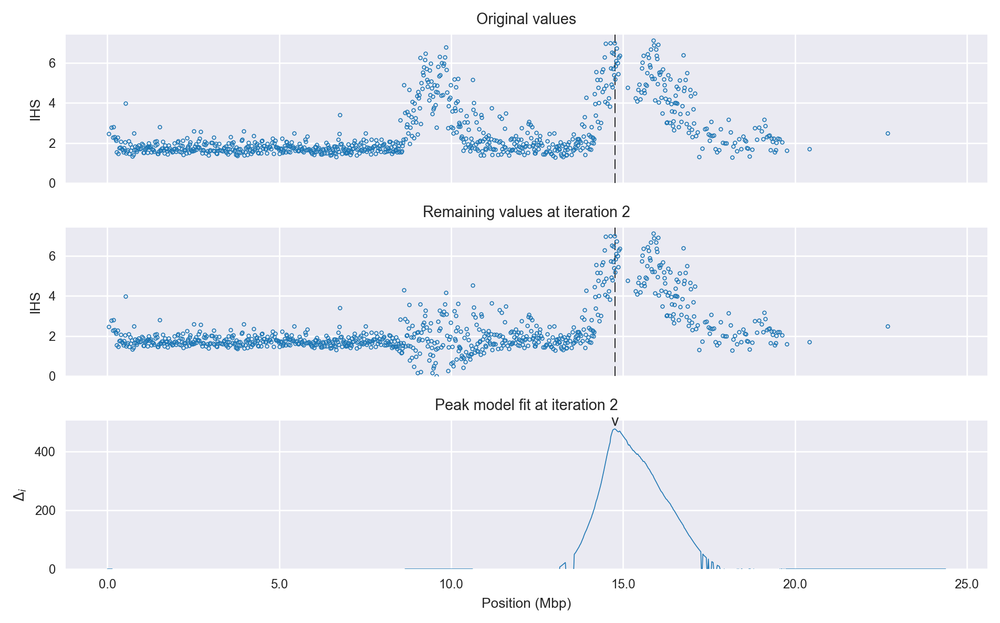

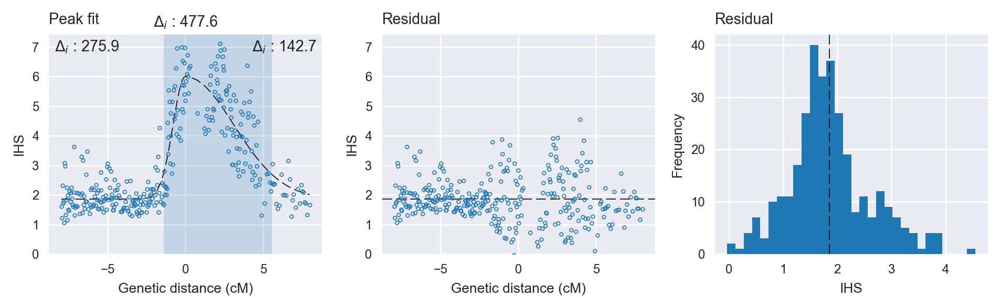

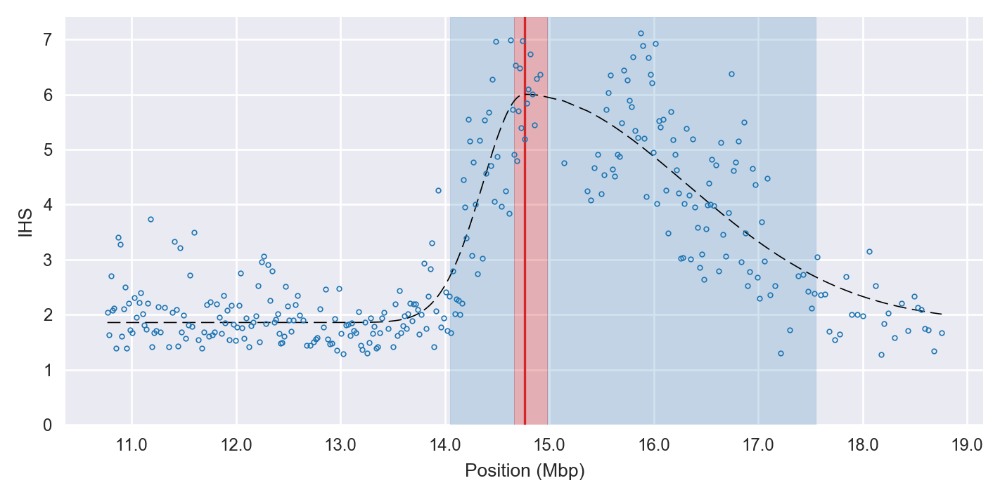

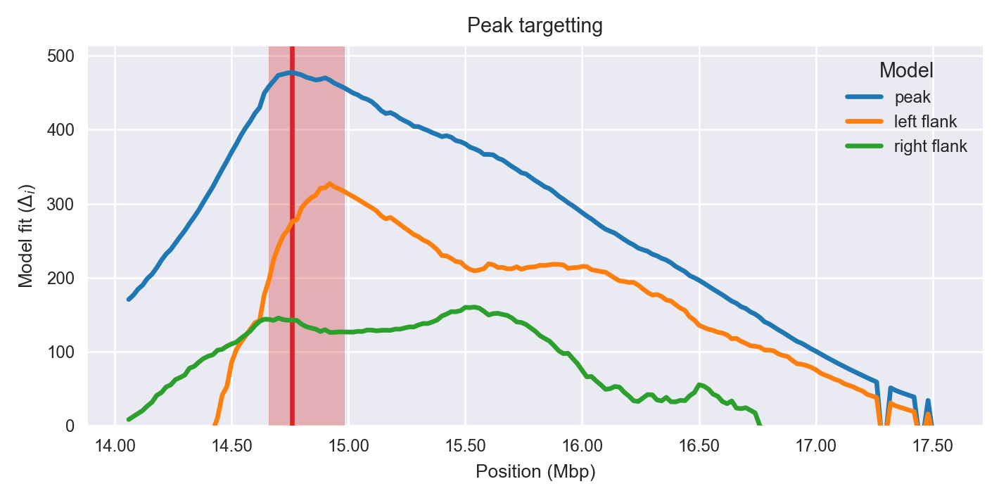

find the next peak
next peak: 0 0.0
all done


In [21]:
peaks = peakfit.find_peaks(starts=starts, ends=ends, values=values, percentiles=percentiles, centers=centers, 
                           gflank=8, gmap=gmap['X'], fitters=[skewed_gauss_fitter], show_plots=True, statistic_label='IHS', 
                           log_file=None)
peaks = list(peaks)

scan progress 0 2e-06
scan progress 100 4.00000199985
scan progress 200 8.00000200041
scan progress 300 12.000002001
scan progress 400 16.0000020015
scan progress 500 20.0000019985
scan progress 600 24.0000019955
scan progress 700 28.0000019925
scan progress 800 32.0000019896
scan progress 900 36.0000019937
scan progress 1000 40.0000019978
scan progress 1100 41.0146449953
scan progress 1200 42.0146449928
first peak: 473 538.453
Iteration 1
Peak center (index, location): 473, 9460001.0
Delta AIC: 538.5
Flank delta AICs: 349.4, 230.1
find limits of peak
peak limits: 8619527 10570041 431 530
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 78
    # data points      = 404
    # variables        = 5
    chi-square         = 145.730
    reduced chi-square = 0.365
    Akaike info crit   = -401.942
    Bayesian info crit = -381.935
[[Variables]]
    center:      0 (fixed)
    amplitude:   7.49100265 +/- 0.883655

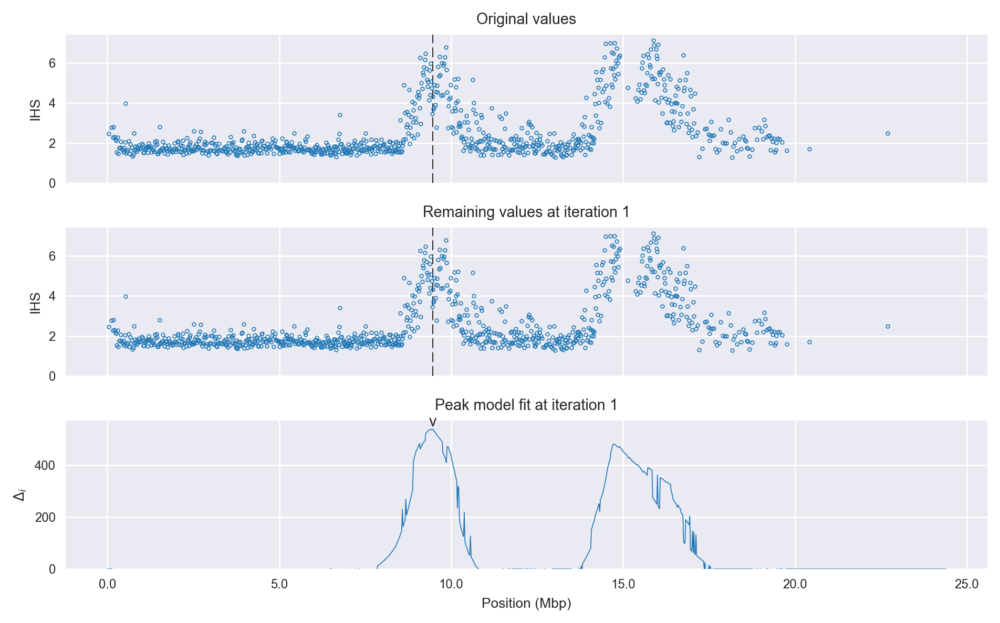

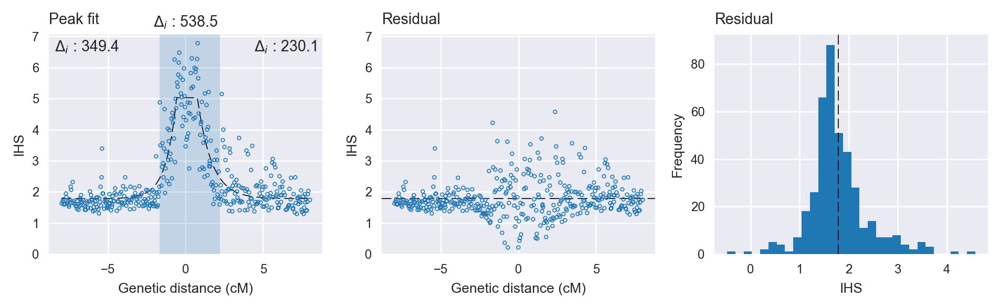

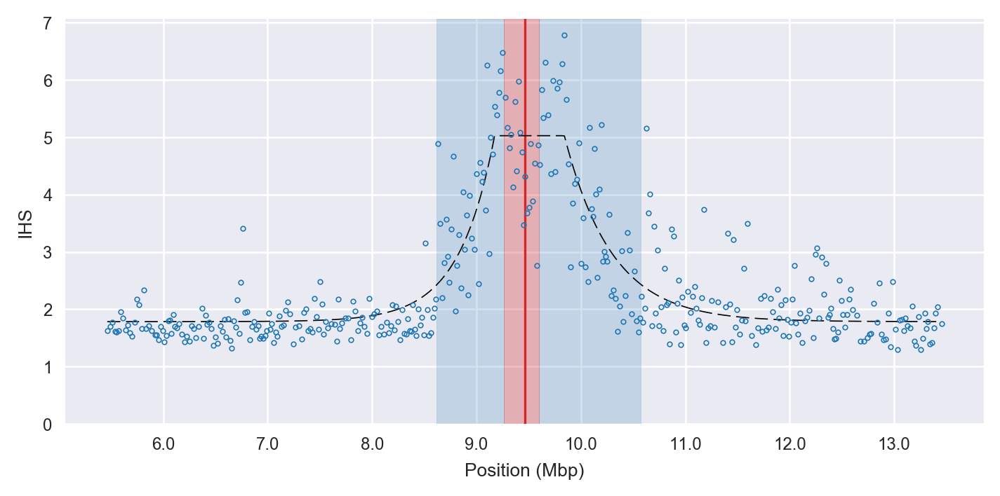

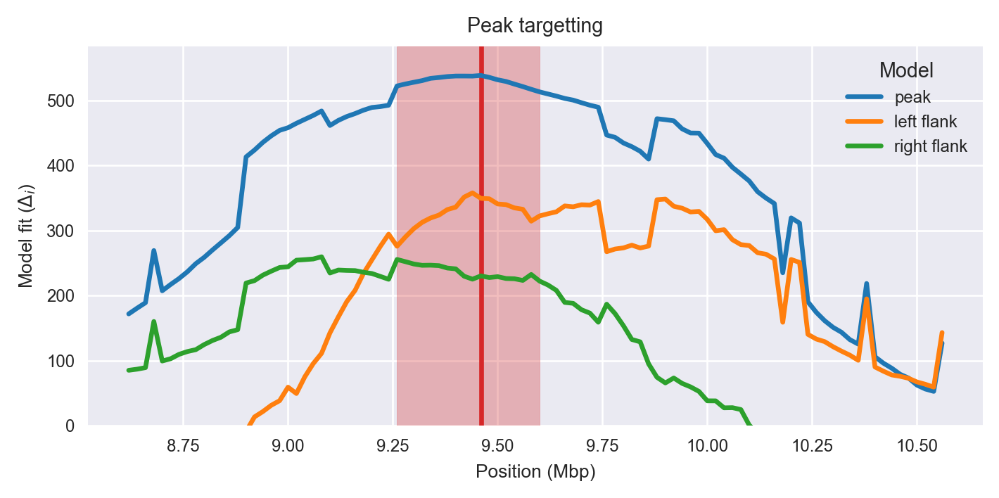

find the next peak
next peak: 737 493.518
Iteration 2
Peak center (index, location): 737, 14740001.0
Delta AIC: 493.5
Flank delta AICs: 271.4, 151.0
find limits of peak
peak limits: 14033307 17521381 702 878
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 85
    # data points      = 323
    # variables        = 5
    chi-square         = 172.900
    reduced chi-square = 0.544
    Akaike info crit   = -191.854
    Bayesian info crit = -172.966
[[Variables]]
    center:      0 (fixed)
    amplitude:   13.0214148 +/- 2.197113 (16.87%) (init= 3)
    decay:       1.94394737 +/- 0.205771 (10.59%) (init= 1)
    skew:       -1.97684551 +/- 0.072097 (3.65%) (init= 0)
    baseline:    1.83510585 +/- 0.062646 (3.41%) (init= 1)
    ceiling:     5.51647095 +/- 0.101285 (1.84%) (init= 5)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, decay)          = -0.959 
    C

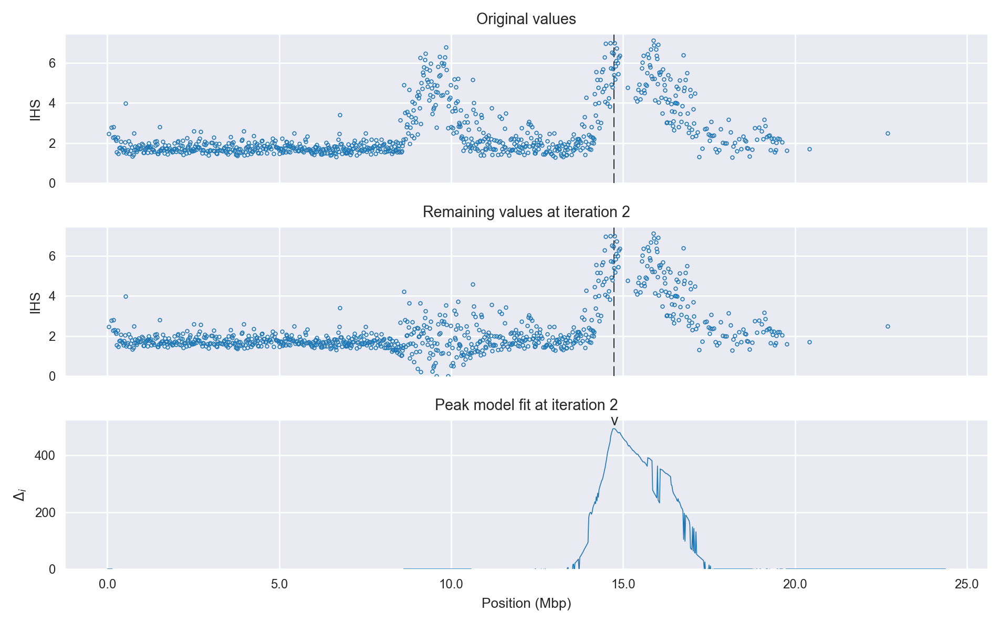

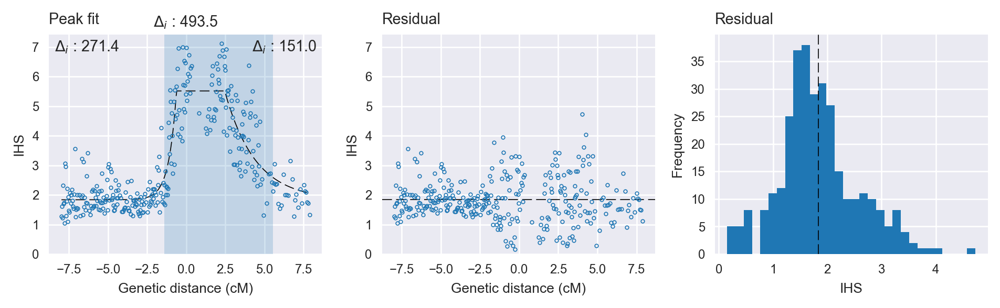

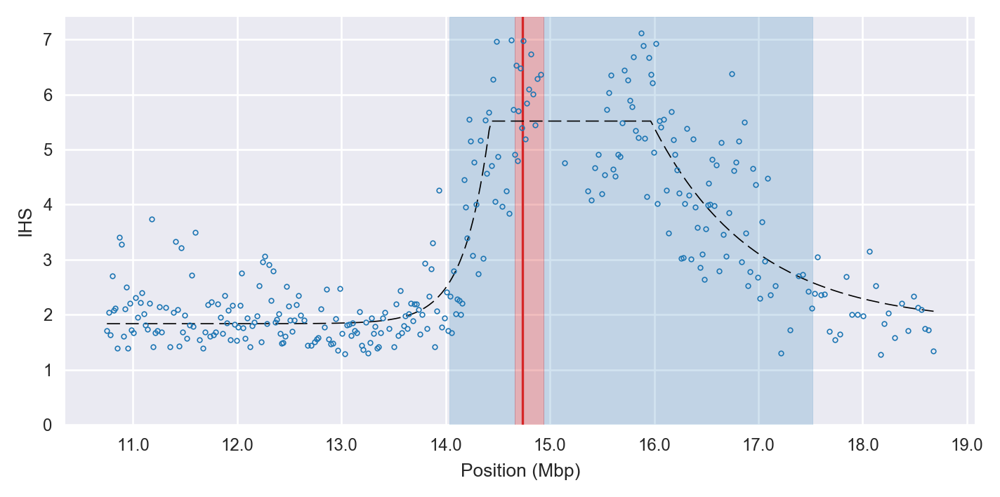

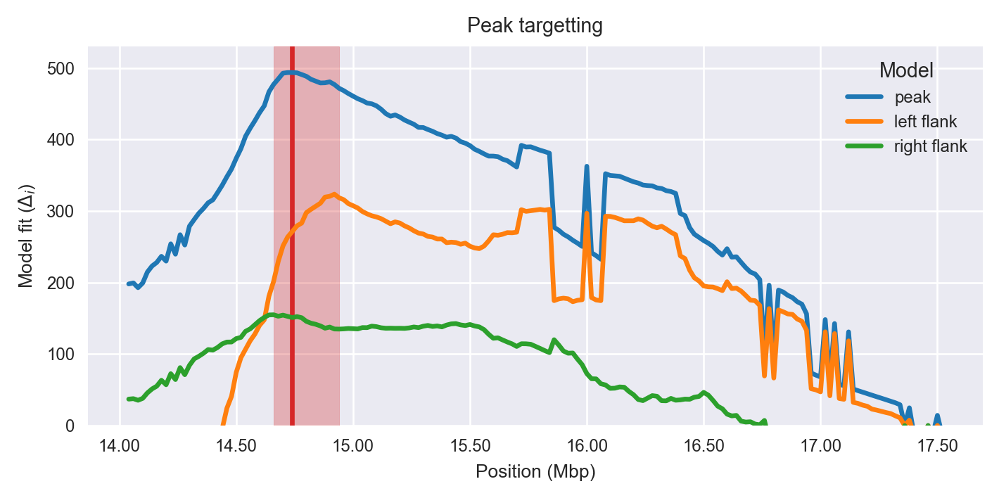

find the next peak
next peak: 0 0.0
all done


In [22]:
peaks = peakfit.find_peaks(starts=starts, ends=ends, values=values, percentiles=percentiles, centers=centers, 
                           gflank=8, gmap=gmap['X'], fitters=[skewed_exp_fitter], show_plots=True, statistic_label='IHS', 
                           log_file=None)
peaks = list(peaks)

scan progress 0 2e-06
scan progress 100 4.00000199985
scan progress 200 8.00000200041
scan progress 300 12.000002001
scan progress 400 16.0000020015
scan progress 500 20.0000019985
scan progress 600 24.0000019955
scan progress 700 28.0000019925
scan progress 800 32.0000019896
scan progress 900 36.0000019937
scan progress 1000 40.0000019978
scan progress 1100 41.0146449953
scan progress 1200 42.0146449928
first peak: 473 538.453
Iteration 1
Peak center (index, location): 473, 9460001.0
Delta AIC: 538.5
Flank delta AICs: 349.4, 230.1
find limits of peak
peak limits: 8619527 10570041 431 530
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 78
    # data points      = 404
    # variables        = 5
    chi-square         = 145.730
    reduced chi-square = 0.365
    Akaike info crit   = -401.942
    Bayesian info crit = -381.935
[[Variables]]
    center:      0 (fixed)
    amplitude:   7.49100265 +/- 0.883655

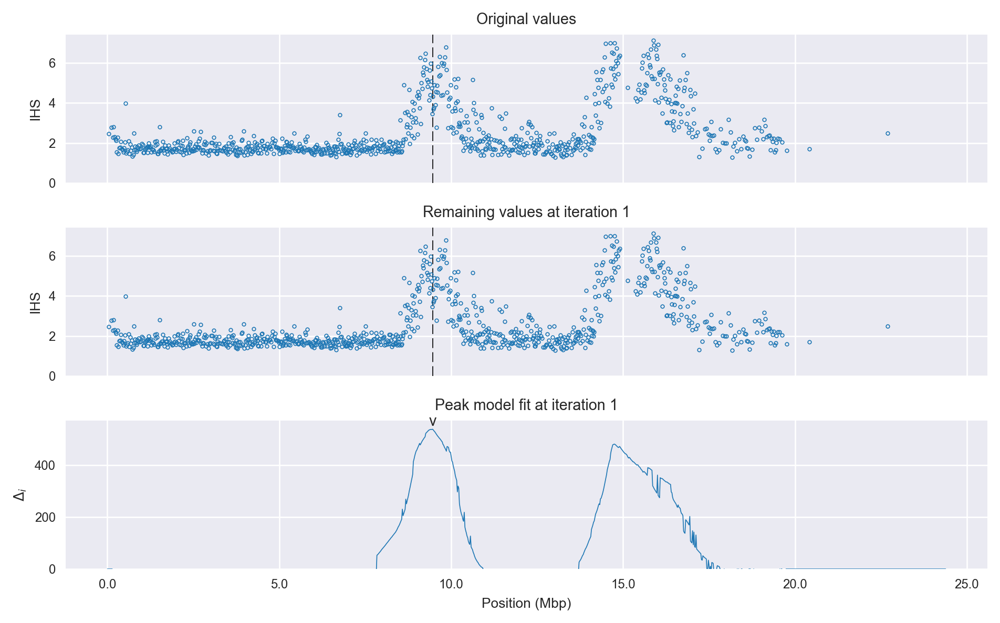

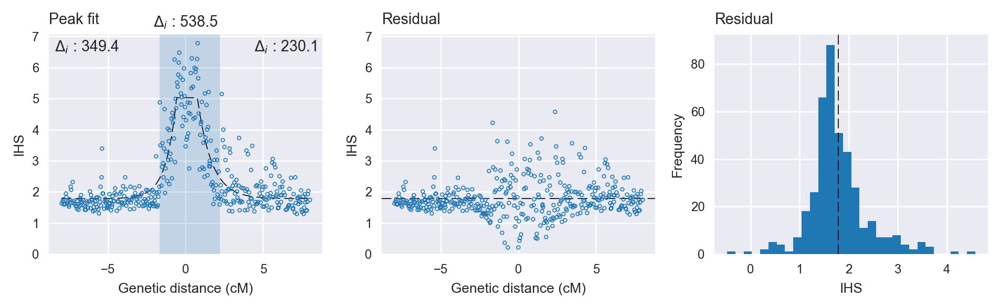

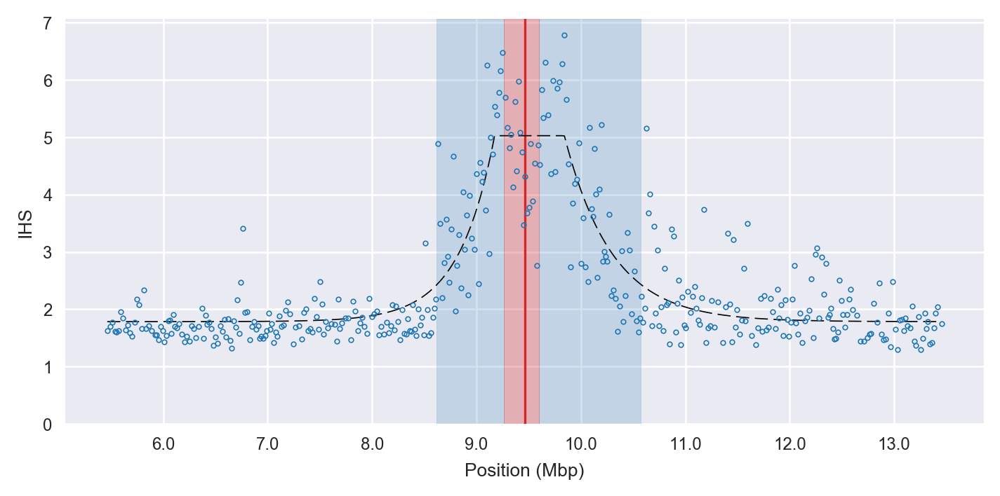

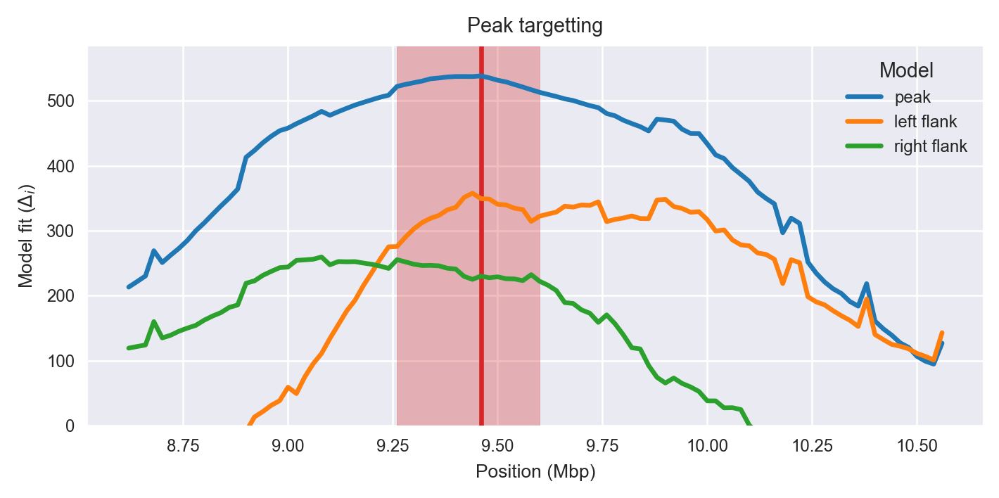

find the next peak
next peak: 737 493.518
Iteration 2
Peak center (index, location): 737, 14740001.0
Delta AIC: 493.5
Flank delta AICs: 271.4, 151.0
find limits of peak
peak limits: 14033307 17521381 702 878
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 85
    # data points      = 323
    # variables        = 5
    chi-square         = 172.900
    reduced chi-square = 0.544
    Akaike info crit   = -191.854
    Bayesian info crit = -172.966
[[Variables]]
    center:      0 (fixed)
    amplitude:   13.0214148 +/- 2.197113 (16.87%) (init= 3)
    decay:       1.94394737 +/- 0.205771 (10.59%) (init= 1)
    skew:       -1.97684551 +/- 0.072097 (3.65%) (init= 0)
    baseline:    1.83510585 +/- 0.062646 (3.41%) (init= 1)
    ceiling:     5.51647095 +/- 0.101285 (1.84%) (init= 5)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, decay)          = -0.959 
    C

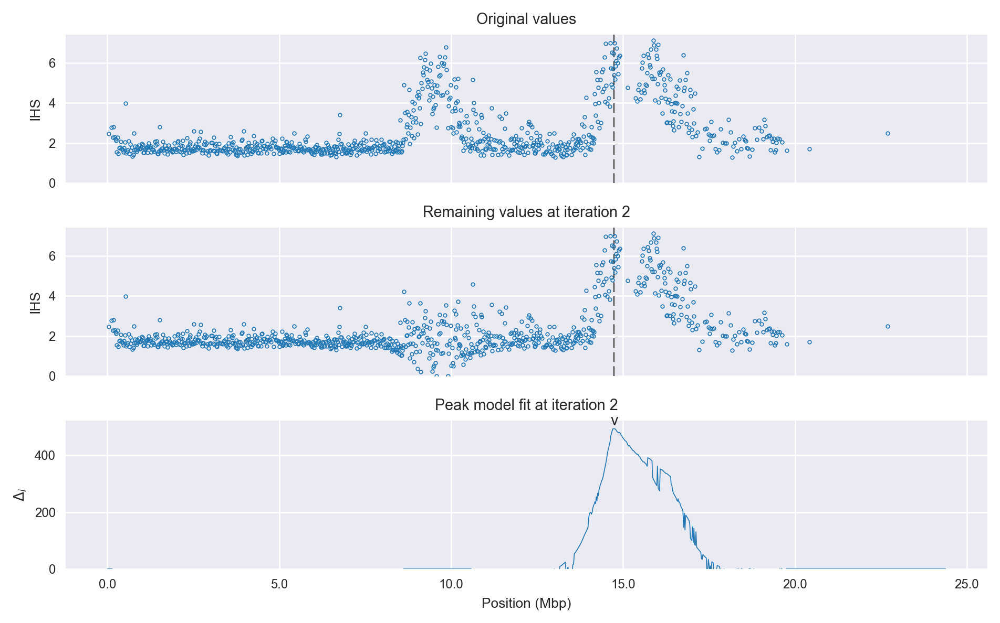

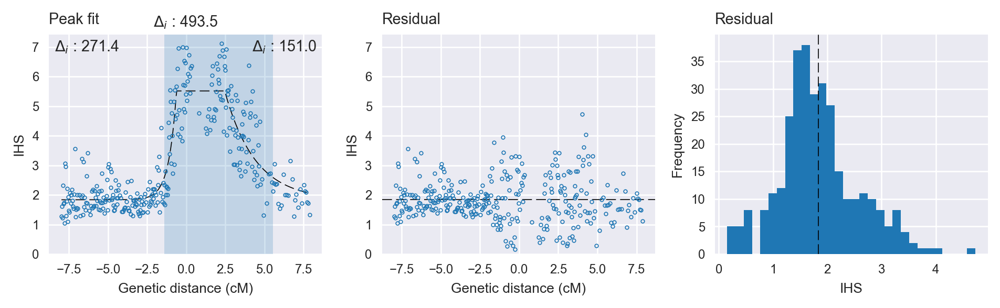

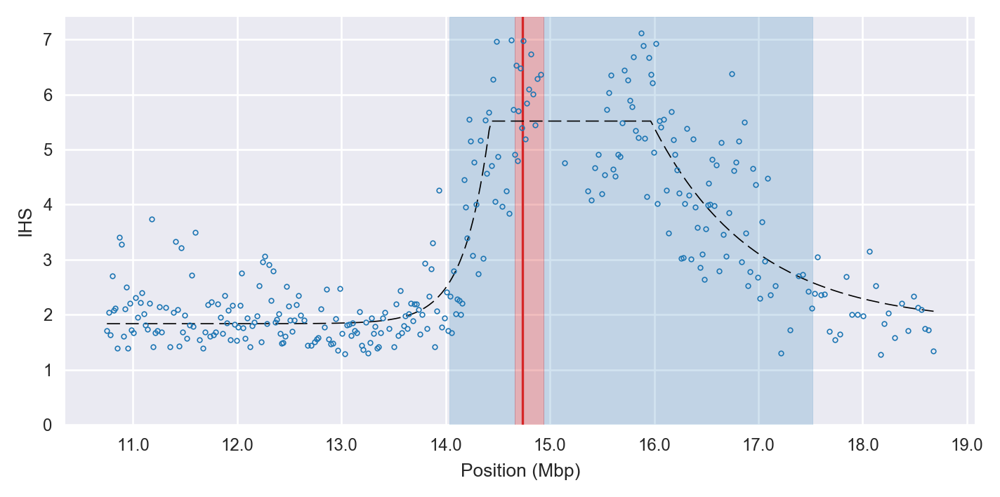

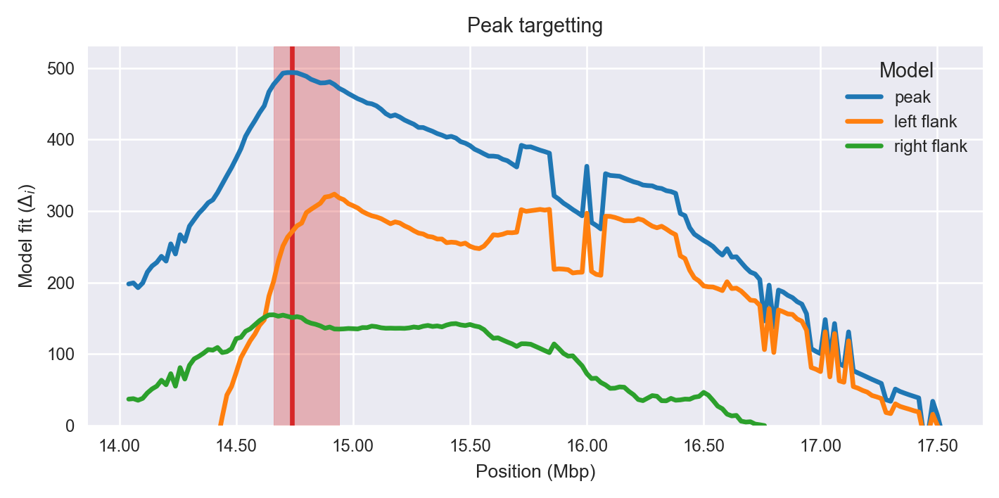

find the next peak
next peak: 0 0.0
all done


In [23]:
peaks = peakfit.find_peaks(starts=starts, ends=ends, values=values, percentiles=percentiles, centers=centers, 
                           gflank=8, gmap=gmap['X'], fitters=[skewed_exp_fitter, skewed_gauss_fitter], show_plots=True, statistic_label='IHS', 
                           log_file=None)
peaks = list(peaks)

In [24]:
starts, ends, values, percentiles = peakfit.extract_windowed_values(df, seqid=('2R', '2L'), genome=genome)

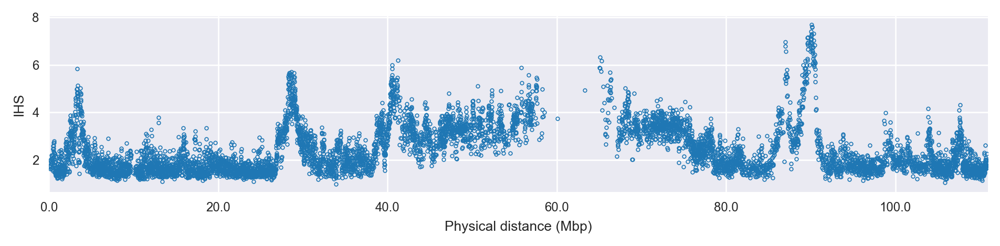

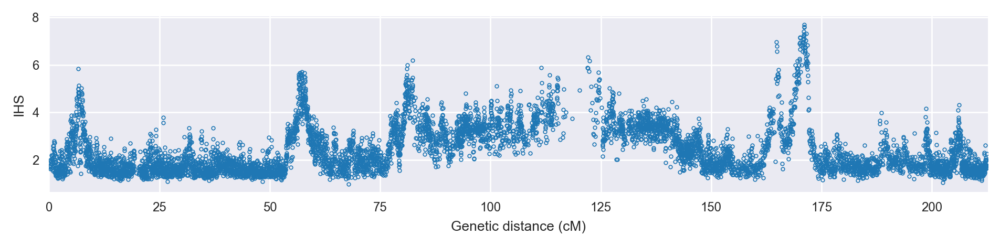

In [25]:
peakfit.plot_windowed_values(starts, ends, values, ylabel='IHS');
peakfit.plot_windowed_values(starts, ends, values, ylabel='IHS', gmap=gmap['2']);

In [26]:
centers = np.arange(1, ends[-1], 20000)

scan progress 0 2e-06
scan progress 100 4.00000199985
scan progress 200 8.00000200041
scan progress 300 12.000002001
scan progress 400 16.0000020015
scan progress 500 20.0000019985
scan progress 600 24.0000019955
scan progress 700 28.0000019925
scan progress 800 32.0000019896
scan progress 900 36.0000019937
scan progress 1000 40.0000019978
scan progress 1100 44.0000020019
scan progress 1200 48.000002006
scan progress 1300 52.0000020101
scan progress 1400 56.0000020142
scan progress 1500 60.0000020183
scan progress 1600 64.0000020224
scan progress 1700 68.0000020123
scan progress 1800 72.0000020023
scan progress 1900 76.0000019922
scan progress 2000 80.0000019821
scan progress 2100 84.000001972
scan progress 2200 88.0000019619
scan progress 2300 92.0000019518
scan progress 2400 96.0000019417
scan progress 2500 100.000001932
scan progress 2600 104.000001921
scan progress 2700 108.000001911
scan progress 2800 112.000001901
scan progress 2900 116.000001891
scan progress 3000 118.477165885


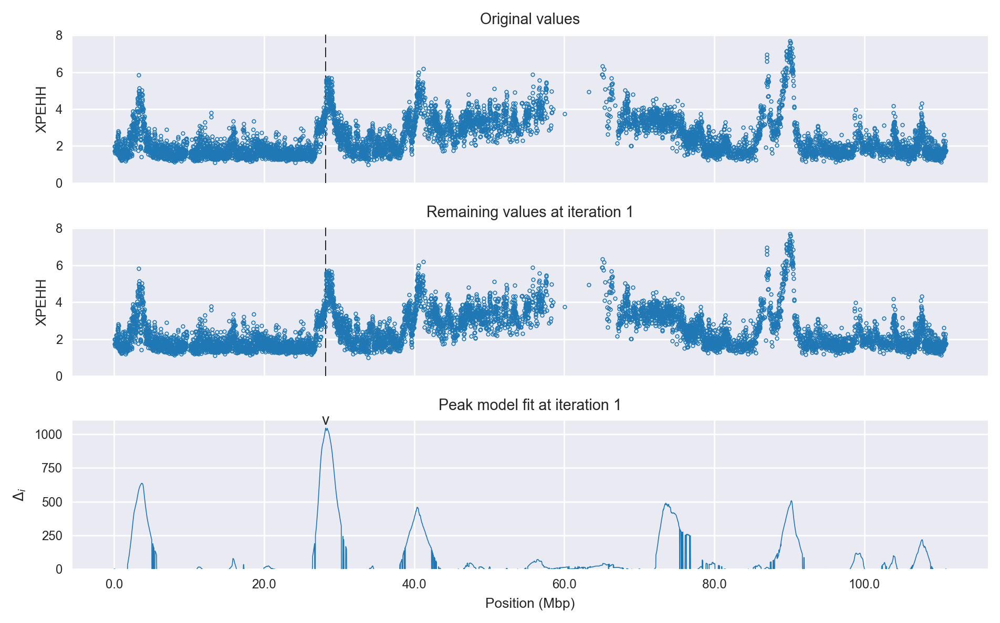

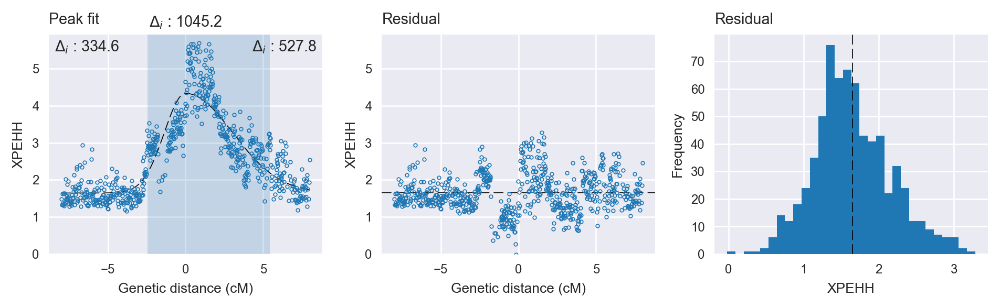

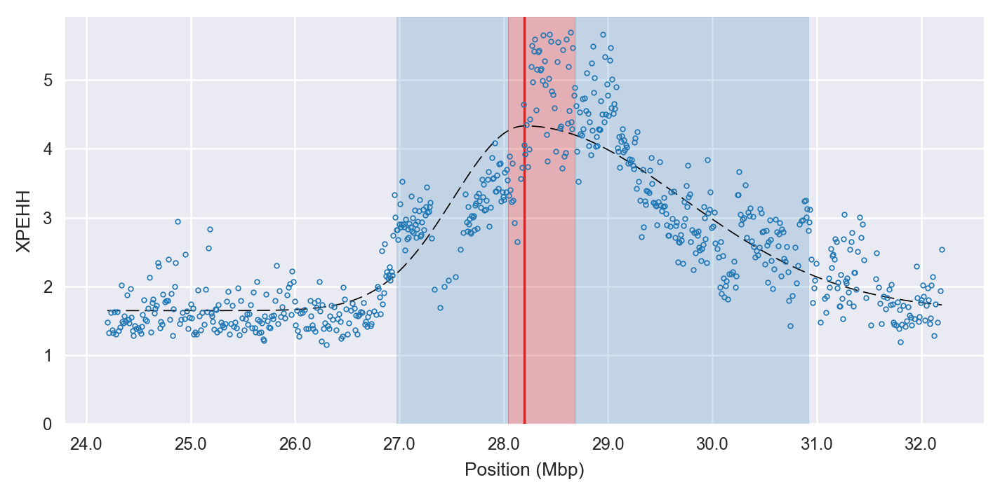

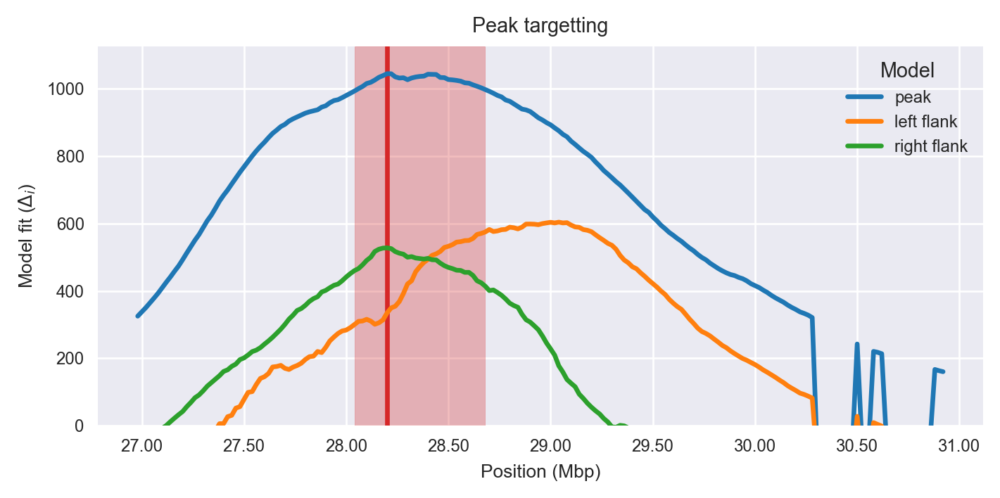

find the next peak
next peak: 185 635.907
Iteration 2
Peak center (index, location): 185, 3700001.0
Delta AIC: 635.9
Flank delta AICs: 262.8, 414.3
find limits of peak
peak limits: 2067270 4327125 104 218
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 43
    # data points      = 635
    # variables        = 4
    chi-square         = 157.788
    reduced chi-square = 0.250
    Akaike info crit   = -876.158
    Bayesian info crit = -858.344
[[Variables]]
    center:      0 (fixed)
    amplitude:   2.06882717 +/- 0.065213 (3.15%) (init= 3)
    sigma:       0.70299282 +/- 0.041601 (5.92%) (init= 1)
    skew:        1.37533323 +/- 0.089512 (6.51%) (init= 0)
    baseline:    1.74624506 +/- 0.027021 (1.55%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, skew)               = -0.753 
    C(sigma, baseline)           = -0.304 
    C

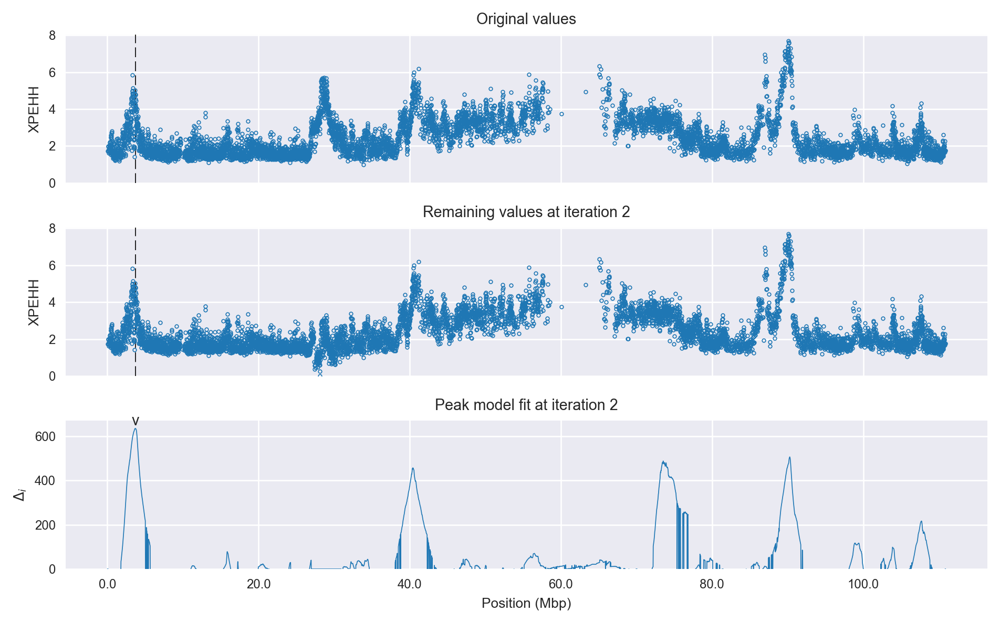

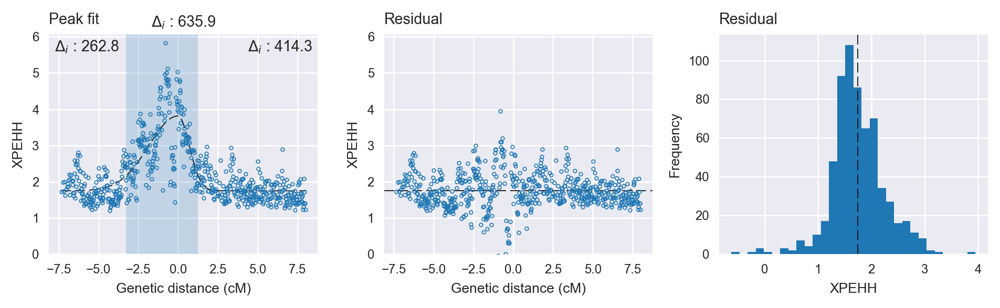

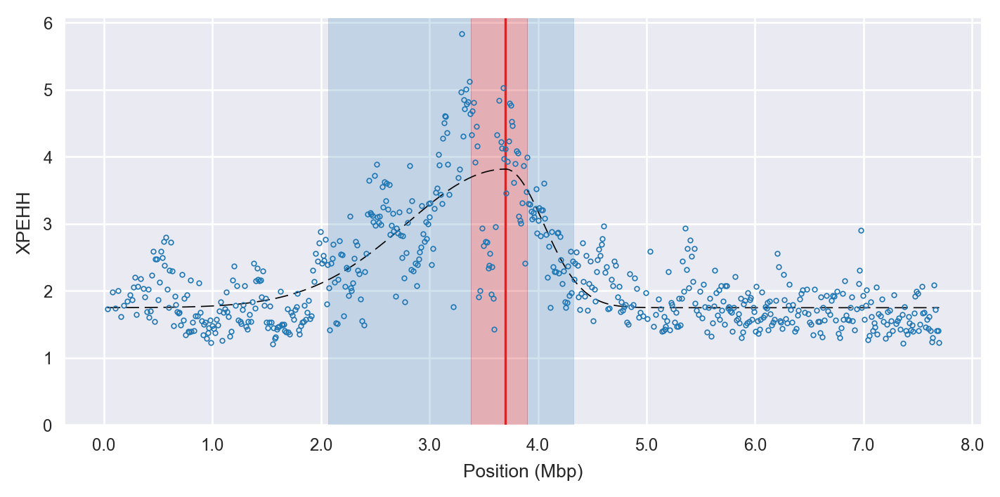

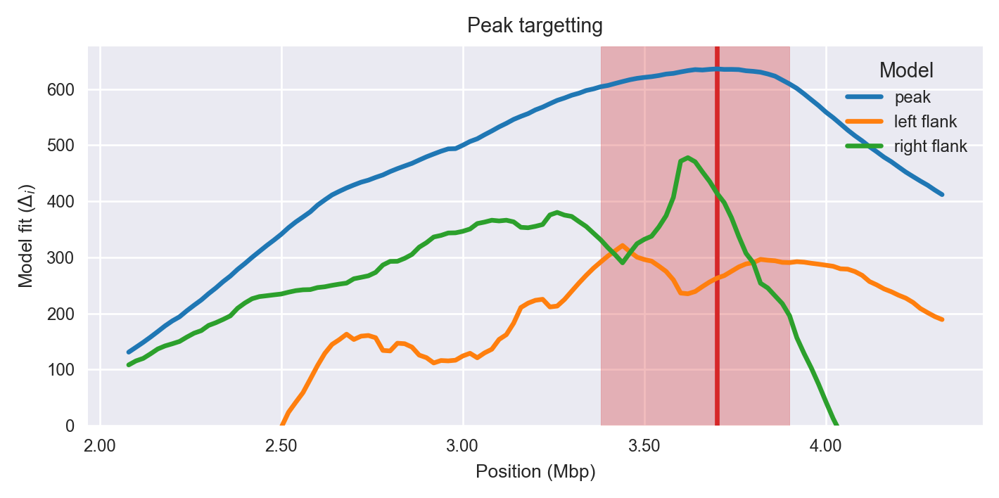

find the next peak
next peak: 4514 507.152
Iteration 3
Peak center (index, location): 4514, 90280001.0
Delta AIC: 507.2
Flank delta AICs: 121.9, 306.7
find limits of peak
peak limits: 88429758 90736556 4422 4538
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 49
    # data points      = 391
    # variables        = 4
    chi-square         = 309.200
    reduced chi-square = 0.799
    Akaike info crit   = -83.775
    Bayesian info crit = -67.900
[[Variables]]
    center:      0 (fixed)
    amplitude:   4.58717431 +/- 0.148506 (3.24%) (init= 3)
    sigma:       0.51745005 +/- 0.038193 (7.38%) (init= 1)
    skew:        1.99999844 +/- 0.109134 (5.46%) (init= 0)
    baseline:    2.39568287 +/- 0.060255 (2.52%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, skew)               = -0.845 
    C(amplitude, baseline)       = -0.305 


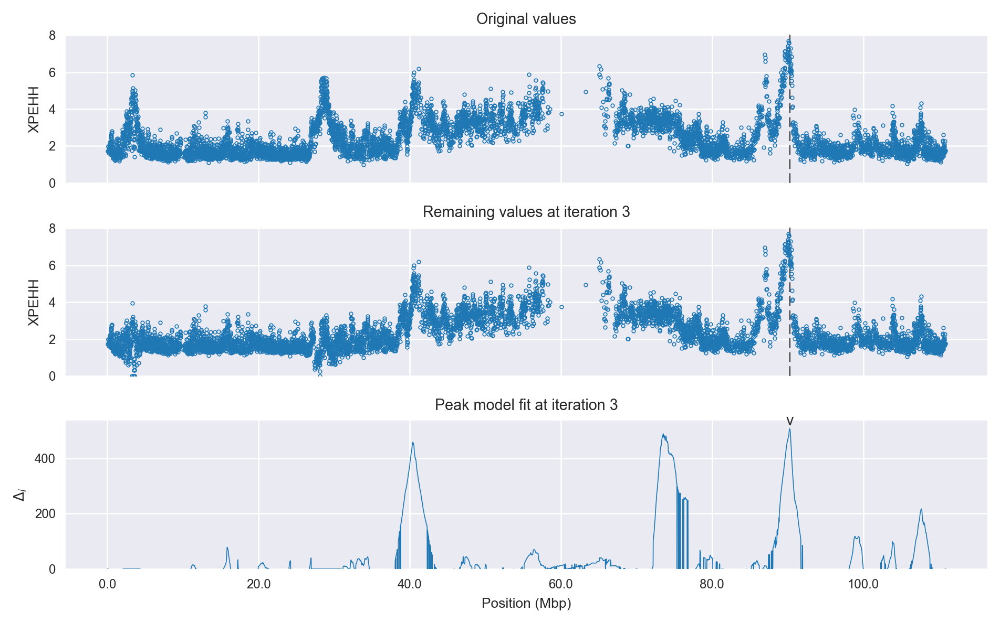

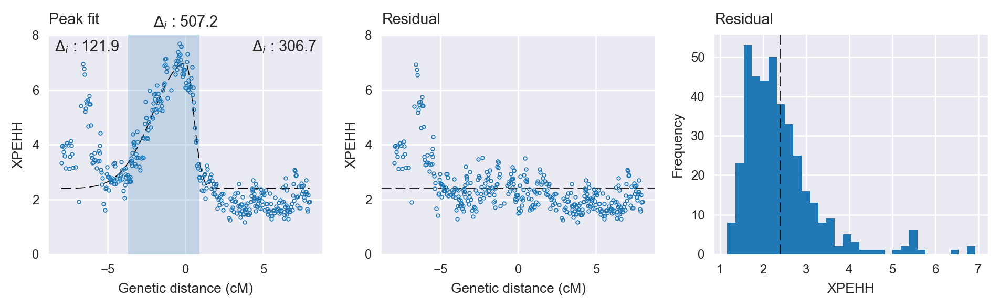

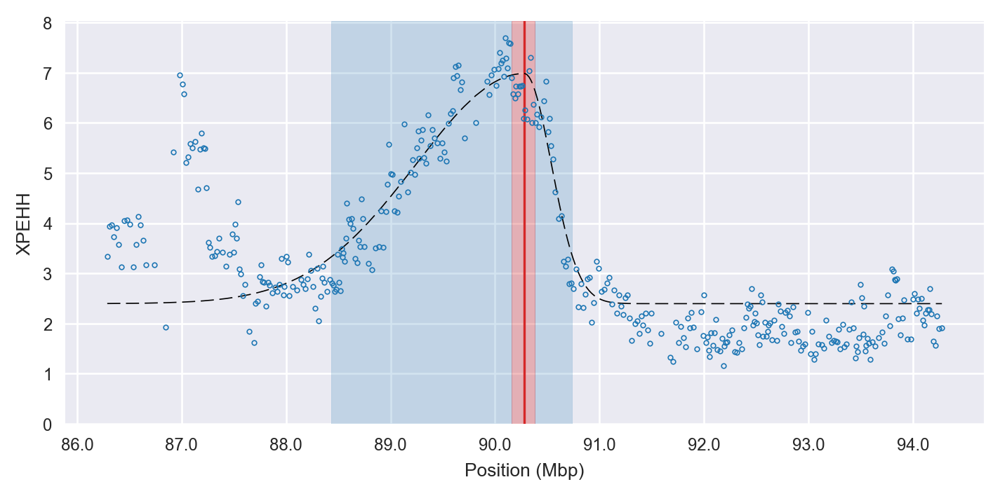

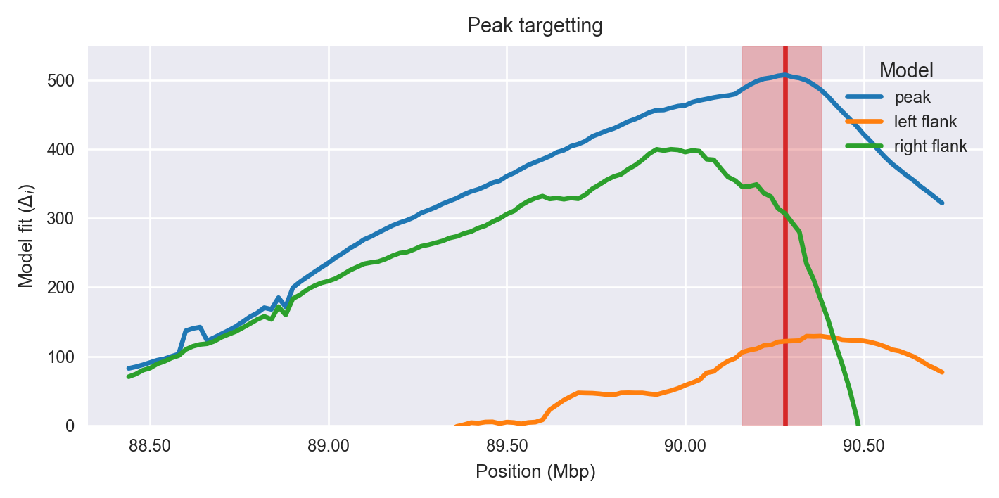

find the next peak
next peak: 3677 488.66
Iteration 4
Peak center (index, location): 3677, 73540001.0
Delta AIC: 488.7
Flank delta AICs: 7.2, 268.2
find limits of peak
peak limits: 69540443 76709575 3478 3837
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 65
    # data points      = 591
    # variables        = 4
    chi-square         = 88.584
    reduced chi-square = 0.151
    Akaike info crit   = -1113.637
    Bayesian info crit = -1096.110
[[Variables]]
    center:      0 (fixed)
    amplitude:   1.36174793 +/- 0.103955 (7.63%) (init= 3)
    sigma:       3.53131714 +/- 0.318747 (9.03%) (init= 1)
    skew:        1.82264810 +/- 0.230735 (12.66%) (init= 0)
    baseline:    2.11711278 +/- 0.106798 (5.04%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, baseline)       = -0.966 
   

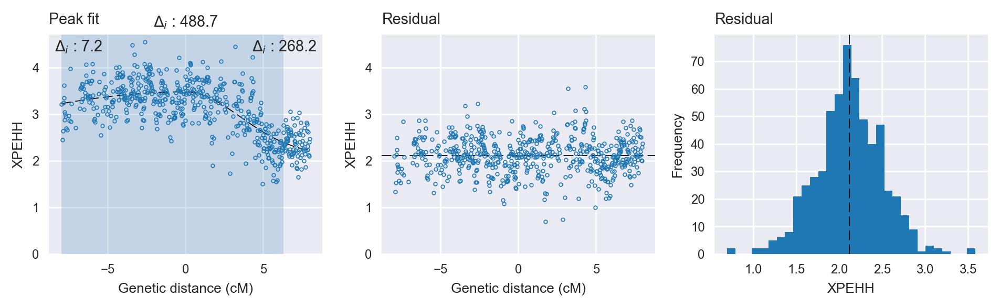

find the next peak
next peak: 2021 457.803
Iteration 4
Peak center (index, location): 2021, 40420001.0
Delta AIC: 457.8
Flank delta AICs: 143.2, 210.6
find limits of peak
peak limits: 39725922 43214498 1987 2162
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 102
    # data points      = 543
    # variables        = 4
    chi-square         = 220.340
    reduced chi-square = 0.409
    Akaike info crit   = -481.752
    Bayesian info crit = -464.563
[[Variables]]
    center:      0 (fixed)
    amplitude:   2.13453046 +/- 0.078901 (3.70%) (init= 3)
    sigma:       3.11831513 +/- 0.148758 (4.77%) (init= 1)
    skew:       -1.99999894 +/- 0.104669 (5.23%) (init= 0)
    baseline:    2.43778085 +/- 0.042934 (1.76%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, baseline)           = -0.498 
    C(amplitude, baseline)       = -0.44

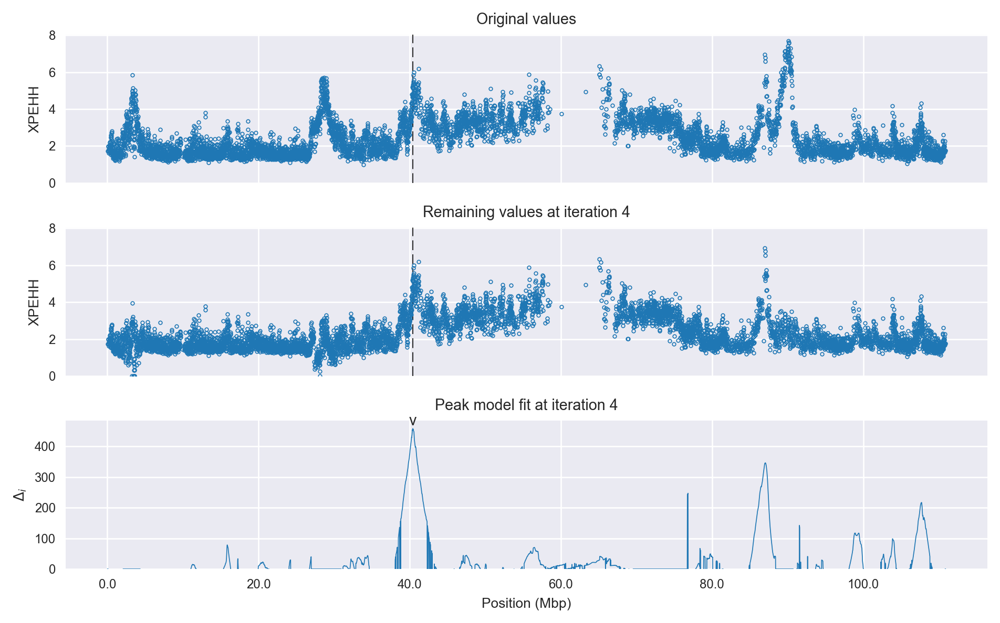

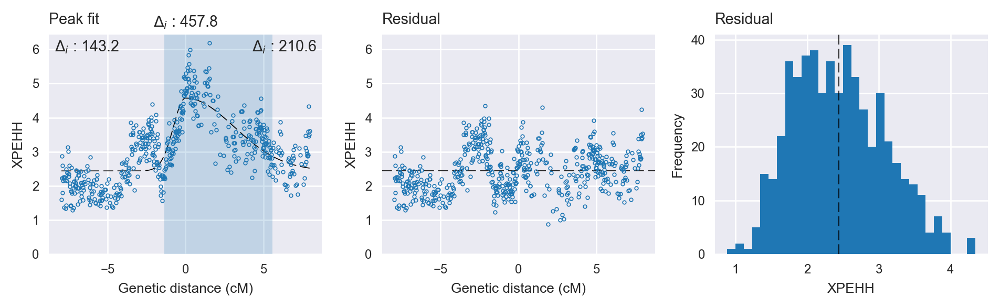

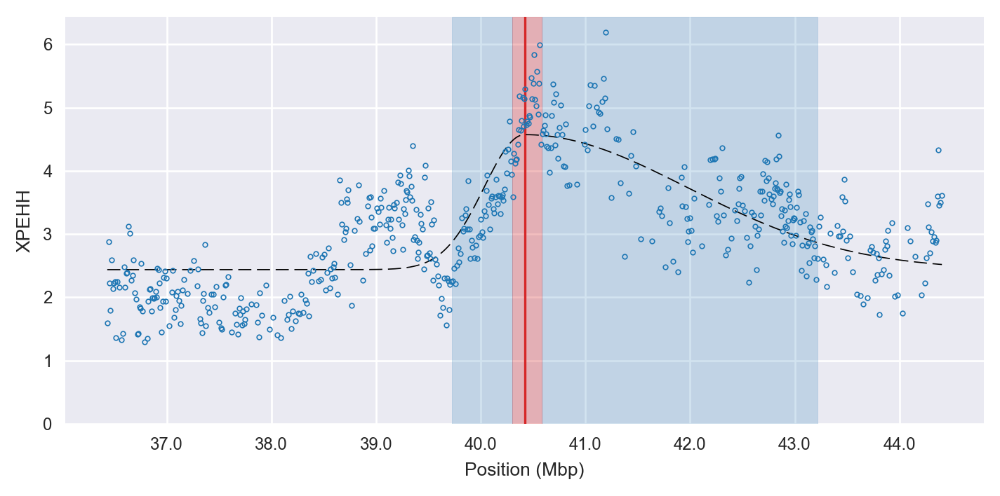

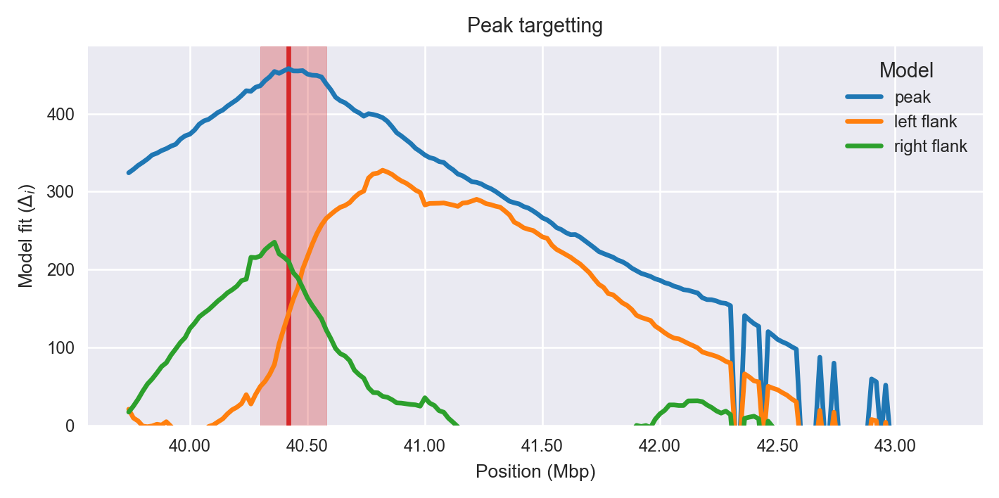

find the next peak
next peak: 4352 346.175
Iteration 5
Peak center (index, location): 4352, 87040001.0
Delta AIC: 346.2
Flank delta AICs: 181.3, 187.9
find limits of peak
peak limits: 85938596 87595245 4297 4381
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 33
    # data points      = 368
    # variables        = 4
    chi-square         = 116.416
    reduced chi-square = 0.320
    Akaike info crit   = -415.535
    Bayesian info crit = -399.903
[[Variables]]
    center:      0 (fixed)
    amplitude:   2.96666090 +/- 0.135672 (4.57%) (init= 3)
    sigma:       0.62153069 +/- 0.043905 (7.06%) (init= 1)
    skew:        0.97476951 +/- 0.107792 (11.06%) (init= 0)
    baseline:    2.12002769 +/- 0.034949 (1.65%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, skew)               = -0.745 
    C(amplitude, sigma)          = -0.38

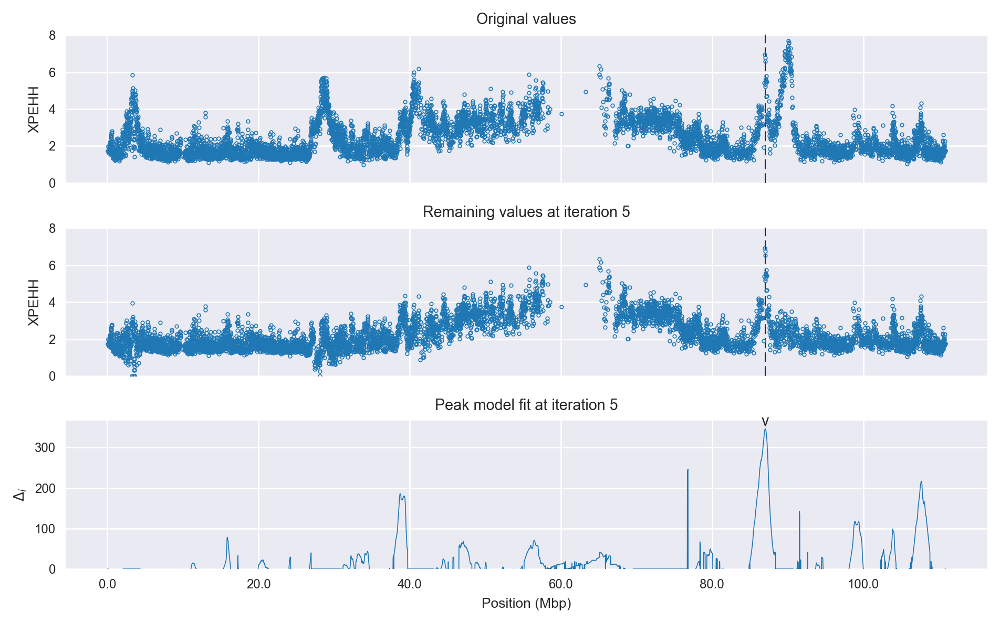

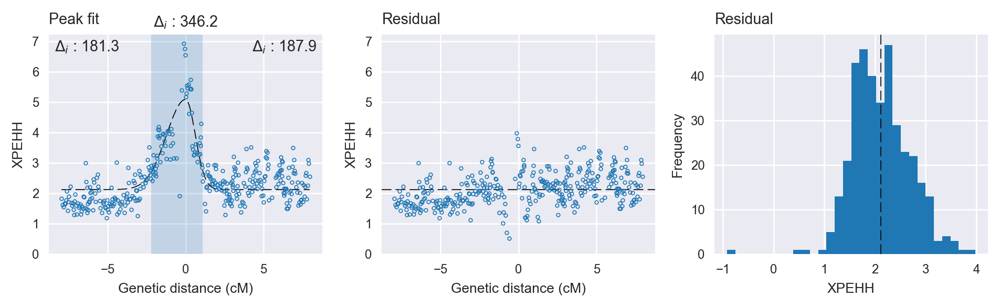

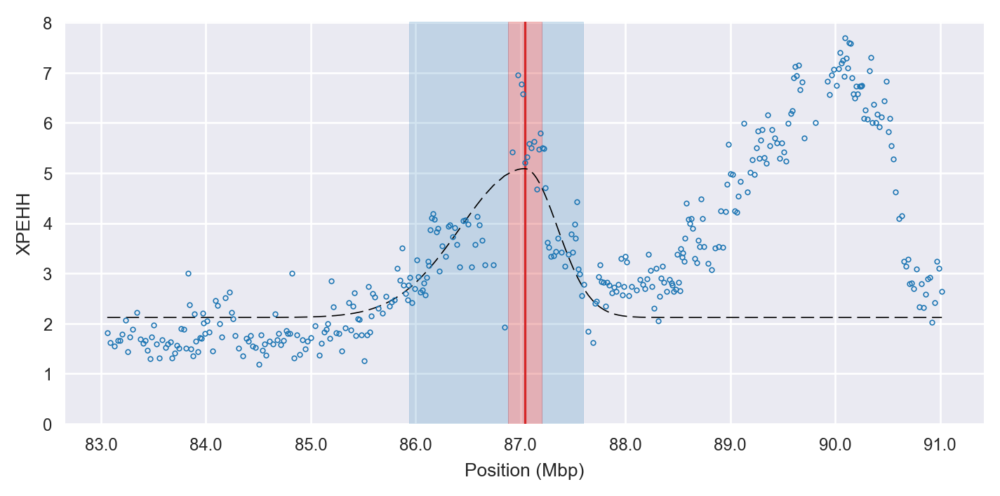

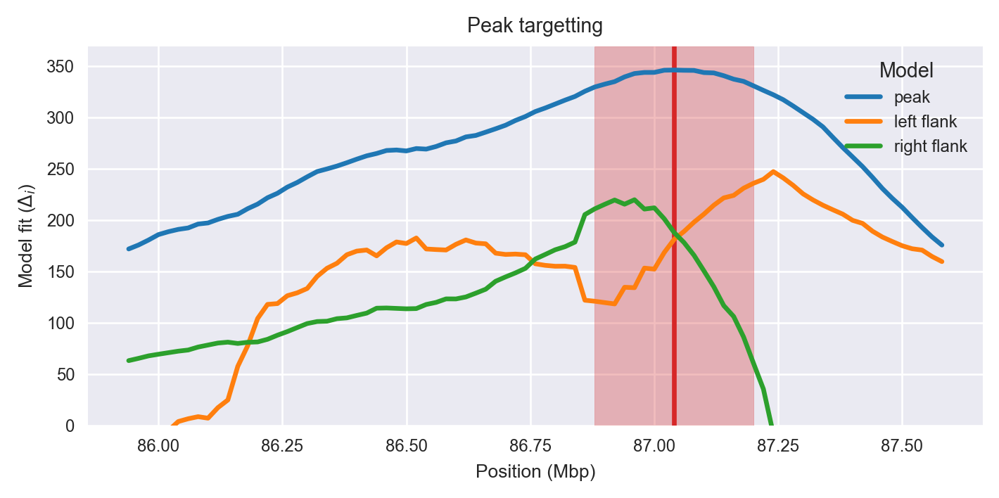

find the next peak
next peak: 3841 246.969
Iteration 6
Peak center (index, location): 3841, 76820001.0
Delta AIC: 247.0
Flank delta AICs: -53.5, 54.9
find limits of peak
peak limits: 72823374 80296172 3642 4016
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 532
    # data points      = 631
    # variables        = 4
    chi-square         = 198.392
    reduced chi-square = 0.316
    Akaike info crit   = -722.107
    Bayesian info crit = -704.318
[[Variables]]
    center:      0 (fixed)
    amplitude:   1.45765282 +/- 0.214206 (14.70%) (init= 3)
    sigma:       3.88434510 +/- 0.577600 (14.87%) (init= 1)
    skew:        1.99999997 +/- 0.792446 (39.62%) (init= 0)
    baseline:    1.43503716 +/- 0.221076 (15.41%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, baseline)       = -0.985

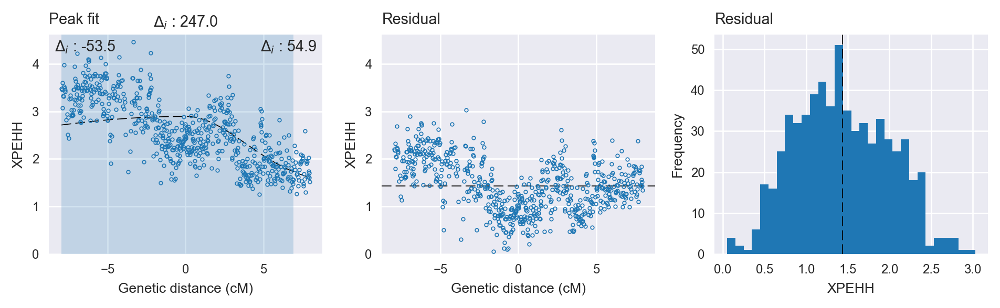

find the next peak
next peak: 5386 217.029
Iteration 6
Peak center (index, location): 5386, 107720001.0
Delta AIC: 217.0
Flank delta AICs: 102.0, 103.0
find limits of peak
peak limits: 107058599 107887607 5353 5396
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 53
    # data points      = 643
    # variables        = 4
    chi-square         = 129.116
    reduced chi-square = 0.202
    Akaike info crit   = -1024.294
    Bayesian info crit = -1006.429
[[Variables]]
    center:      0 (fixed)
    amplitude:   1.26937793 +/- 0.086306 (6.80%) (init= 3)
    sigma:       0.19313756 +/- 0.029376 (15.21%) (init= 1)
    skew:        1.94554730 +/- 0.230055 (11.82%) (init= 0)
    baseline:    1.79744460 +/- 0.019602 (1.09%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, skew)               = -0.837 
    C(amplitude, sigma)          =

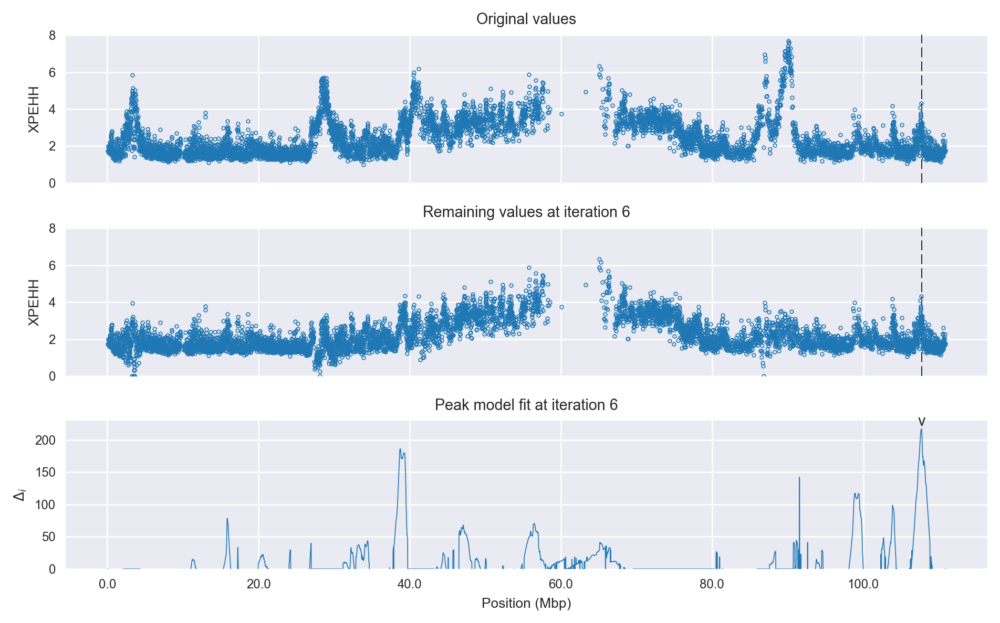

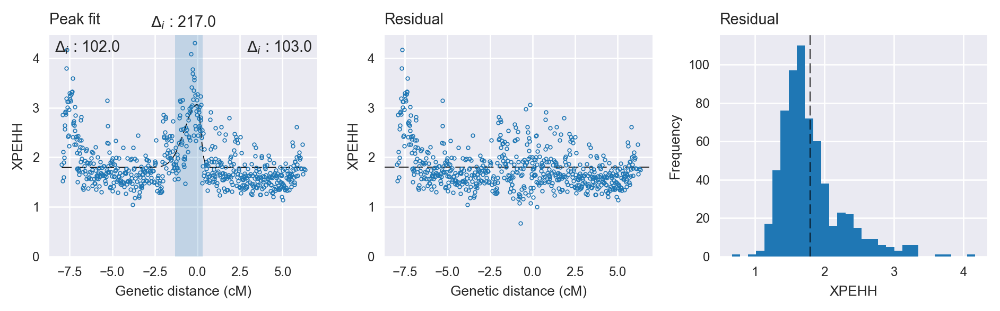

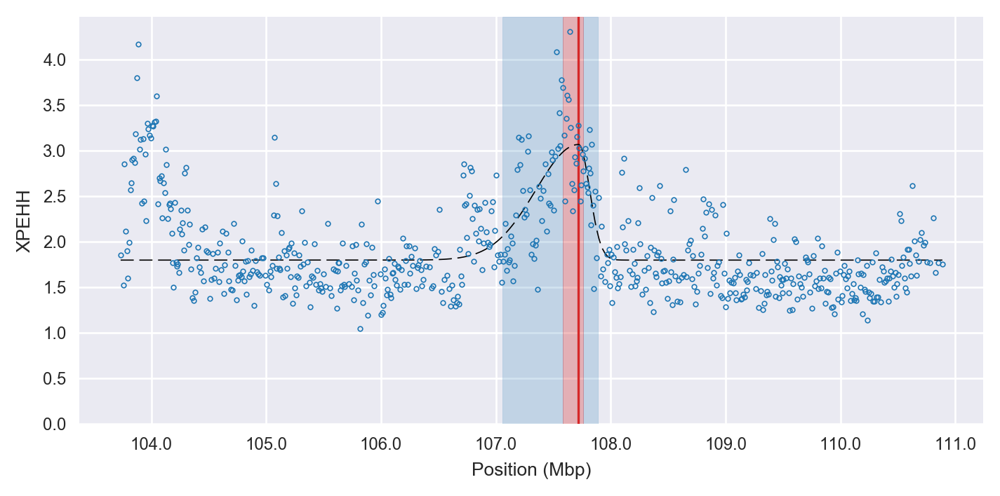

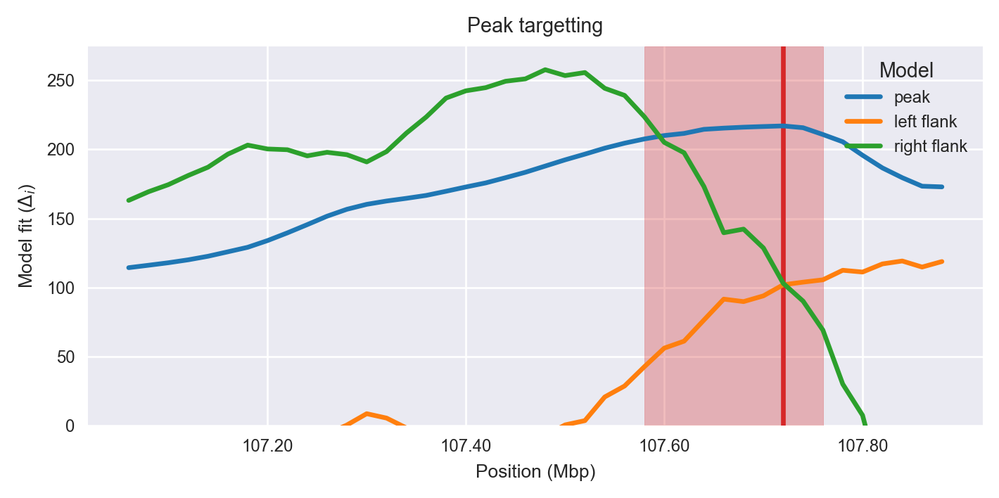

find the next peak
next peak: 5194 218.299
Iteration 7
Peak center (index, location): 5194, 103880001.0
Delta AIC: 218.3
Flank delta AICs: 43.9, 188.4
find limits of peak
peak limits: 103790887 104234101 5190 5213
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 52
    # data points      = 555
    # variables        = 4
    chi-square         = 74.912
    reduced chi-square = 0.136
    Akaike info crit   = -1103.472
    Bayesian info crit = -1086.196
[[Variables]]
    center:      0 (fixed)
    amplitude:   1.44222733 +/- 0.098061 (6.80%) (init= 3)
    sigma:       0.39438409 +/- 0.032576 (8.26%) (init= 1)
    skew:       -1.99999984 +/- 0.227892 (11.39%) (init= 0)
    baseline:    1.81251836 +/- 0.016657 (0.92%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, sigma)          = -0.505 
    C(sigma, skew)               = -0

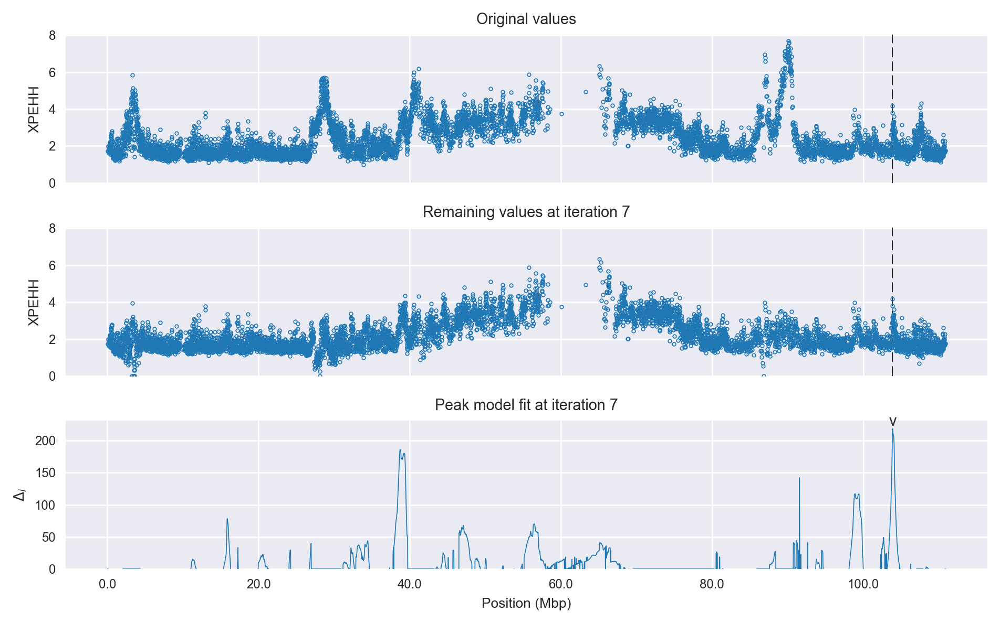

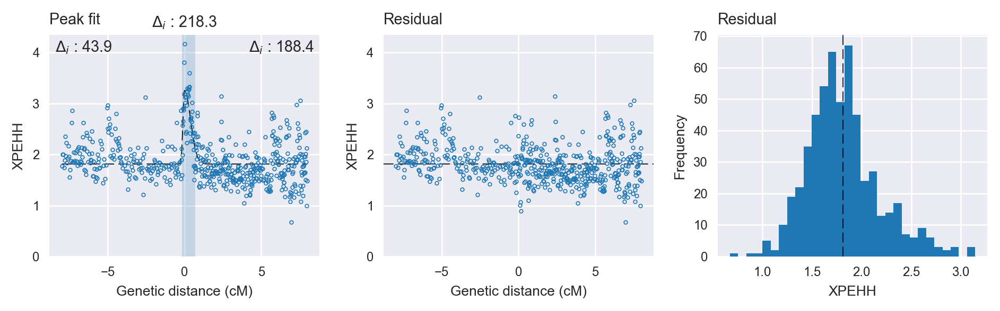

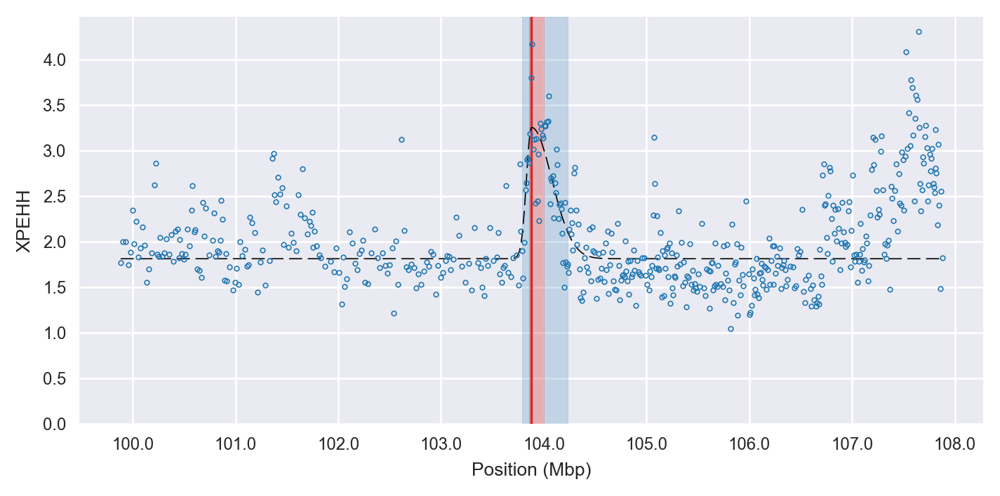

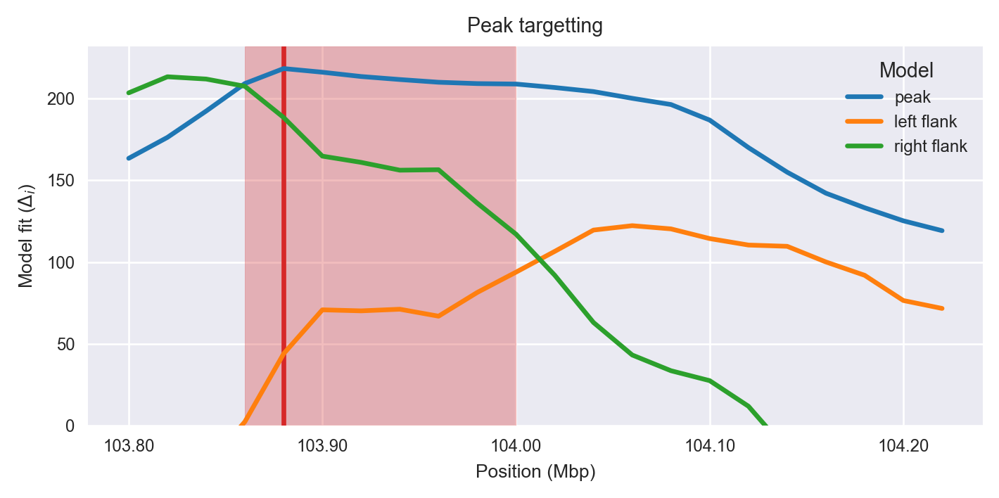

find the next peak
next peak: 1939 185.93
Iteration 8
Peak center (index, location): 1939, 38780001.0
Delta AIC: 185.9
Flank delta AICs: 43.7, 51.1
find limits of peak
peak limits: 38542177 39737087 1928 1988
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 40
    # data points      = 558
    # variables        = 4
    chi-square         = 153.953
    reduced chi-square = 0.278
    Akaike info crit   = -710.544
    Bayesian info crit = -693.247
[[Variables]]
    center:      0 (fixed)
    amplitude:   1.31789395 +/- 0.100158 (7.60%) (init= 3)
    sigma:       1.06416770 +/- 0.095627 (8.99%) (init= 1)
    skew:       -1.99999900 +/- 0.072514 (3.63%) (init= 0)
    baseline:    2.13152697 +/- 0.026178 (1.23%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, sigma)          = -0.501 
    C(sigma, baseline)           = -0.317 
 

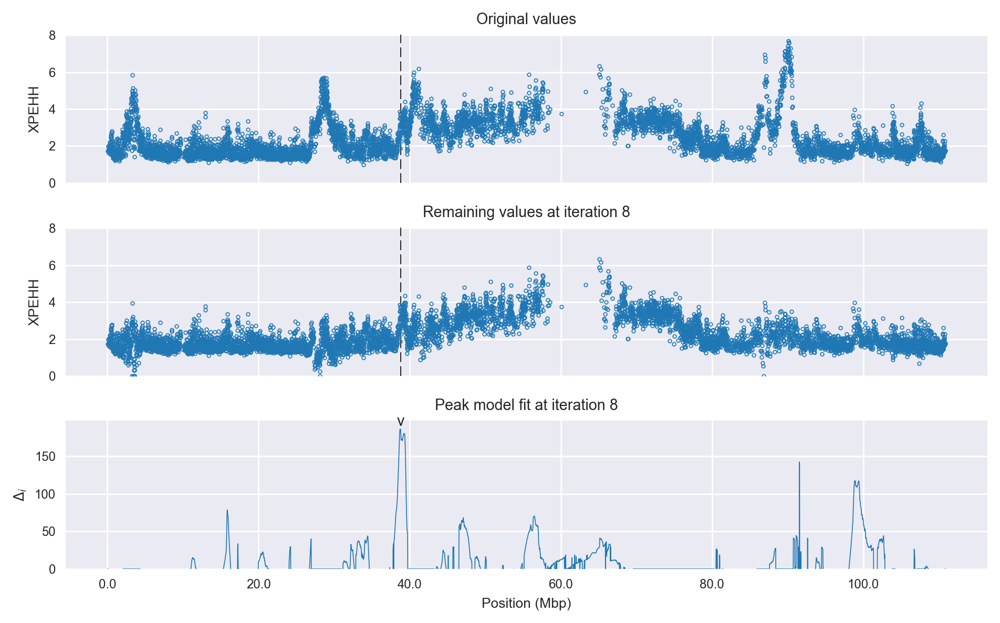

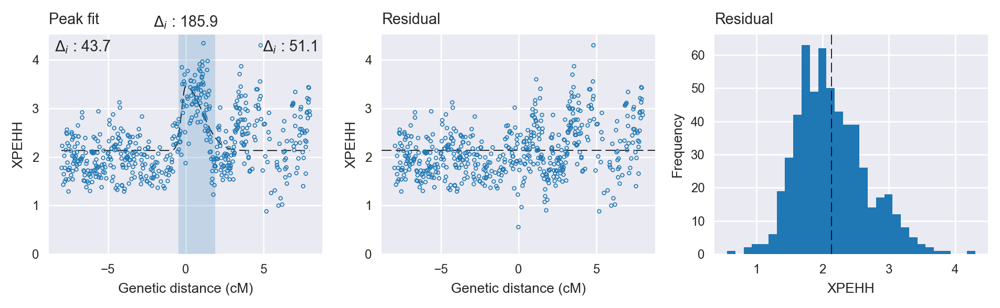

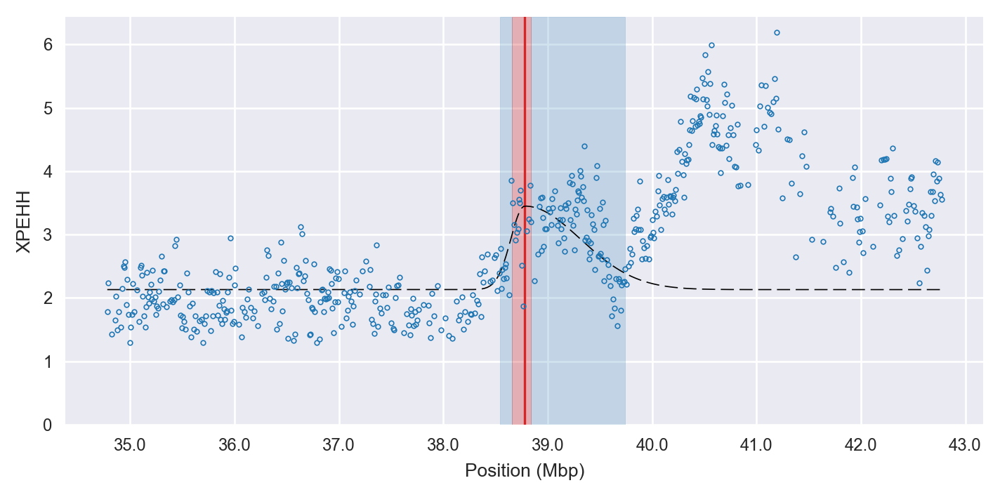

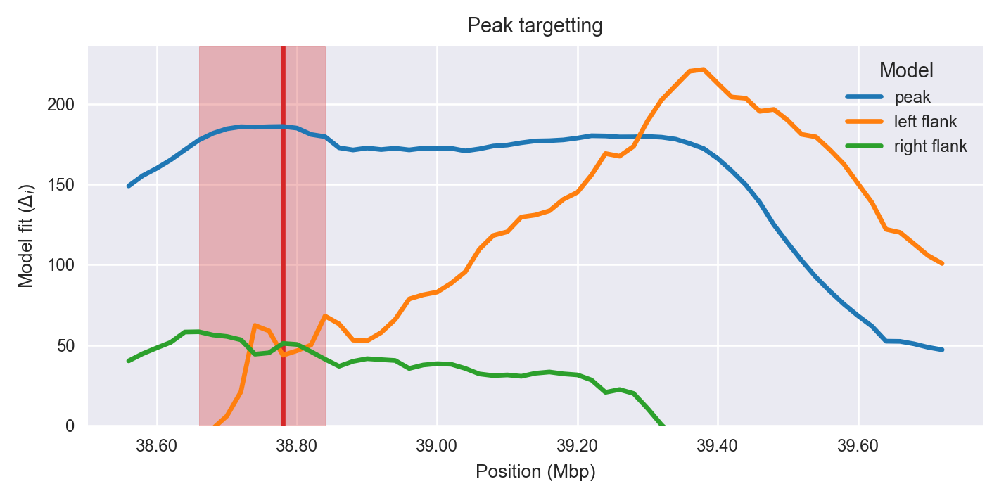

find the next peak
next peak: 4578 142.314
Iteration 9
Peak center (index, location): 4578, 91560001.0
Delta AIC: 142.3
Flank delta AICs: 3.5, -434.4
find limits of peak
peak limits: 87556258 92837283 4378 4643
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 96
    # data points      = 413
    # variables        = 4
    chi-square         = 813.396
    reduced chi-square = 1.989
    Akaike info crit   = 287.919
    Bayesian info crit = 304.013
[[Variables]]
    center:      0 (fixed)
    amplitude:   2.54917367 +/- 0.194696 (7.64%) (init= 3)
    sigma:       1.43471012 +/- 0.185063 (12.90%) (init= 1)
    skew:        1.99999998 +/- 0.218611 (10.93%) (init= 0)
    baseline:    1.82371825 +/- 0.129721 (7.11%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, skew)               =  0.625 
   

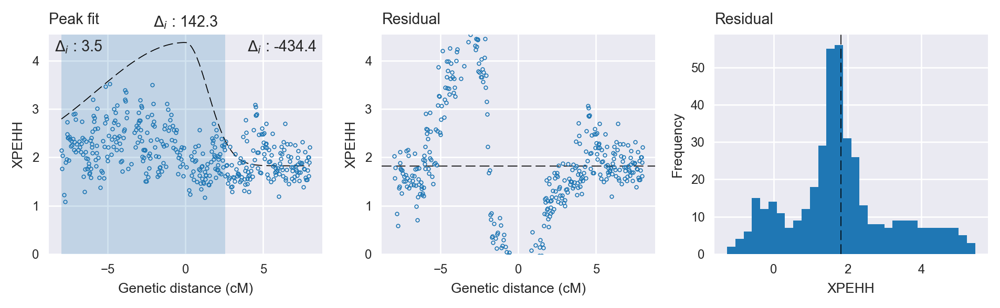

find the next peak
next peak: 4948 117.15
Iteration 9
Peak center (index, location): 4948, 98960001.0
Delta AIC: 117.1
Flank delta AICs: 72.8, 28.9
find limits of peak
peak limits: 98363654 101364318 4919 5070
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 302
    # data points      = 423
    # variables        = 4
    chi-square         = 48.218
    reduced chi-square = 0.115
    Akaike info crit   = -910.600
    Bayesian info crit = -894.410
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.66470031 +/- 0.053682 (8.08%) (init= 3)
    sigma:       2.68181305 +/- 0.277372 (10.34%) (init= 1)
    skew:       -1.99999998 +/- 0.034340 (1.72%) (init= 0)
    baseline:    1.72618946 +/- 0.023396 (1.36%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, baseline)           = -0.445 
    C(amplitude, sigma)          = -0.348 

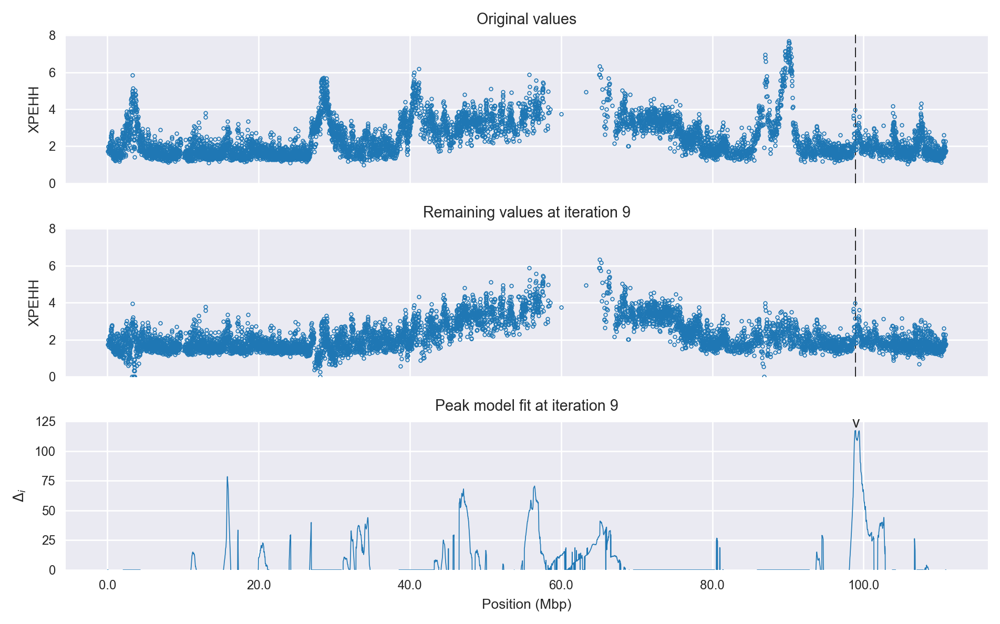

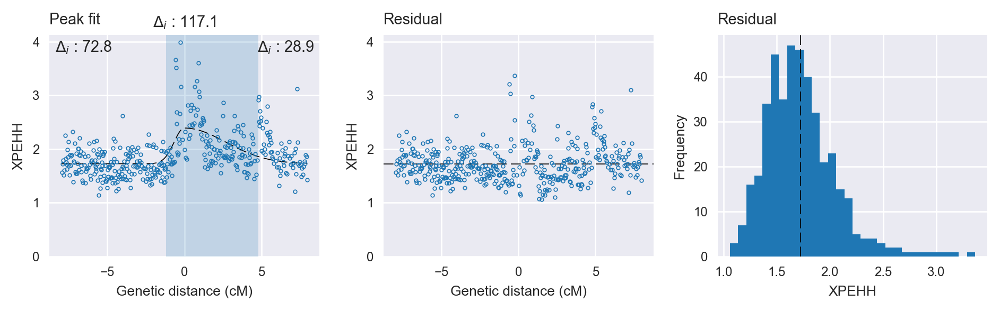

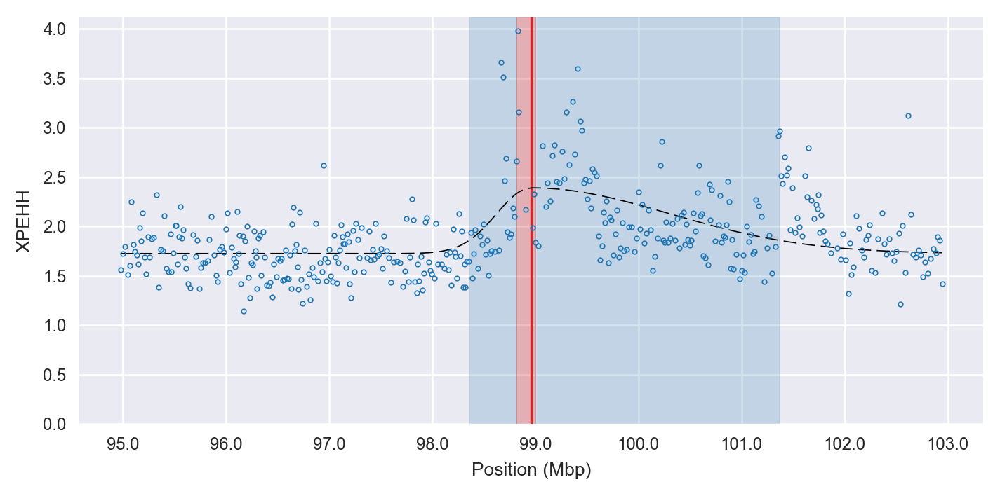

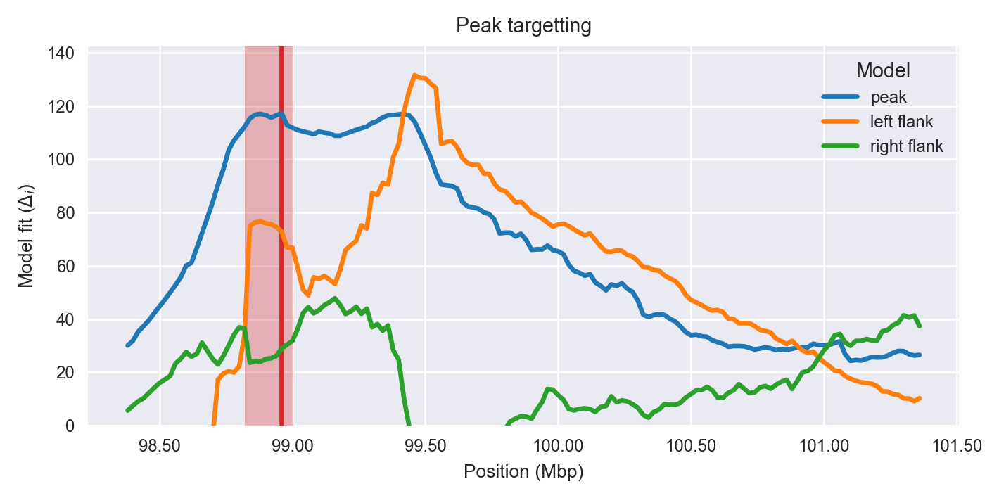

find the next peak
next peak: 793 78.4741
all done


In [27]:
peaks = peakfit.find_peaks(starts=starts, ends=ends, values=values, percentiles=percentiles, centers=centers, 
                           gflank=8, gmap=gmap['2'], fitters=[skewed_gauss_fitter], show_plots=True, statistic_label='XPEHH', 
                           log_file=None)
peaks = list(peaks)

In [28]:
87040000 - len(genome['2R'])

25494895

scan progress 0 2e-06
scan progress 100 4.00000199985
scan progress 200 8.00000200041
scan progress 300 12.000002001
scan progress 400 16.0000020015
scan progress 500 20.0000019985
scan progress 600 24.0000019955
scan progress 700 28.0000019925
scan progress 800 32.0000019896
scan progress 900 36.0000019937
scan progress 1000 40.0000019978
scan progress 1100 44.0000020019
scan progress 1200 48.000002006
scan progress 1300 52.0000020101
scan progress 1400 56.0000020142
scan progress 1500 60.0000020183
scan progress 1600 64.0000020224
scan progress 1700 68.0000020123
scan progress 1800 72.0000020023
scan progress 1900 76.0000019922
scan progress 2000 80.0000019821
scan progress 2100 84.000001972
scan progress 2200 88.0000019619
scan progress 2300 92.0000019518
scan progress 2400 96.0000019417
scan progress 2500 100.000001932
scan progress 2600 104.000001921
scan progress 2700 108.000001911
scan progress 2800 112.000001901
scan progress 2900 116.000001891
scan progress 3000 118.477165885


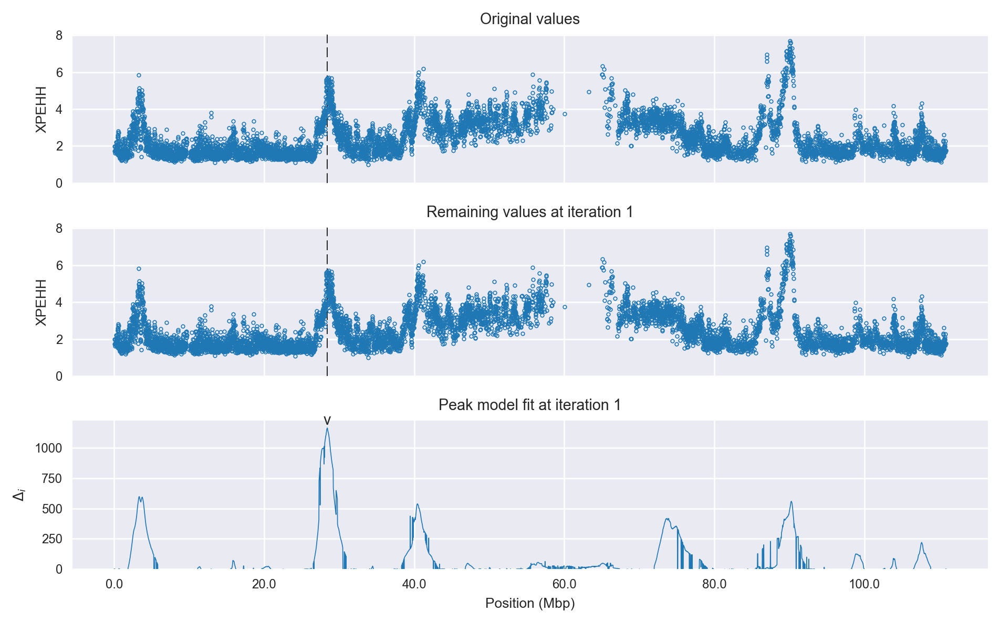

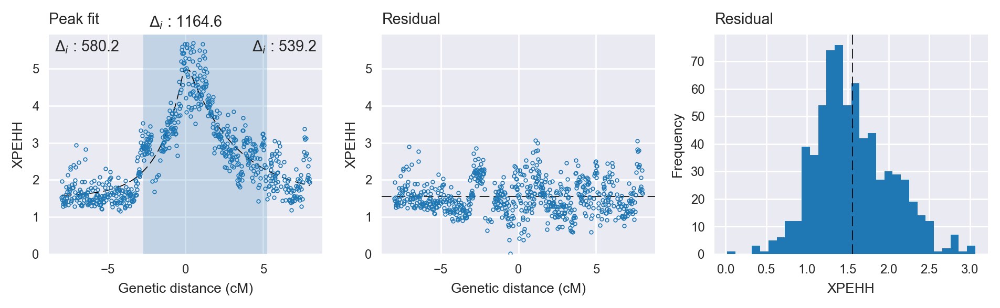

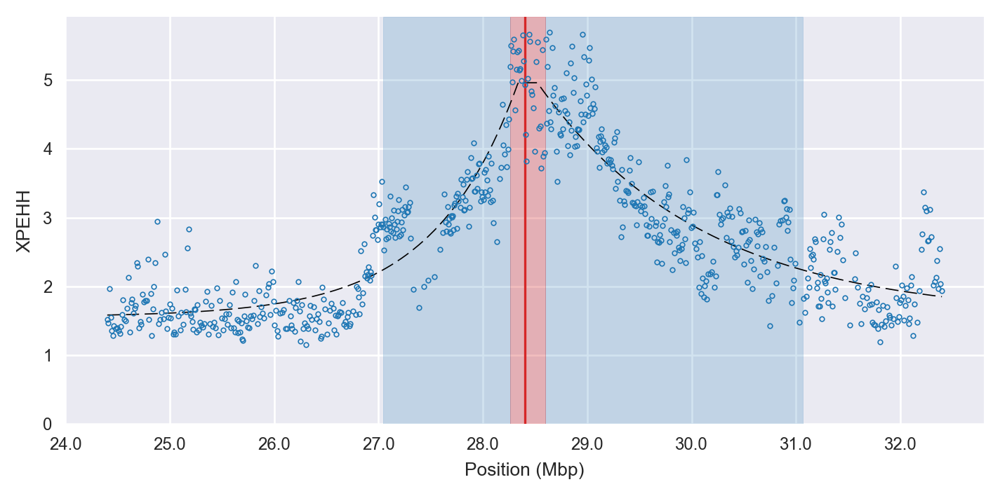

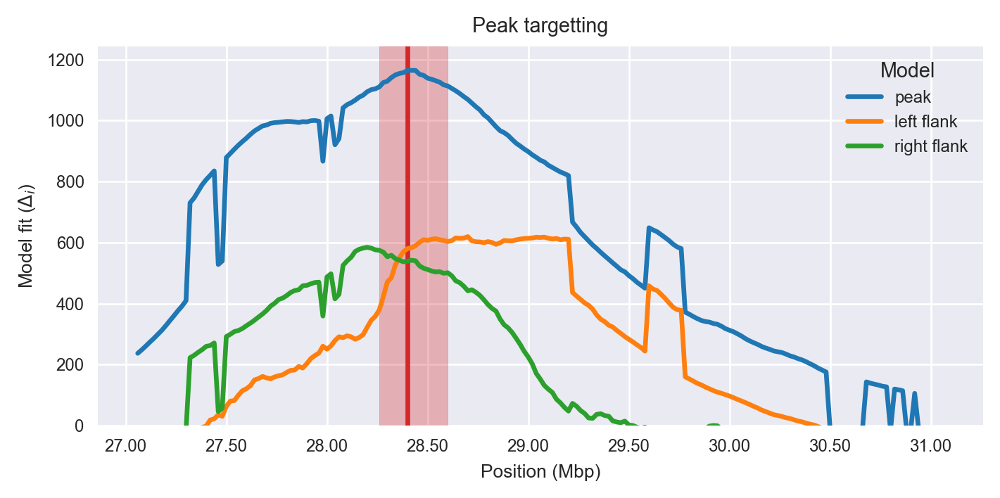

find the next peak
next peak: 167 598.84
Iteration 2
Peak center (index, location): 167, 3340001.0
Delta AIC: 598.8
Flank delta AICs: 283.7, 342.1
find limits of peak
peak limits: 2142499 4612721 108 232
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 33
    # data points      = 604
    # variables        = 5
    chi-square         = 153.417
    reduced chi-square = 0.256
    Akaike info crit   = -817.729
    Bayesian info crit = -795.711
[[Variables]]
    center:      0 (fixed)
    amplitude:   2.72591522 +/- 0        (0.00%) (init= 3)
    decay:       1.57028640 +/- 0        (0.00%) (init= 1)
    skew:       -0.08763226 +/- 0        (0.00%) (init= 0)
    baseline:    1.64622149 +/- 0        (0.00%) (init= 1)
    ceiling:     5          +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

[[Model]]
    Model(constant)
[[Fit Statistics]]
    # function evals   = 9
    # data points      = 603
    

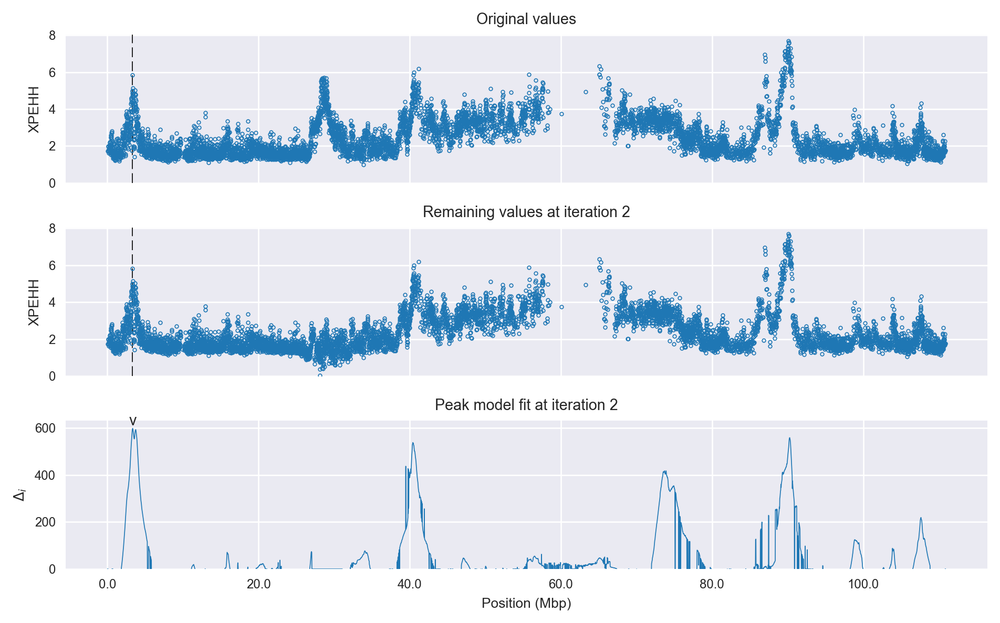

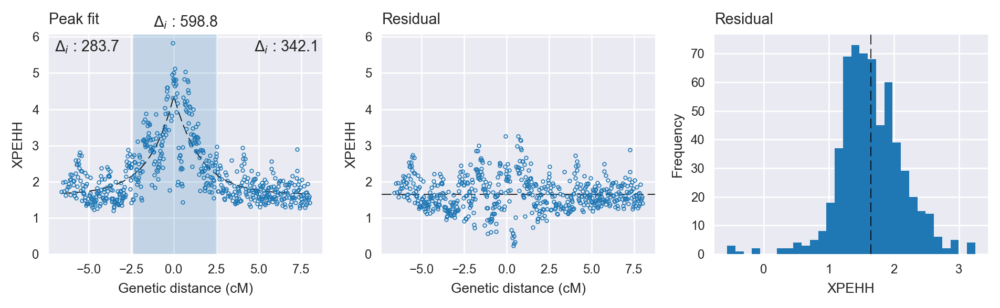

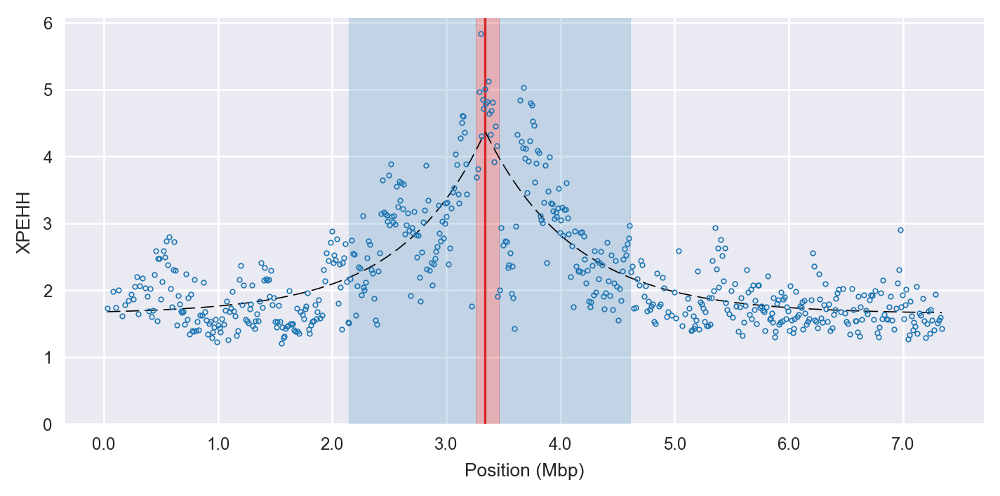

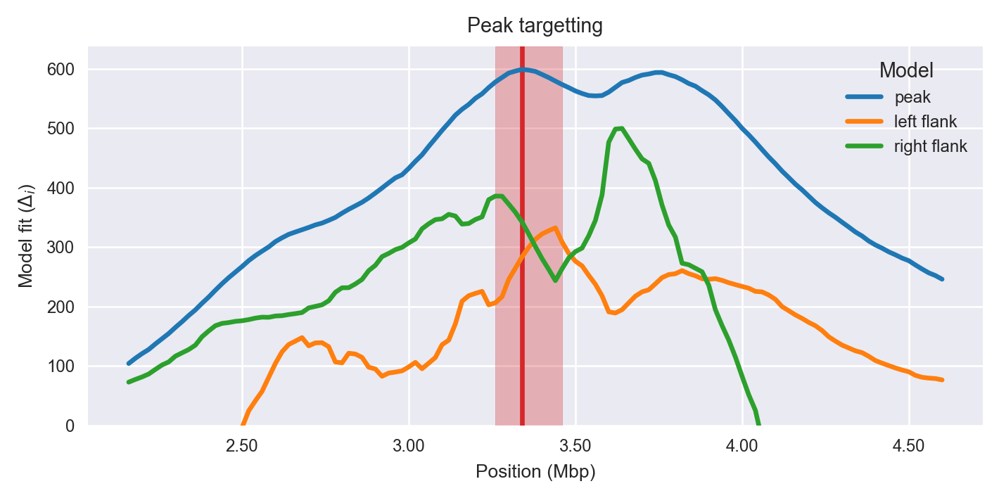

find the next peak
next peak: 4513 559.413
Iteration 3
Peak center (index, location): 4513, 90260001.0
Delta AIC: 559.4
Flank delta AICs: 135.8, 391.7
find limits of peak
peak limits: 87440148 90959785 4373 4549
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 132
    # data points      = 390
    # variables        = 5
    chi-square         = 267.659
    reduced chi-square = 0.695
    Akaike info crit   = -136.808
    Bayesian info crit = -116.978
[[Variables]]
    center:      0 (fixed)
    amplitude:   5.83145202 +/- 0.288887 (4.95%) (init= 3)
    decay:       0.78451270 +/- 0.076612 (9.77%) (init= 1)
    skew:        1.99999999 +/- 0.027343 (1.37%) (init= 0)
    baseline:    2.02491374 +/- 0.071390 (3.53%) (init= 1)
    ceiling:     6.90961269 +/- 0.170198 (2.46%) (init= 5)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(decay, skew)               =  0.672 
  

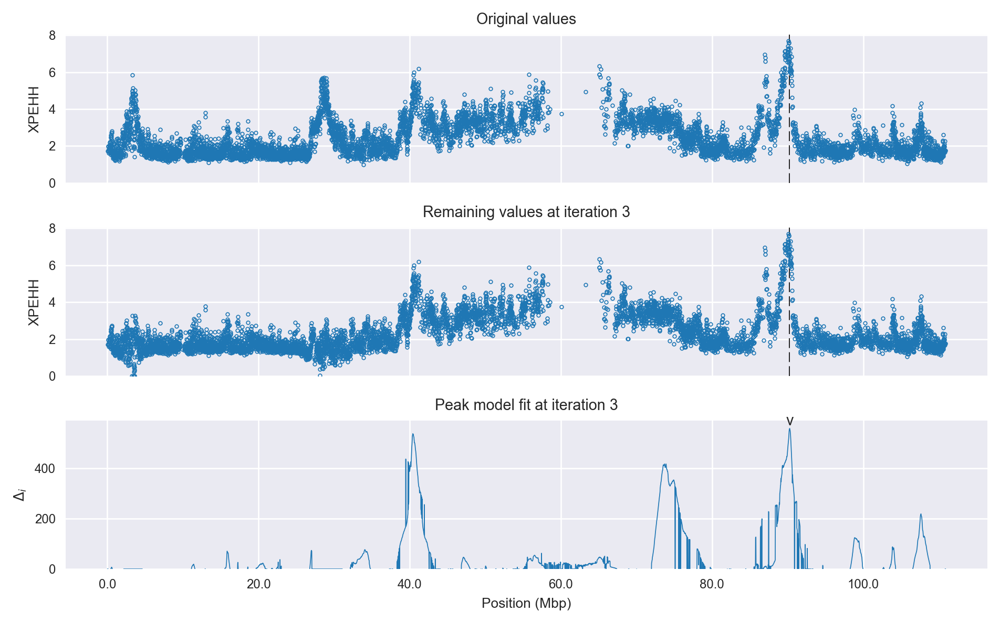

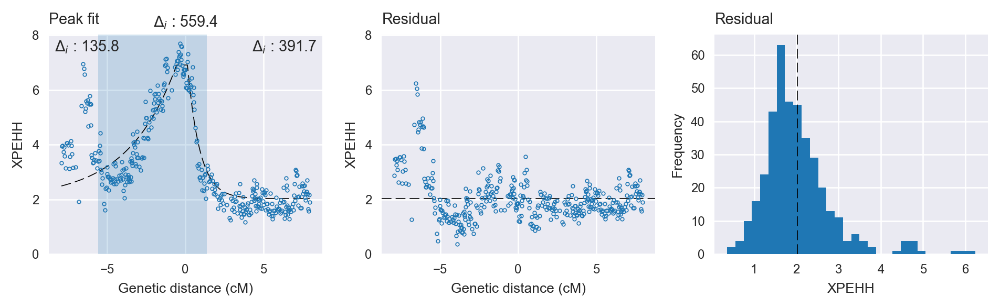

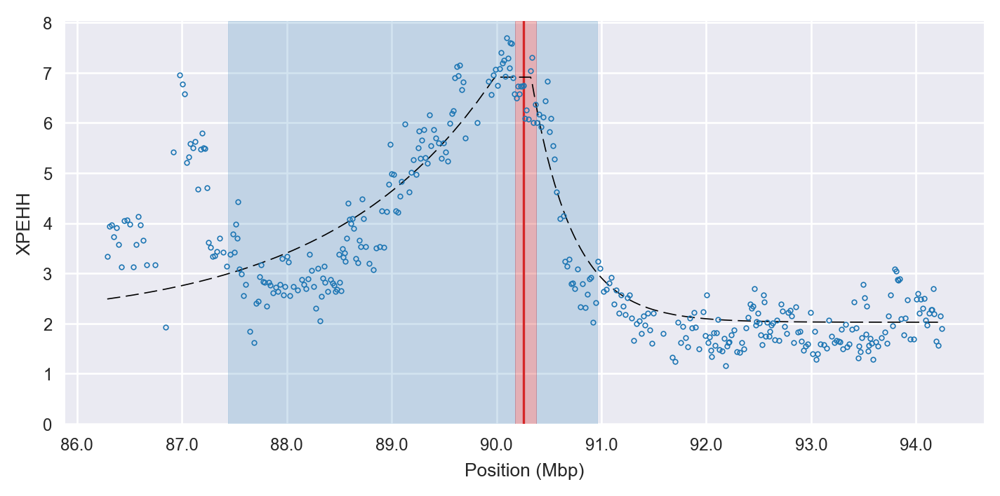

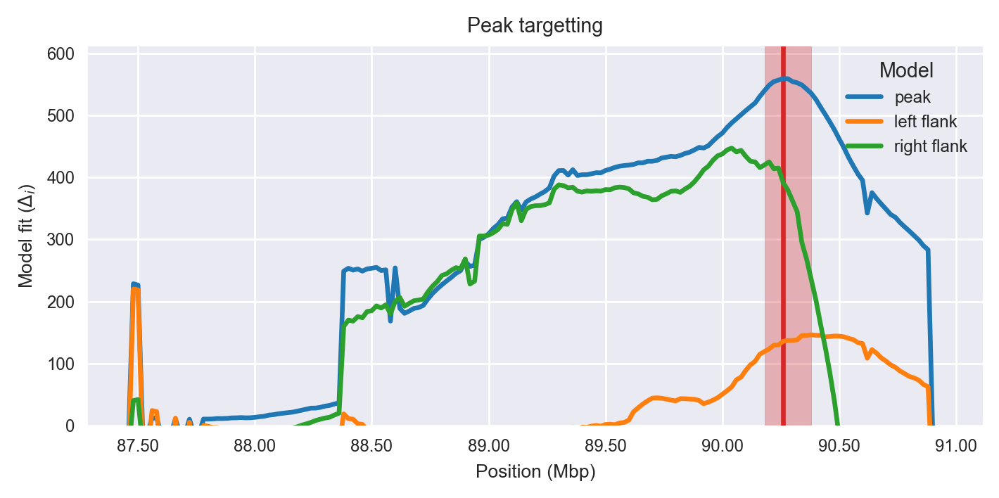

find the next peak
next peak: 2021 538.749
Iteration 4
Peak center (index, location): 2021, 40420001.0
Delta AIC: 538.7
Flank delta AICs: 200.7, 233.7
find limits of peak
peak limits: 39536345 43712144 1977 2187
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 89
    # data points      = 543
    # variables        = 5
    chi-square         = 189.127
    reduced chi-square = 0.352
    Akaike info crit   = -562.697
    Bayesian info crit = -541.212
[[Variables]]
    center:      0 (fixed)
    amplitude:   2.77041214 +/- 0.099023 (3.57%) (init= 3)
    decay:       3.99999993 +/- 0.120496 (3.01%) (init= 1)
    skew:       -1.90065498 +/- 0.112303 (5.91%) (init= 0)
    baseline:    2.27693988 +/- 0.051041 (2.24%) (init= 1)
    ceiling:     4.95622145 +/- 0.197635 (3.99%) (init= 5)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(decay, baseline)           =  0.607 
   

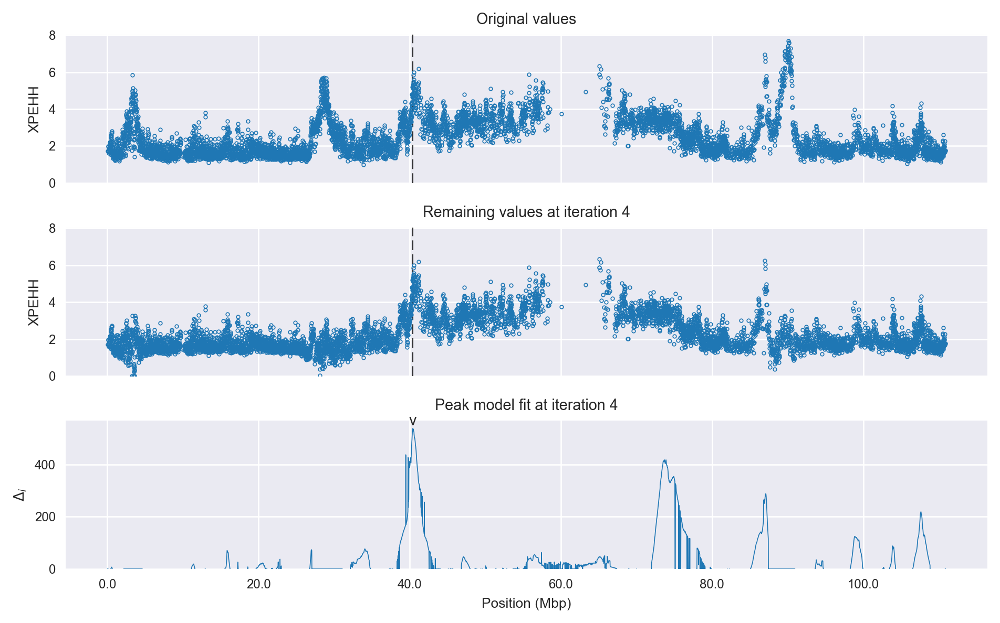

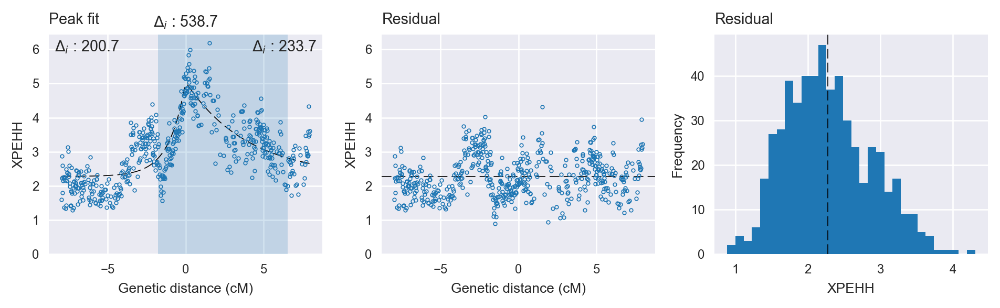

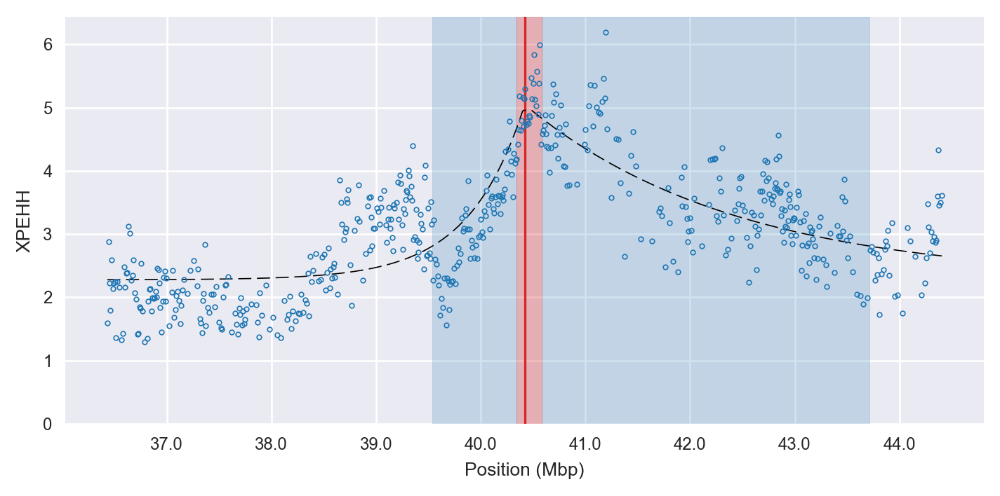

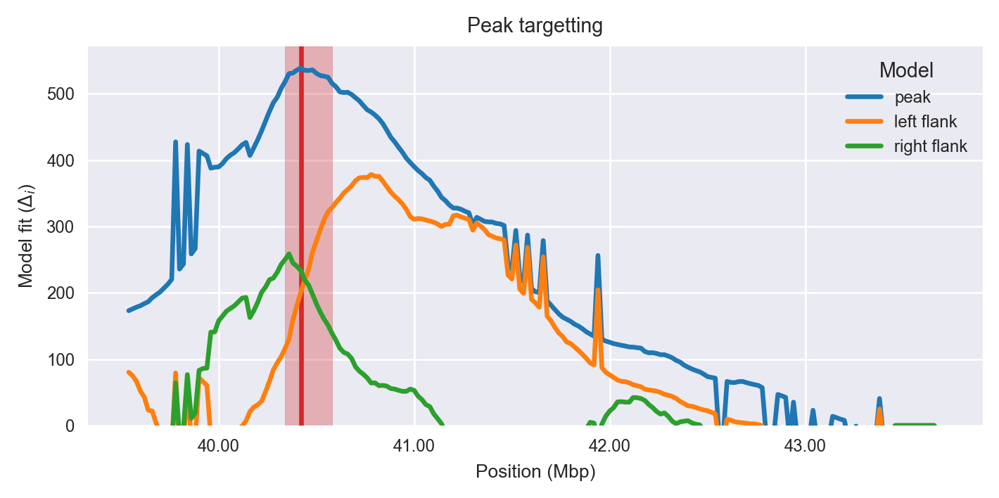

find the next peak
next peak: 3686 418.065
Iteration 5
Peak center (index, location): 3686, 73720001.0
Delta AIC: 418.1
Flank delta AICs: -39.2, 200.5
find limits of peak
peak limits: 69707649 76940575 3486 3849
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 136
    # data points      = 593
    # variables        = 5
    chi-square         = 100.905
    reduced chi-square = 0.172
    Akaike info crit   = -1040.212
    Bayesian info crit = -1018.286
[[Variables]]
    center:      0 (fixed)
    amplitude:   1.52395996 +/- 0        (0.00%) (init= 3)
    decay:       3.99999920 +/- 0        (0.00%) (init= 1)
    skew:        1.99999999 +/- 0        (0.00%) (init= 0)
    baseline:    2.16337208 +/- 0        (0.00%) (init= 1)
    ceiling:     5          +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

[[Model]]
    Model(constant)
[[Fit Statistics]]
    # func

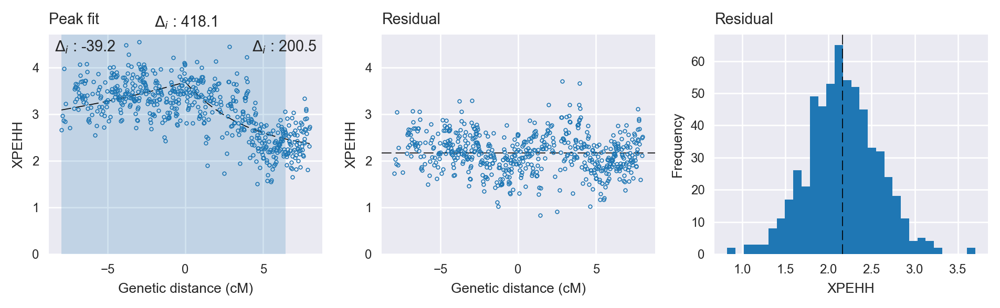

find the next peak
next peak: 4356 288.401
Iteration 5
Peak center (index, location): 4356, 87120001.0
Delta AIC: 288.4
Flank delta AICs: 201.7, 99.8
find limits of peak
peak limits: 85762660 87440147 4289 4374
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 121
    # data points      = 370
    # variables        = 5
    chi-square         = 126.311
    reduced chi-square = 0.346
    Akaike info crit   = -387.660
    Bayesian info crit = -368.092
[[Variables]]
    center:      0 (fixed)
    amplitude:   3.61997635 +/- 0.287019 (7.93%) (init= 3)
    decay:       0.38514342 +/- 0.056182 (14.59%) (init= 1)
    skew:        1.99997234 +/- 0.177021 (8.85%) (init= 0)
    baseline:    1.75482304 +/- 0.041023 (2.34%) (init= 1)
    ceiling:     4.88534663 +/- 0.240158 (4.92%) (init= 5)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(decay, skew)               = -0.739 
  

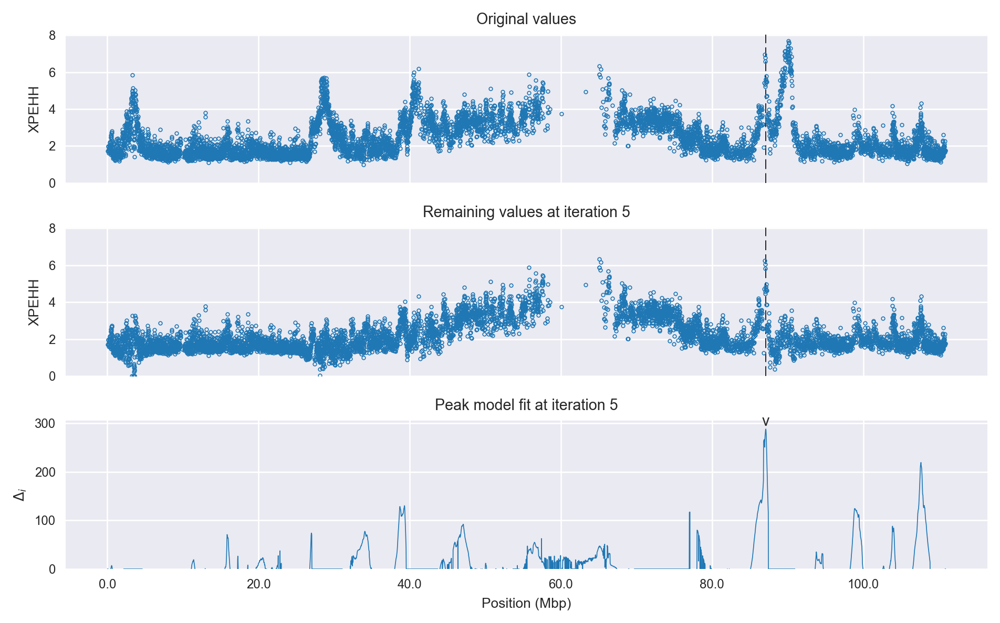

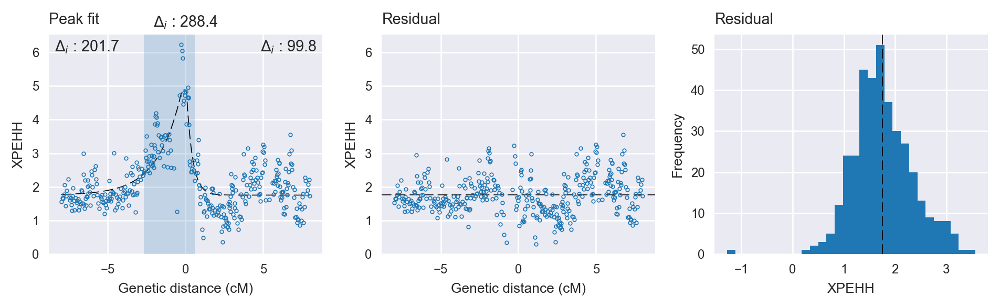

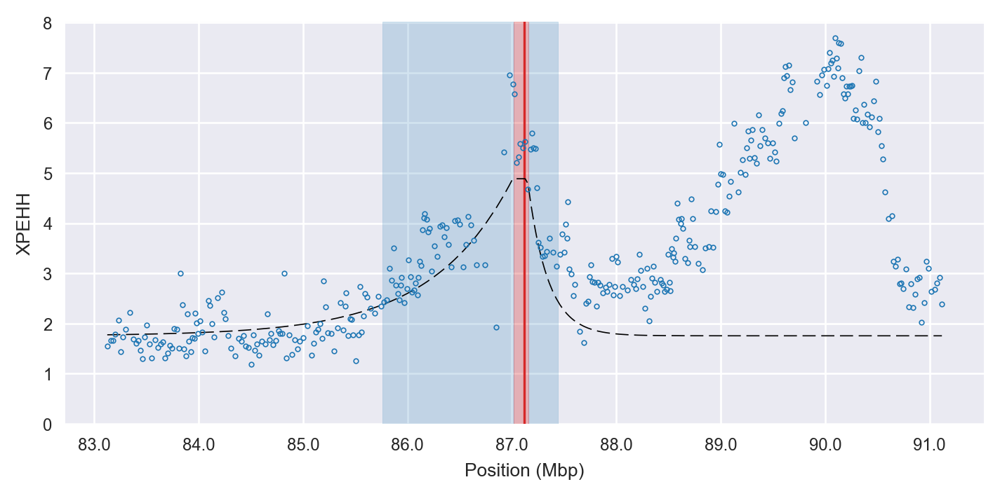

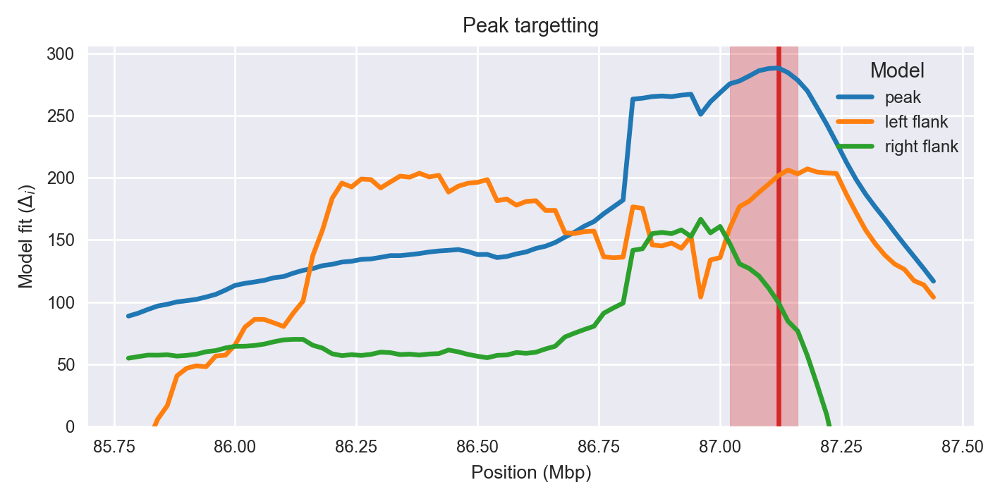

find the next peak
next peak: 5382 219.478
Iteration 6
Peak center (index, location): 5382, 107640001.0
Delta AIC: 219.5
Flank delta AICs: 81.7, 172.8
find limits of peak
peak limits: 107136879 107916208 5357 5397
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 45
    # data points      = 646
    # variables        = 5
    chi-square         = 128.543
    reduced chi-square = 0.201
    Akaike info crit   = -1032.990
    Bayesian info crit = -1010.636
[[Variables]]
    center:      0 (fixed)
    amplitude:   1.71014185 +/- 0        (0.00%) (init= 3)
    decay:       0.33551527 +/- 0        (0.00%) (init= 1)
    skew:        0.88726602 +/- 0        (0.00%) (init= 0)
    baseline:    1.78815053 +/- 0        (0.00%) (init= 1)
    ceiling:     5          +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

[[Model]]
    Model(constant)
[[Fit Statistics]]
    # function evals   = 9
    # data points    

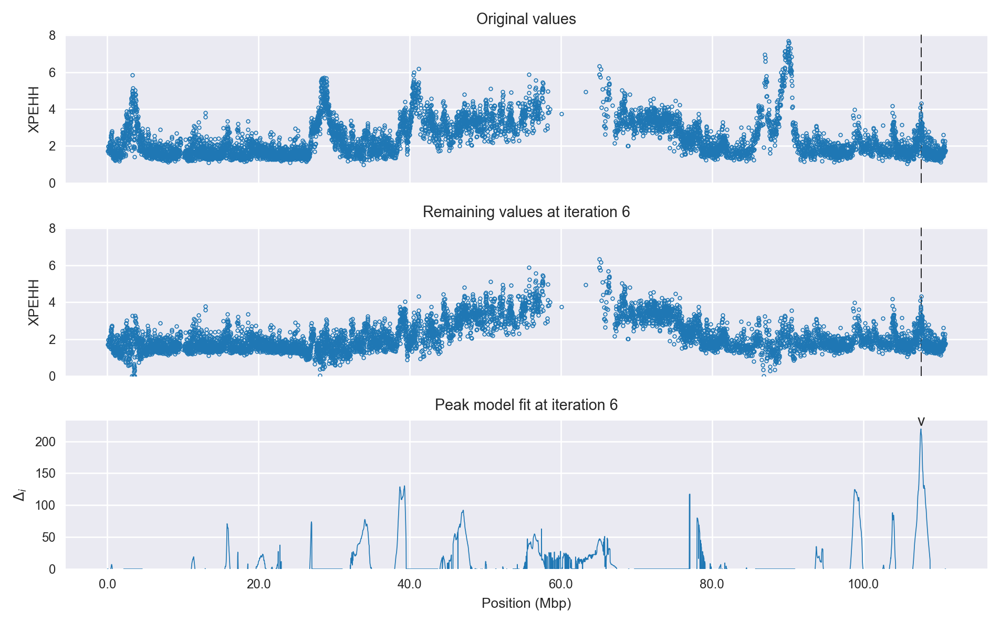

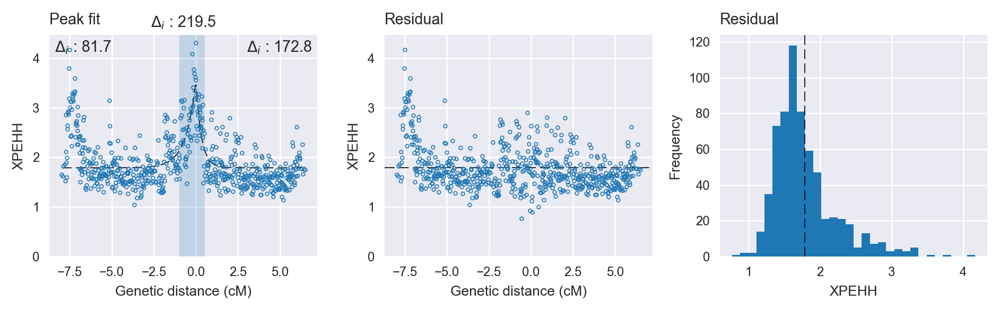

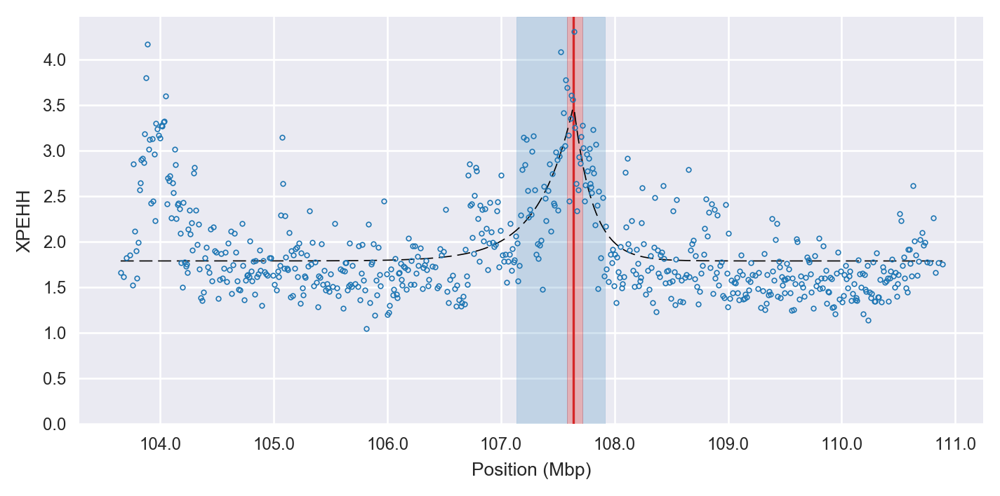

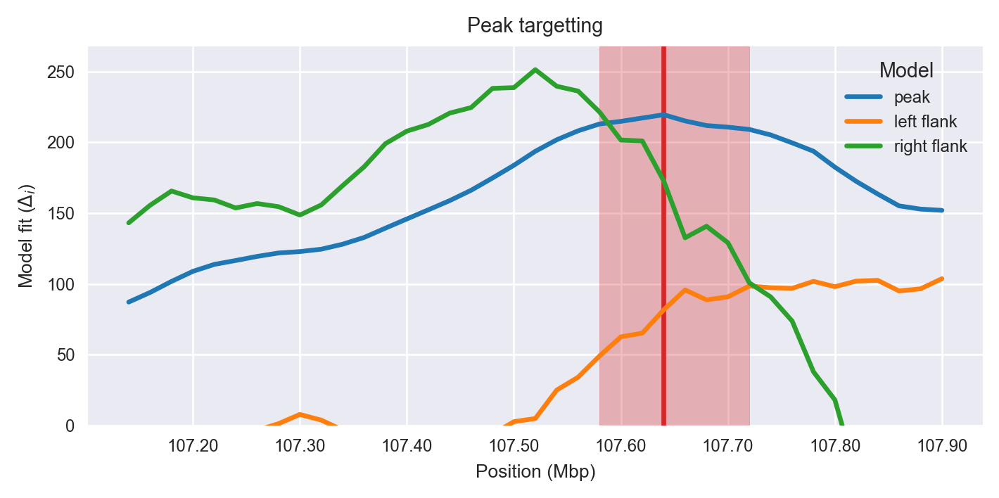

find the next peak
next peak: 5194 208.102
Iteration 7
Peak center (index, location): 5194, 103880001.0
Delta AIC: 208.1
Flank delta AICs: 42.8, 181.8
find limits of peak
peak limits: 103790887 104219880 5190 5212
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 69
    # data points      = 555
    # variables        = 5
    chi-square         = 75.303
    reduced chi-square = 0.137
    Akaike info crit   = -1098.580
    Bayesian info crit = -1076.985
[[Variables]]
    center:      0 (fixed)
    amplitude:   1.85009896 +/- 0        (0.00%) (init= 3)
    decay:       0.41880259 +/- 0        (0.00%) (init= 1)
    skew:       -1.96214227 +/- 0        (0.00%) (init= 0)
    baseline:    1.80574893 +/- 0        (0.00%) (init= 1)
    ceiling:     5          +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

[[Model]]
    Model(constant)
[[Fit Statistics]]
    # function evals   = 9
    # data points     

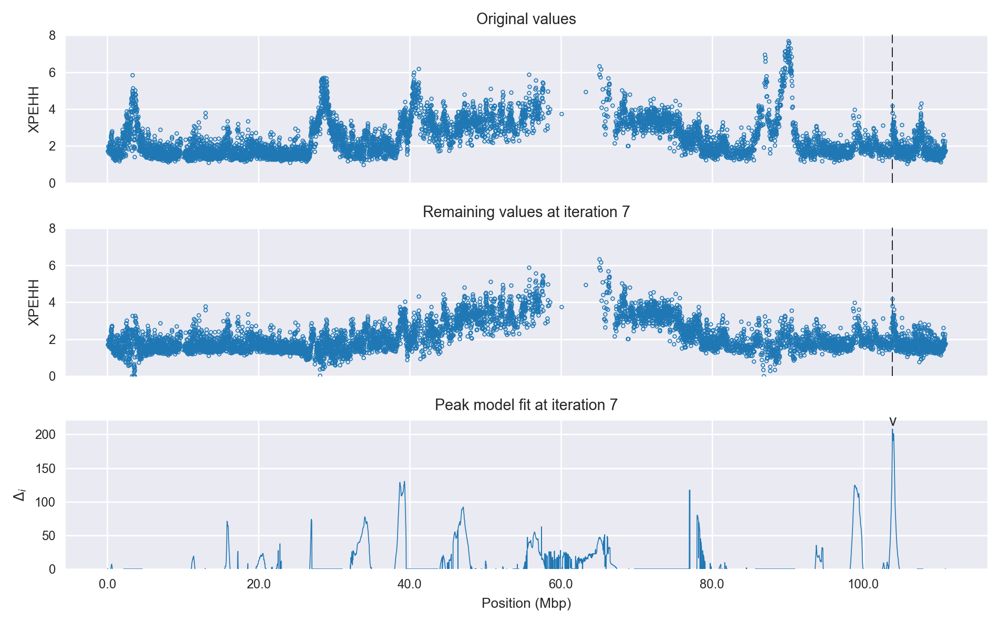

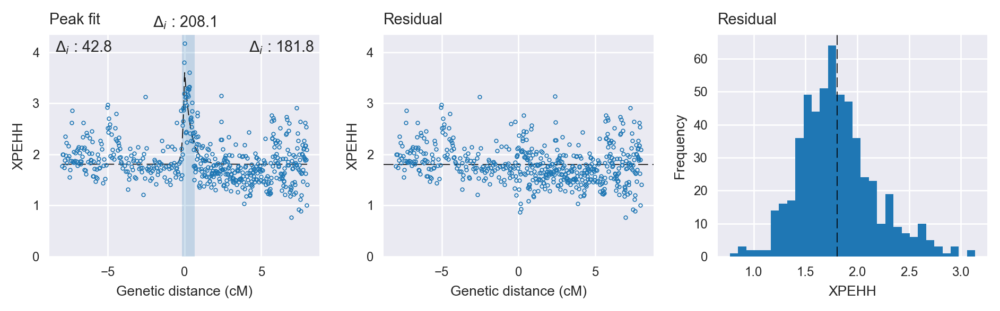

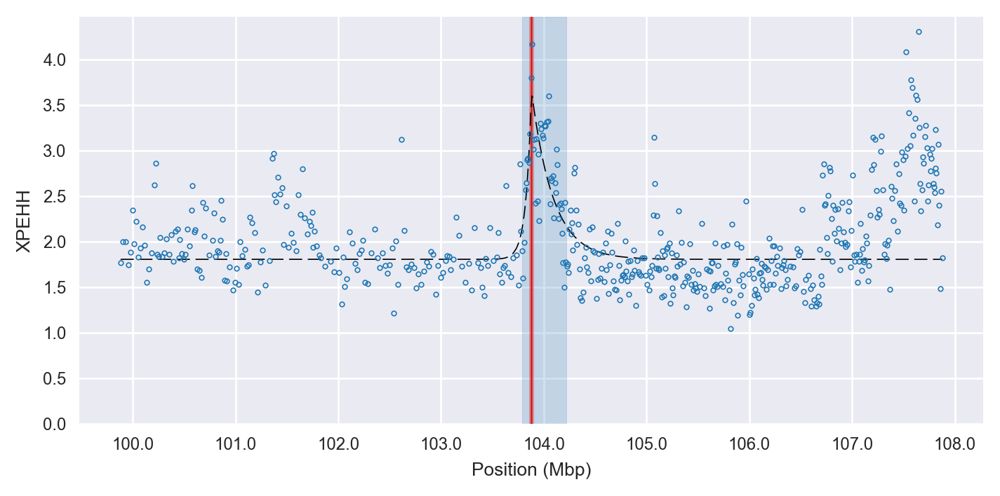

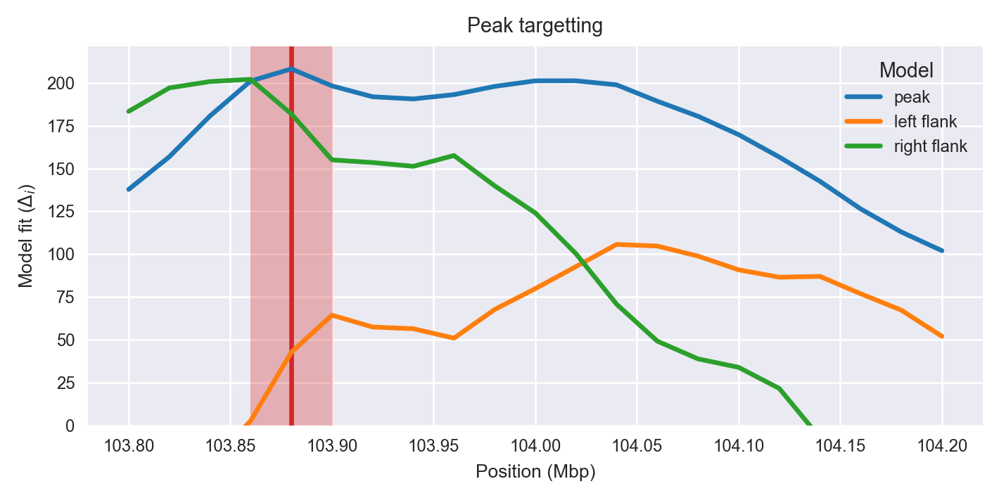

find the next peak
next peak: 1965 130.317
Iteration 8
Peak center (index, location): 1965, 39300001.0
Delta AIC: 130.3
Flank delta AICs: 148.2, 18.8
find limits of peak
peak limits: 38609761 39468267 1931 1975
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 115
    # data points      = 568
    # variables        = 5
    chi-square         = 145.380
    reduced chi-square = 0.258
    Akaike info crit   = -764.054
    Bayesian info crit = -742.343
[[Variables]]
    center:      0 (fixed)
    amplitude:   1.42918069 +/- 0        (0.00%) (init= 3)
    decay:       0.21083826 +/- 0        (0.00%) (init= 1)
    skew:        1.99999994 +/- 0        (0.00%) (init= 0)
    baseline:    2.11689280 +/- 0        (0.00%) (init= 1)
    ceiling:     5          +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

[[Model]]
    Model(constant)
[[Fit Statistics]]
    # functio

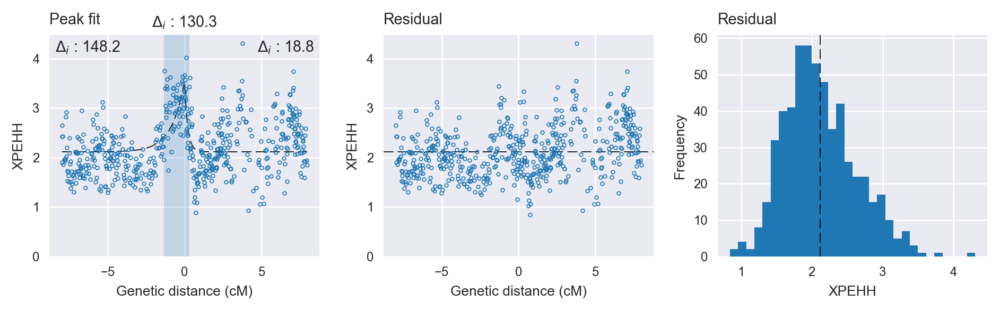

find the next peak
next peak: 4944 124.561
Iteration 8
Peak center (index, location): 4944, 98880001.0
Delta AIC: 124.6
Flank delta AICs: 74.5, 33.1
find limits of peak
peak limits: 98343543 101040992 4918 5054
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 87
    # data points      = 424
    # variables        = 5
    chi-square         = 47.288
    reduced chi-square = 0.113
    Akaike info crit   = -920.035
    Bayesian info crit = -899.787
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.95587053 +/- 0        (0.00%) (init= 3)
    decay:       2.64240722 +/- 0        (0.00%) (init= 1)
    skew:       -1.99999953 +/- 0        (0.00%) (init= 0)
    baseline:    1.71716064 +/- 0        (0.00%) (init= 1)
    ceiling:     5          +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

[[Model]]
    Model(constant)
[[Fit Statistics]]
    # function evals   = 9
    # data points      = 42

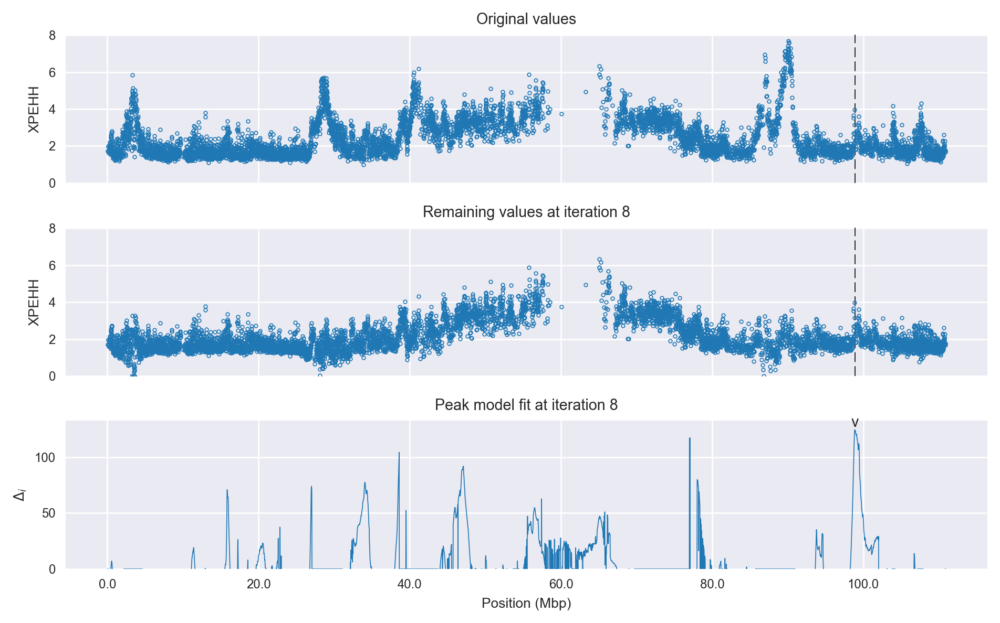

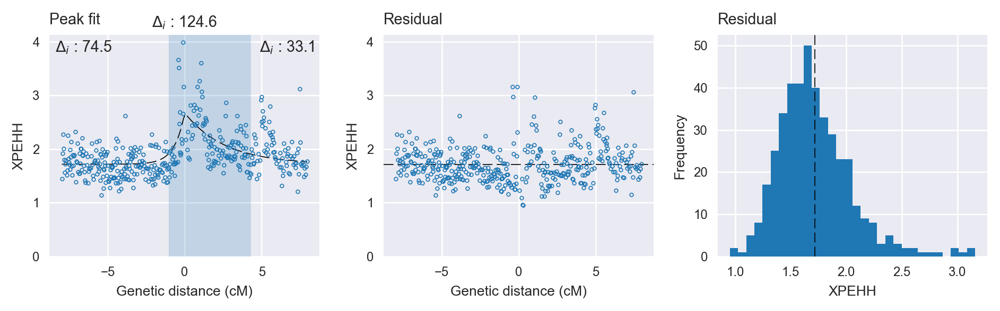

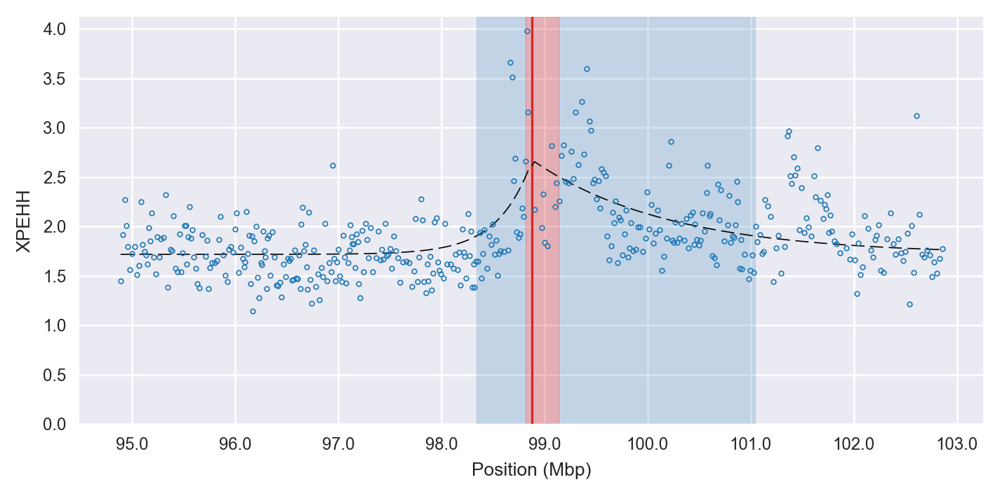

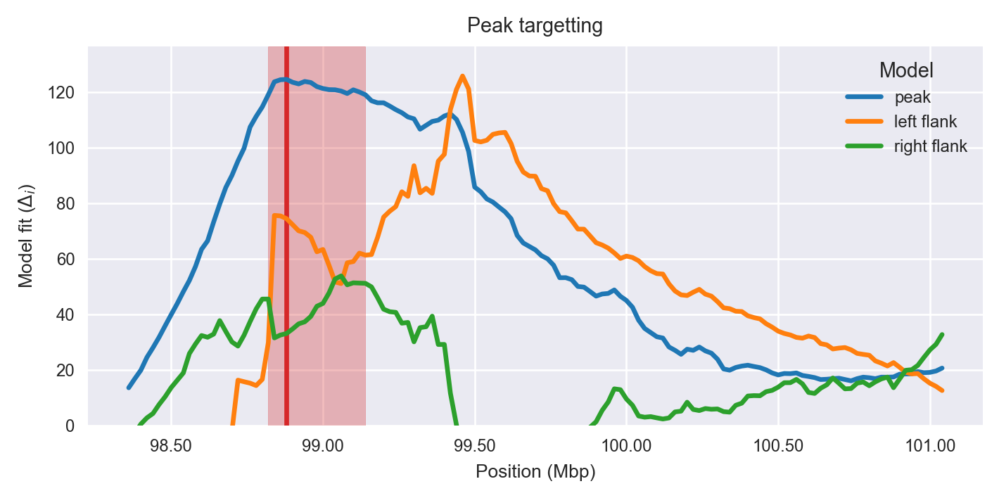

find the next peak
next peak: 3853 117.449
Iteration 9
Peak center (index, location): 3853, 77060001.0
Delta AIC: 117.4
Flank delta AICs: -125.1, 36.1
find limits of peak
peak limits: 73060899 80281083 3654 4016
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 320
    # data points      = 636
    # variables        = 5
    chi-square         = 242.428
    reduced chi-square = 0.384
    Akaike info crit   = -603.417
    Bayesian info crit = -581.141
[[Variables]]
    center:      0 (fixed)
    amplitude:   1.13378576 +/- 0        (0.00%) (init= 3)
    decay:       3.99999143 +/- 0        (0.00%) (init= 1)
    skew:        1.99999994 +/- 0        (0.00%) (init= 0)
    baseline:    1.83233366 +/- 0        (0.00%) (init= 1)
    ceiling:     5          +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

[[Model]]
    Model(constant)
[[Fit Statistics]]
    # functi

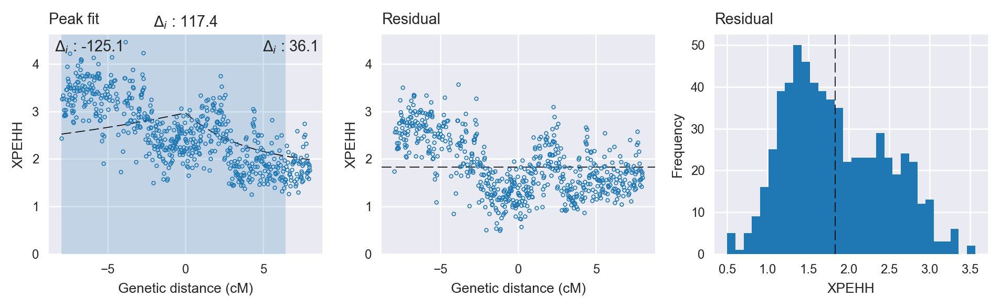

find the next peak
next peak: 1930 104.425
Iteration 9
Peak center (index, location): 1930, 38600001.0
Delta AIC: 104.4
Flank delta AICs: -27.6, 46.9
find limits of peak
peak limits: 38264501 39925023 1914 1998
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 76
    # data points      = 551
    # variables        = 5
    chi-square         = 142.072
    reduced chi-square = 0.260
    Akaike info crit   = -736.826
    Bayesian info crit = -715.267
[[Variables]]
    center:      0 (fixed)
    amplitude:   1.13328451 +/- 0        (0.00%) (init= 3)
    decay:       1.64051400 +/- 0        (0.00%) (init= 1)
    skew:       -2          +/- 0        (0.00%) (init= 0)
    baseline:    2.00552208 +/- 0        (0.00%) (init= 1)
    ceiling:     5          +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

[[Model]]
    Model(constant)
[[Fit Statistics]]
    # function

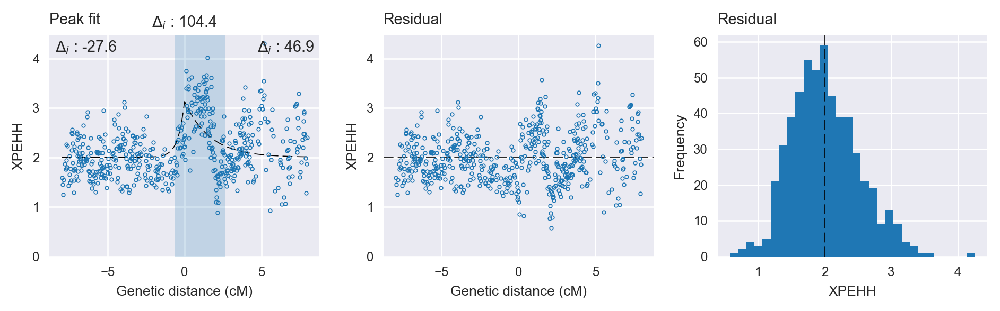

find the next peak
next peak: 2355 91.9543
Iteration 9
Peak center (index, location): 2355, 47100001.0
Delta AIC: 92.0
Flank delta AICs: 35.4, -49.1
find limits of peak
peak limits: 46296195 50280273 2315 2516
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 57
    # data points      = 510
    # variables        = 5
    chi-square         = 163.411
    reduced chi-square = 0.324
    Akaike info crit   = -570.452
    Bayesian info crit = -549.280
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.95655023 +/- 0        (0.00%) (init= 3)
    decay:       3.99999987 +/- 0        (0.00%) (init= 1)
    skew:       -1.99999988 +/- 0        (0.00%) (init= 0)
    baseline:    2.76715458 +/- 0        (0.00%) (init= 1)
    ceiling:     5          +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

[[Model]]
    Model(constant)
[[Fit Statistics]]
    # function 

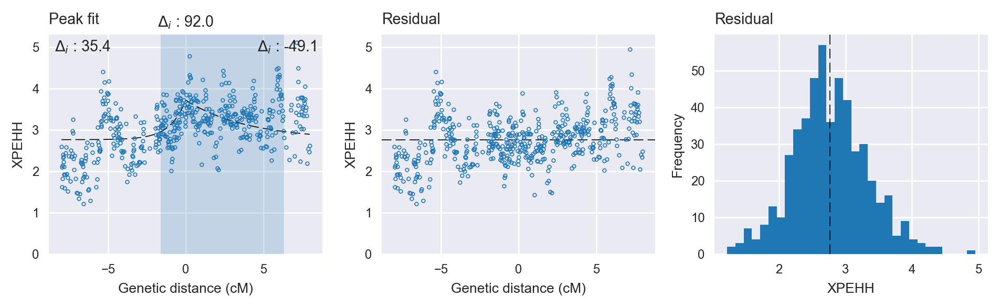

find the next peak
next peak: 1703 77.6305
all done


In [29]:
peaks = peakfit.find_peaks(starts=starts, ends=ends, values=values, percentiles=percentiles, centers=centers, 
                           gflank=8, gmap=gmap['2'], fitters=[skewed_exp_fitter], show_plots=True, statistic_label='XPEHH', 
                           log_file=None)
peaks = list(peaks)

scan progress 0 2e-06
not enough data points (0,) (330,)
not enough data points (0,) (330,)
not enough data points (0,) (332,)
not enough data points (0,) (332,)
not enough data points (1,) (333,)
not enough data points (1,) (333,)
not enough data points (1,) (335,)
not enough data points (1,) (335,)
not enough data points (2,) (336,)
not enough data points (2,) (336,)
not enough data points (2,) (337,)
not enough data points (2,) (337,)
could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 39
    # data points      = 384
    # variables        = 5
    chi-square         = 332.980
    reduced chi-square = 0.879
    Akaike info crit   = -44.743
    Bayesian info crit = -24.990
[[Variables]]
    center:      0 (fixed)
    amplitude:   2.96792762 +/- 0        (0.00%) (init= 3)
    decay:       0.05152647 +/- 0        (0.00%) (init= 1)
    skew:        0.59291595 +/- 0        (0.00%) (init= 0)
    baseline:    2.644553

/home/aliman/src/github/malariagen/agam-selection-atlas/deps/conda/envs/agam-selection-atlas/lib/python3.6/site-packages/lmfit/printfuncs.py:140: RuntimeWarning: invalid value encountered in double_scalars
  spercent = '({0:.2%})'.format(abs(par.stderr/par.value))


scan progress 1200 48.000002006
could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 57
    # data points      = 686
    # variables        = 5
    chi-square         = 967.877
    reduced chi-square = 1.421
    Akaike info crit   = 246.140
    Bayesian info crit = 268.795
[[Variables]]
    center:      0 (fixed)
    amplitude:   3.29883192 +/- 0        (0.00%) (init= 3)
    decay:       0.13458192 +/- 0        (0.00%) (init= 1)
    skew:       -1.44889072 +/- 0        (0.00%) (init= 0)
    baseline:    2.38060320 +/- 0        (0.00%) (init= 1)
    ceiling:     2.36413465 +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 47
    # data points      = 687
    # variables        = 5
    chi-square         = 971.239
    reduced chi-square = 1.424
    Akaike info crit   = 247.866
    Bay

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 56
    # data points      = 699
    # variables        = 5
    chi-square         = 976.293
    reduced chi-square = 1.407
    Akaike info crit   = 243.545
    Bayesian info crit = 266.293
[[Variables]]
    center:      0 (fixed)
    amplitude:   17.4076191 +/- 0        (0.00%) (init= 3)
    decay:       0.09702224 +/- 0        (0.00%) (init= 1)
    skew:       -1.53256525 +/- 0        (0.00%) (init= 0)
    baseline:    2.46453370 +/- 0        (0.00%) (init= 1)
    ceiling:     2.43220071 +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 83
    # data points      = 699
    # variables        = 5
    chi-square         = 975.453
    reduced chi-square = 1.406
    Akaike info crit   = 242.942
    Bayesian info crit = 265.691
[[Vari

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 155
    # data points      = 639
    # variables        = 5
    chi-square         = 735.041
    reduced chi-square = 1.159
    Akaike info crit   = 99.474
    Bayesian info crit = 121.773
[[Variables]]
    center:      0 (fixed)
    amplitude:   2.81131474 +/- 0        (0.00%) (init= 3)
    decay:       0.05188358 +/- 0        (0.00%) (init= 1)
    skew:        0.02575421 +/- 0        (0.00%) (init= 0)
    baseline:    2.65900423 +/- 0        (0.00%) (init= 1)
    ceiling:     2.65898397 +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 63
    # data points      = 639
    # variables        = 5
    chi-square         = 736.437
    reduced chi-square = 1.162
    Akaike info crit   = 100.686
    Bayesian info crit = 122.985
[[Vari

scan progress 1900 76.0000019922
could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 56
    # data points      = 552
    # variables        = 5
    chi-square         = 626.889
    reduced chi-square = 1.146
    Akaike info crit   = 80.227
    Bayesian info crit = 101.794
[[Variables]]
    center:      0 (fixed)
    amplitude:   3.63495014 +/- 0        (0.00%) (init= 3)
    decay:       0.06759074 +/- 0        (0.00%) (init= 1)
    skew:       -0.16267471 +/- 0        (0.00%) (init= 0)
    baseline:    2.77953143 +/- 0        (0.00%) (init= 1)
    ceiling:     2.77885197 +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 89
    # data points      = 551
    # variables        = 5
    chi-square         = 626.930
    reduced chi-square = 1.148
    Akaike info crit   = 81.134
    Baye

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 42
    # data points      = 536
    # variables        = 5
    chi-square         = 327.801
    reduced chi-square = 0.617
    Akaike info crit   = -253.566
    Bayesian info crit = -232.145
[[Variables]]
    center:      0 (fixed)
    amplitude:   3.25682948 +/- 0        (0.00%) (init= 3)
    decay:       0.07911920 +/- 0        (0.00%) (init= 1)
    skew:        1.12908817 +/- 0        (0.00%) (init= 0)
    baseline:    3.41746506 +/- 0        (0.00%) (init= 1)
    ceiling:     3.37226740 +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 35
    # data points      = 536
    # variables        = 5
    chi-square         = 326.003
    reduced chi-square = 0.614
    Akaike info crit   = -256.515
    Bayesian info crit = -235.094
[[

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 125
    # data points      = 529
    # variables        = 5
    chi-square         = 322.293
    reduced chi-square = 0.615
    Akaike info crit   = -252.134
    Bayesian info crit = -230.779
[[Variables]]
    center:      0 (fixed)
    amplitude:   3.74061211 +/- 0        (0.00%) (init= 3)
    decay:       0.05003104 +/- 0        (0.00%) (init= 1)
    skew:       -1.93203868 +/- 0        (0.00%) (init= 0)
    baseline:    3.38631696 +/- 0        (0.00%) (init= 1)
    ceiling:     3.38631337 +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 55
    # data points      = 515
    # variables        = 5
    chi-square         = 184.954
    reduced chi-square = 0.363
    Akaike info crit   = -517.392
    Bayesian info crit = -496.171
[

could not find peak limits 247 247
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 57
    # data points      = 535
    # variables        = 4
    chi-square         = 148.556
    reduced chi-square = 0.280
    Akaike info crit   = -677.497
    Bayesian info crit = -660.368
[[Variables]]
    center:      0 (fixed)
    amplitude:   1.8597e-06 +/- 0        (0.00%) (init= 3)
    sigma:       0.06155831 +/- 0        (0.00%) (init= 1)
    skew:       -1.99993589 +/- 0        (0.00%) (init= 0)
    baseline:    3.15693846 +/- 0        (0.00%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)

could not find peak limits 247 247
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 46
    # data points      = 537
    # variables        = 4
    chi-square         = 149.069
    reduced chi-square = 0.280
    Akaike info crit   = -680.212
    Bayesian info crit = -663.068
[[Variables]]
    center:      0 (fixed)
    amplitu

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 55
    # data points      = 375
    # variables        = 5
    chi-square         = 162.654
    reduced chi-square = 0.440
    Akaike info crit   = -303.238
    Bayesian info crit = -283.604
[[Variables]]
    center:      0 (fixed)
    amplitude:   2.03238535 +/- 0        (0.00%) (init= 3)
    decay:       0.33632264 +/- 0        (0.00%) (init= 1)
    skew:       -0.98457715 +/- 0        (0.00%) (init= 0)
    baseline:    3.61950539 +/- 0        (0.00%) (init= 1)
    ceiling:     3.59219341 +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 38
    # data points      = 375
    # variables        = 5
    chi-square         = 161.700
    reduced chi-square = 0.437
    Akaike info crit   = -305.444
    Bayesian info crit = -285.809
[[

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 39
    # data points      = 345
    # variables        = 5
    chi-square         = 149.680
    reduced chi-square = 0.440
    Akaike info crit   = -278.090
    Bayesian info crit = -258.872
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.00671907 +/- 0        (0.00%) (init= 3)
    decay:       1.57050538 +/- 0        (0.00%) (init= 1)
    skew:       -1.64427542 +/- 0        (0.00%) (init= 0)
    baseline:    3.64384906 +/- 0        (0.00%) (init= 1)
    ceiling:     3.60641739 +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 39
    # data points      = 343
    # variables        = 5
    chi-square         = 149.561
    reduced chi-square = 0.442
    Akaike info crit   = -274.700
    Bayesian info crit = -255.511
[[

scan progress 2900 116.000001891
could not find peak limits 154 154
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 48
    # data points      = 183
    # variables        = 4
    chi-square         = 100.258
    reduced chi-square = 0.560
    Akaike info crit   = -102.118
    Bayesian info crit = -89.280
[[Variables]]
    center:      0 (fixed)
    amplitude:   2.7804e-12 +/- 0        (0.00%) (init= 3)
    sigma:       0.05948821 +/- 0        (0.00%) (init= 1)
    skew:        1.83812173 +/- 0        (0.00%) (init= 0)
    baseline:    3.94615242 +/- 0        (0.00%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)

could not find peak limits 153 153
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 37
    # data points      = 182
    # variables        = 4
    chi-square         = 99.435
    reduced chi-square = 0.559
    Akaike info crit   = -102.020
    Bayesian info crit = -89.204
[[Variables]]
    cent

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 49
    # data points      = 177
    # variables        = 5
    chi-square         = 121.923
    reduced chi-square = 0.709
    Akaike info crit   = -55.978
    Bayesian info crit = -40.098
[[Variables]]
    center:      0 (fixed)
    amplitude:   46.4877770 +/- 0        (0.00%) (init= 3)
    decay:       0.05230027 +/- 0        (0.00%) (init= 1)
    skew:        1.72883657 +/- 0        (0.00%) (init= 0)
    baseline:    3.99992632 +/- 0        (0.00%) (init= 1)
    ceiling:     3.99865107 +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 27
    # data points      = 177
    # variables        = 5
    chi-square         = 122.192
    reduced chi-square = 0.710
    Akaike info crit   = -55.589
    Bayesian info crit = -39.708
[[Vari

could not find peak limits None None
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 29
    # data points      = 173
    # variables        = 4
    chi-square         = 122.676
    reduced chi-square = 0.726
    Akaike info crit   = -51.468
    Bayesian info crit = -38.855
[[Variables]]
    center:      0 (fixed)
    amplitude:   6.79594684 +/- 0        (0.00%) (init= 3)
    sigma:       0.12910713 +/- 0        (0.00%) (init= 1)
    skew:       -1.91862015 +/- 0        (0.00%) (init= 0)
    baseline:    3.98979487 +/- 0        (0.00%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)

could not find peak limits 98 98
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 49
    # data points      = 175
    # variables        = 4
    chi-square         = 123.278
    reduced chi-square = 0.721
    Akaike info crit   = -53.310
    Bayesian info crit = -40.651
[[Variables]]
    center:      0 (fixed)
    amplitude: 

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 27
    # data points      = 183
    # variables        = 5
    chi-square         = 124.219
    reduced chi-square = 0.698
    Akaike info crit   = -60.902
    Bayesian info crit = -44.854
[[Variables]]
    center:      0 (fixed)
    amplitude:   6.28209388 +/- 0        (0.00%) (init= 3)
    decay:       1.47240795 +/- 0        (0.00%) (init= 1)
    skew:       -1.47494899 +/- 0        (0.00%) (init= 0)
    baseline:    4.06110076 +/- 0        (0.00%) (init= 1)
    ceiling:     3.98948851 +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 27
    # data points      = 183
    # variables        = 5
    chi-square         = 124.219
    reduced chi-square = 0.698
    Akaike info crit   = -60.902
    Bayesian info crit = -44.854
[[Vari

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 33
    # data points      = 188
    # variables        = 5
    chi-square         = 125.629
    reduced chi-square = 0.686
    Akaike info crit   = -65.784
    Bayesian info crit = -49.602
[[Variables]]
    center:      0 (fixed)
    amplitude:   145.711408 +/- 0        (0.00%) (init= 3)
    decay:       0.07663096 +/- 0        (0.00%) (init= 1)
    skew:       -1.71728685 +/- 0        (0.00%) (init= 0)
    baseline:    4.21922055 +/- 0        (0.00%) (init= 1)
    ceiling:     3.98496336 +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 38
    # data points      = 188
    # variables        = 5
    chi-square         = 125.629
    reduced chi-square = 0.686
    Akaike info crit   = -65.784
    Bayesian info crit = -49.602
[[Vari

could not find peak limits 86 86
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 42
    # data points      = 200
    # variables        = 4
    chi-square         = 122.990
    reduced chi-square = 0.628
    Akaike info crit   = -89.242
    Bayesian info crit = -76.049
[[Variables]]
    center:      0 (fixed)
    amplitude:   1.30831942 +/- 0        (0.00%) (init= 3)
    sigma:       0.23045776 +/- 0        (0.00%) (init= 1)
    skew:       -1.59074188 +/- 0        (0.00%) (init= 0)
    baseline:    3.97751895 +/- 0        (0.00%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)

could not find peak limits 86 86
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 43
    # data points      = 200
    # variables        = 4
    chi-square         = 122.990
    reduced chi-square = 0.628
    Akaike info crit   = -89.242
    Bayesian info crit = -76.049
[[Variables]]
    center:      0 (fixed)
    amplitude:   2.

could not find peak limits 174 174
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 55
    # data points      = 459
    # variables        = 4
    chi-square         = 124.913
    reduced chi-square = 0.275
    Akaike info crit   = -589.359
    Bayesian info crit = -572.843
[[Variables]]
    center:      0 (fixed)
    amplitude:   1.1652e-07 +/- 0        (0.00%) (init= 3)
    sigma:       0.05004207 +/- 0        (0.00%) (init= 1)
    skew:       -0.16291985 +/- 0        (0.00%) (init= 0)
    baseline:    3.49471386 +/- 0        (0.00%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)

scan progress 3500 130.834638884
could not find peak limits 173 173
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 51
    # data points      = 464
    # variables        = 5
    chi-square         = 123.084
    reduced chi-square = 0.268
    Akaike info crit   = -605.735
    Bayesian info crit = -585.036
[[Variables

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 77
    # data points      = 366
    # variables        = 5
    chi-square         = 643.230
    reduced chi-square = 1.782
    Akaike info crit   = 216.376
    Bayesian info crit = 235.889
[[Variables]]
    center:      0 (fixed)
    amplitude:   9.76490948 +/- 0        (0.00%) (init= 3)
    decay:       0.05412781 +/- 0        (0.00%) (init= 1)
    skew:       -1.85889188 +/- 0        (0.00%) (init= 0)
    baseline:    2.80999775 +/- 0        (0.00%) (init= 1)
    ceiling:     2.80999562 +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 68
    # data points      = 365
    # variables        = 5
    chi-square         = 657.458
    reduced chi-square = 1.826
    Akaike info crit   = 224.796
    Bayesian info crit = 244.296
[[Vari

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 40
    # data points      = 363
    # variables        = 5
    chi-square         = 1129.472
    reduced chi-square = 3.155
    Akaike info crit   = 422.042
    Bayesian info crit = 441.514
[[Variables]]
    center:      0 (fixed)
    amplitude:   6.45429009 +/- 0        (0.00%) (init= 3)
    decay:       0.25667580 +/- 0        (0.00%) (init= 1)
    skew:        1.77055859 +/- 0        (0.00%) (init= 0)
    baseline:    3.57821632 +/- 0        (0.00%) (init= 1)
    ceiling:     3.46442578 +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 49
    # data points      = 363
    # variables        = 5
    chi-square         = 1125.247
    reduced chi-square = 3.143
    Akaike info crit   = 420.682
    Bayesian info crit = 440.154
[[Va


could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 39
    # data points      = 422
    # variables        = 5
    chi-square         = 1267.779
    reduced chi-square = 3.040
    Akaike info crit   = 474.207
    Bayesian info crit = 494.432
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.50564305 +/- 0        (0.00%) (init= 3)
    decay:       0.05871349 +/- 0        (0.00%) (init= 1)
    skew:        1.97920916 +/- 0        (0.00%) (init= 0)
    baseline:    3.07682254 +/- 0        (0.00%) (init= 1)
    ceiling:     2.85190585 +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 41
    # data points      = 422
    # variables        = 5
    chi-square         = 1269.340
    reduced chi-square = 3.044
    Akaike info crit   = 474.726
    Bayesian info crit = 494.951
[[V

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 135
    # data points      = 425
    # variables        = 5
    chi-square         = 1287.456
    reduced chi-square = 3.065
    Akaike info crit   = 481.042
    Bayesian info crit = 501.303
[[Variables]]
    center:      0 (fixed)
    amplitude:   20.8164424 +/- 0        (0.00%) (init= 3)
    decay:       0.05091582 +/- 0        (0.00%) (init= 1)
    skew:       -0.03701958 +/- 0        (0.00%) (init= 0)
    baseline:    2.72099210 +/- 0        (0.00%) (init= 1)
    ceiling:     2.72097771 +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 133
    # data points      = 426
    # variables        = 5
    chi-square         = 1287.912
    reduced chi-square = 3.059
    Akaike info crit   = 481.300
    Bayesian info crit = 501.572
[[

[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 40
    # data points      = 434
    # variables        = 5
    chi-square         = 1193.581
    reduced chi-square = 2.782
    Akaike info crit   = 449.064
    Bayesian info crit = 469.430
[[Variables]]
    center:      0 (fixed)
    amplitude:   3.81175721 +/- 0        (0.00%) (init= 3)
    decay:       0.05193379 +/- 0        (0.00%) (init= 1)
    skew:       -0.74229773 +/- 0        (0.00%) (init= 0)
    baseline:    2.58954292 +/- 0        (0.00%) (init= 1)
    ceiling:     2.55621030 +/- 0        (0.00%) (init= 5)
    floor:       0 (fixed)

could not find peak limits None None
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 56
    # data points      = 434
    # variables        = 5
    chi-square         = 1187.021
    reduced chi-square = 2.767
    Akaike info crit   = 446.672
    Bayesian info crit = 467.037
[[Variables]]
    center:      0 (fixed)


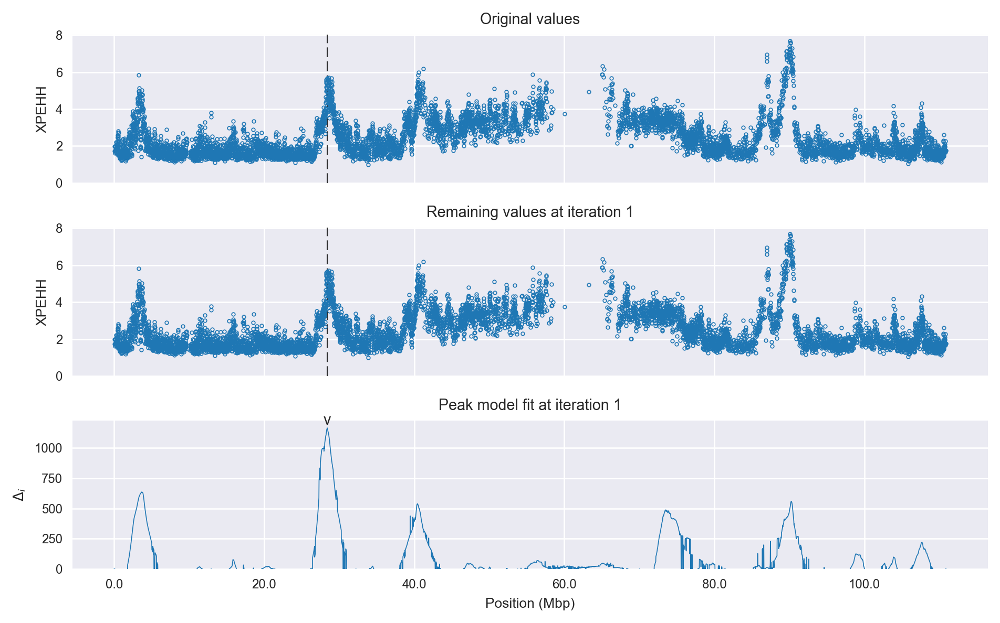

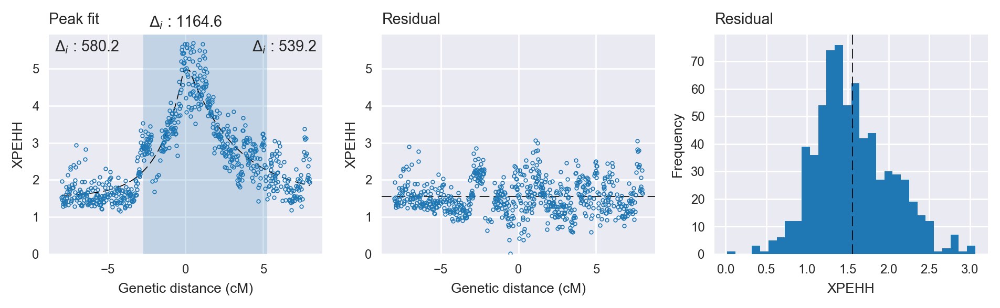

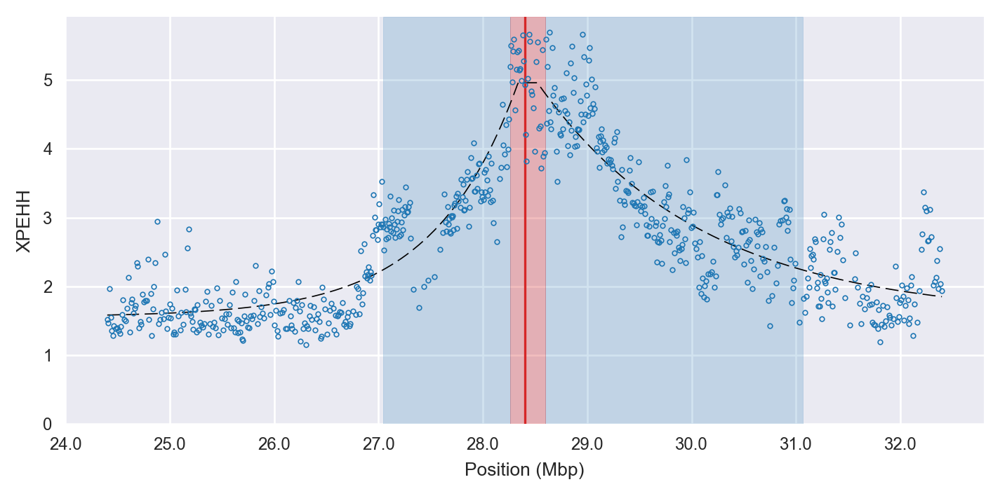

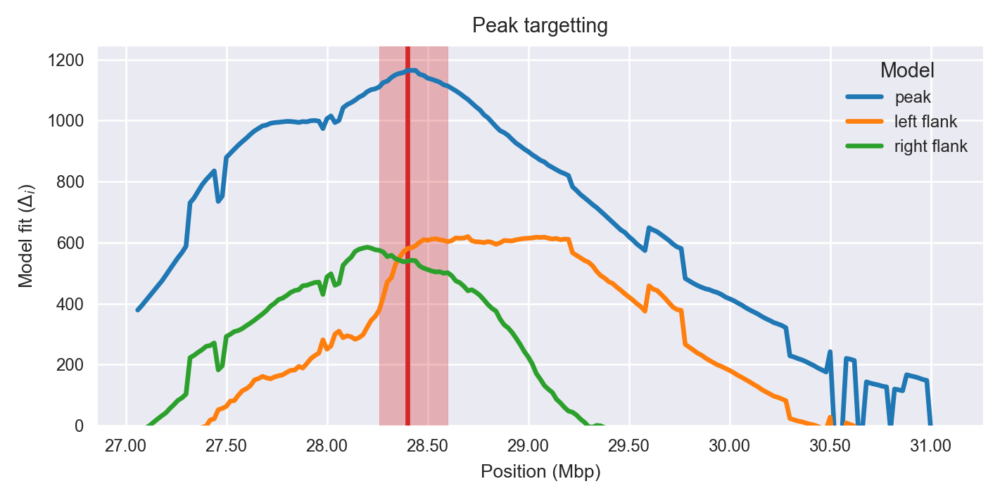

find the next peak
next peak: 185 635.907
Iteration 2
Peak center (index, location): 185, 3700001.0
Delta AIC: 635.9
Flank delta AICs: 262.8, 414.3
find limits of peak
peak limits: 2067270 4327125 104 218
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 43
    # data points      = 635
    # variables        = 4
    chi-square         = 157.788
    reduced chi-square = 0.250
    Akaike info crit   = -876.158
    Bayesian info crit = -858.344
[[Variables]]
    center:      0 (fixed)
    amplitude:   2.06882717 +/- 0.065213 (3.15%) (init= 3)
    sigma:       0.70299282 +/- 0.041601 (5.92%) (init= 1)
    skew:        1.37533323 +/- 0.089512 (6.51%) (init= 0)
    baseline:    1.74624506 +/- 0.027021 (1.55%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, skew)               = -0.753 
    C(sigma, baseline)           = -0.304 
    C

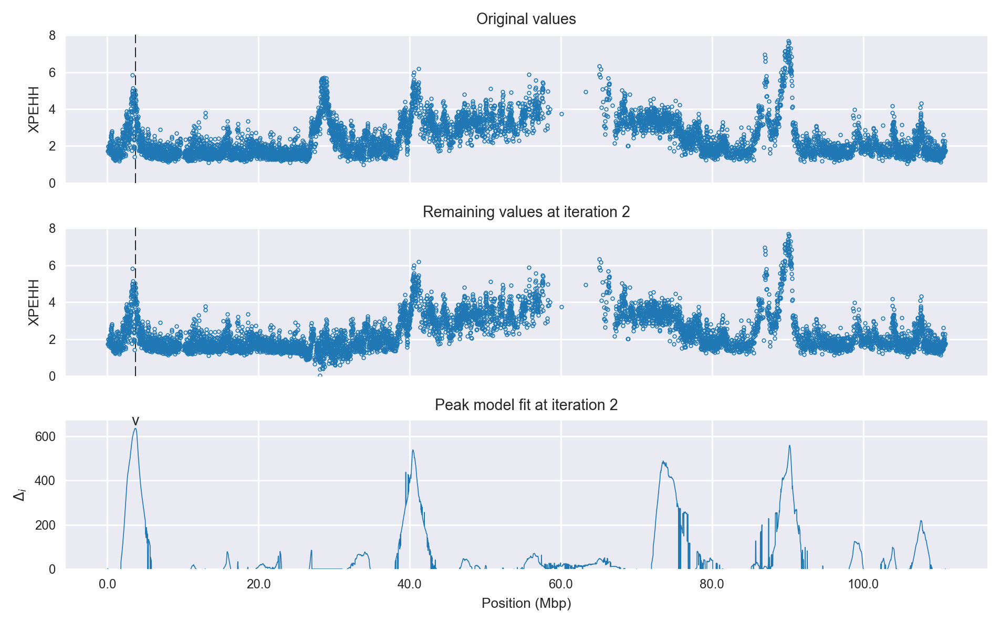

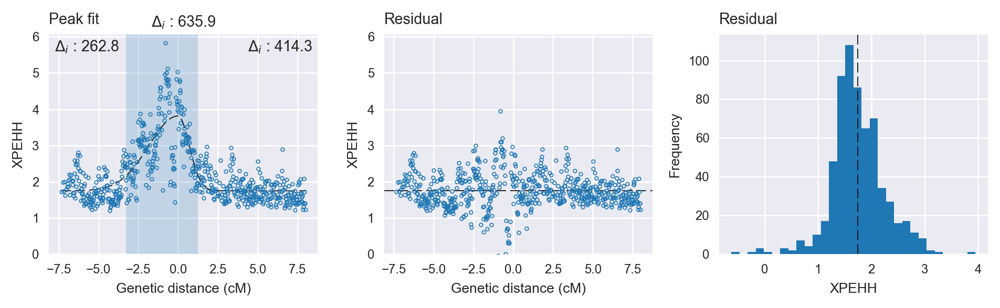

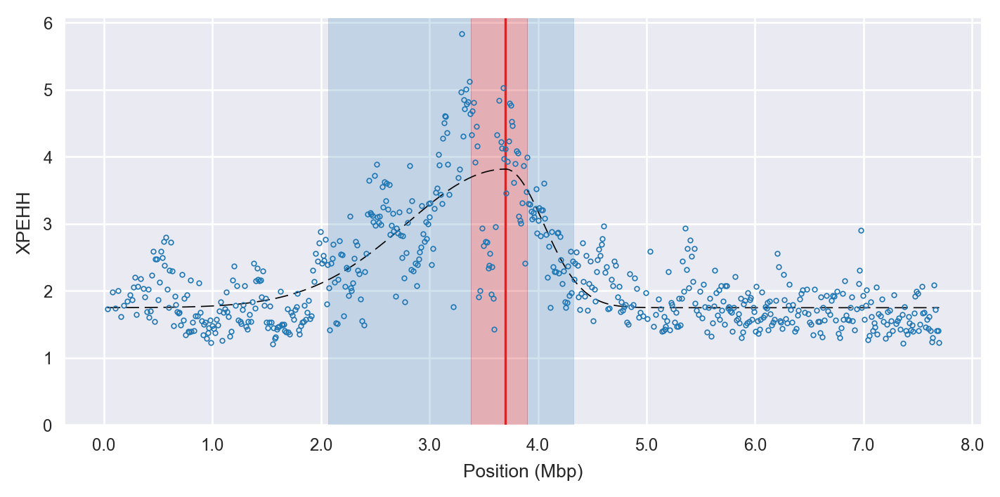

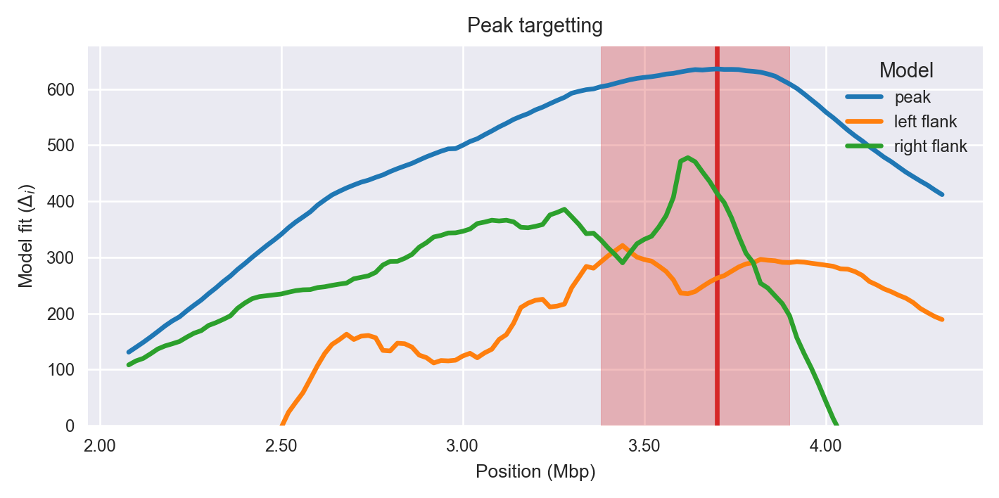

find the next peak
next peak: 4513 559.413
Iteration 3
Peak center (index, location): 4513, 90260001.0
Delta AIC: 559.4
Flank delta AICs: 135.8, 391.7
find limits of peak
peak limits: 87440148 90959785 4373 4549
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 132
    # data points      = 390
    # variables        = 5
    chi-square         = 267.659
    reduced chi-square = 0.695
    Akaike info crit   = -136.808
    Bayesian info crit = -116.978
[[Variables]]
    center:      0 (fixed)
    amplitude:   5.83145202 +/- 0.288887 (4.95%) (init= 3)
    decay:       0.78451270 +/- 0.076612 (9.77%) (init= 1)
    skew:        1.99999999 +/- 0.027343 (1.37%) (init= 0)
    baseline:    2.02491374 +/- 0.071390 (3.53%) (init= 1)
    ceiling:     6.90961269 +/- 0.170198 (2.46%) (init= 5)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(decay, skew)               =  0.672 
  

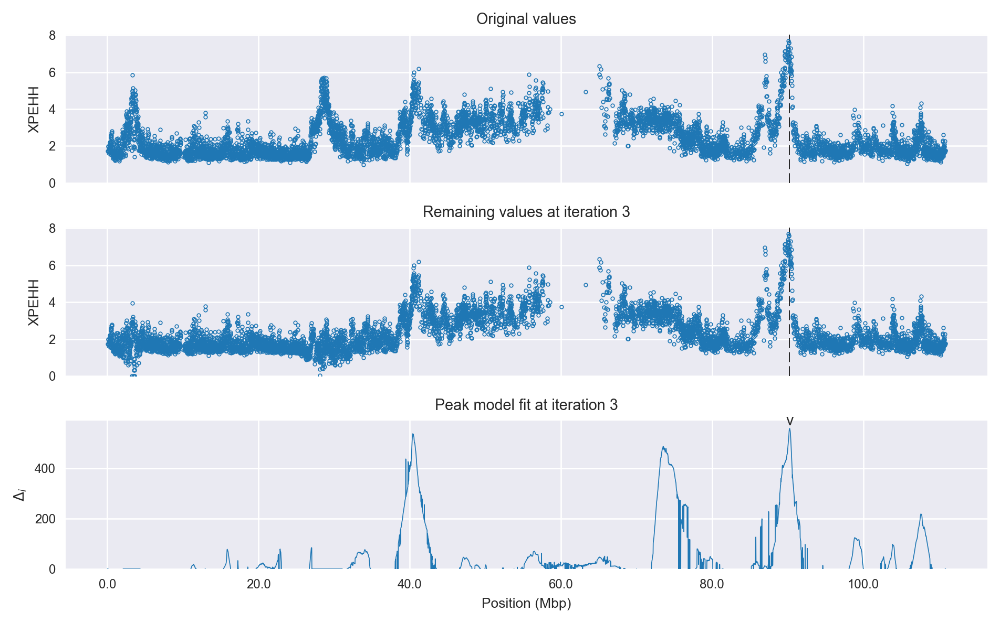

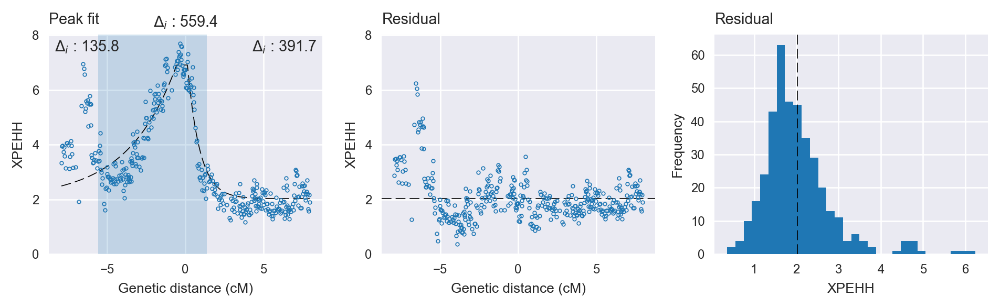

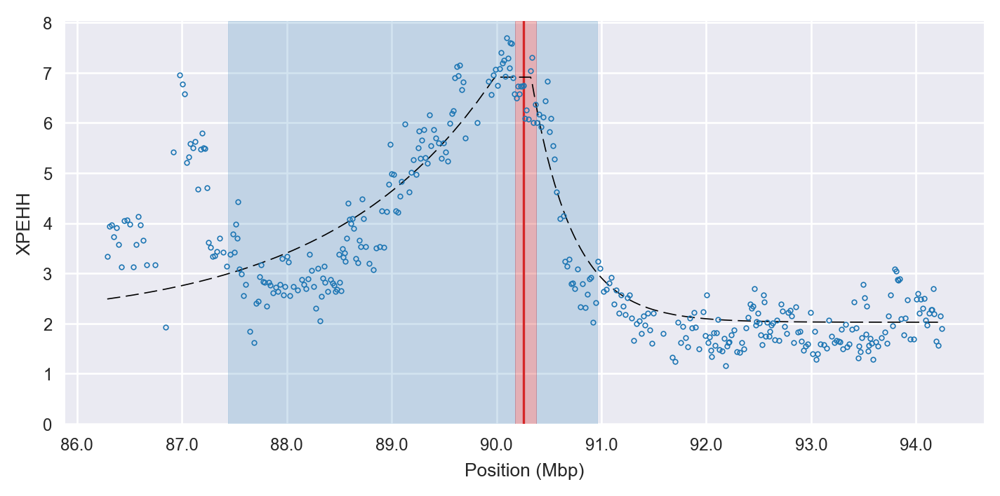

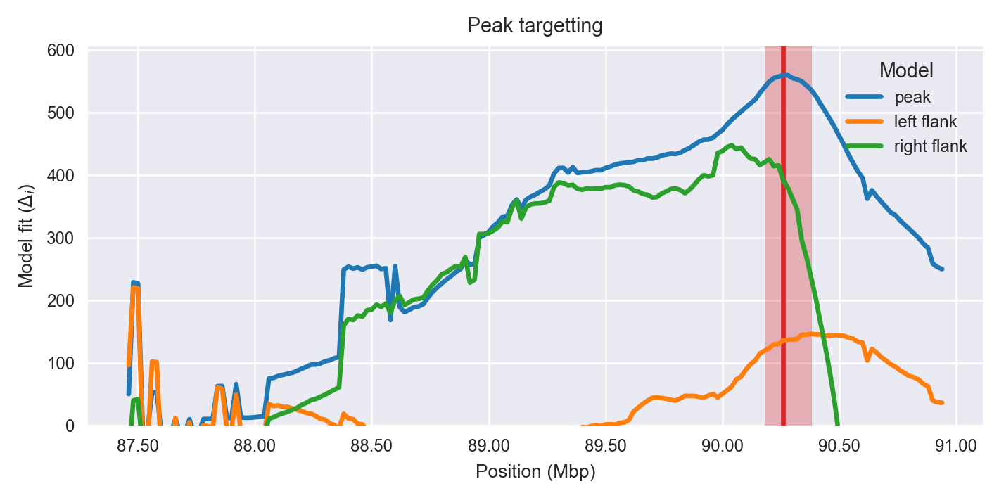

find the next peak
next peak: 2021 538.749
Iteration 4
Peak center (index, location): 2021, 40420001.0
Delta AIC: 538.7
Flank delta AICs: 200.7, 233.7
find limits of peak
peak limits: 39536345 43712144 1977 2187
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 89
    # data points      = 543
    # variables        = 5
    chi-square         = 189.127
    reduced chi-square = 0.352
    Akaike info crit   = -562.697
    Bayesian info crit = -541.212
[[Variables]]
    center:      0 (fixed)
    amplitude:   2.77041214 +/- 0.099023 (3.57%) (init= 3)
    decay:       3.99999993 +/- 0.120496 (3.01%) (init= 1)
    skew:       -1.90065498 +/- 0.112303 (5.91%) (init= 0)
    baseline:    2.27693988 +/- 0.051041 (2.24%) (init= 1)
    ceiling:     4.95622145 +/- 0.197635 (3.99%) (init= 5)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(decay, baseline)           =  0.607 
   

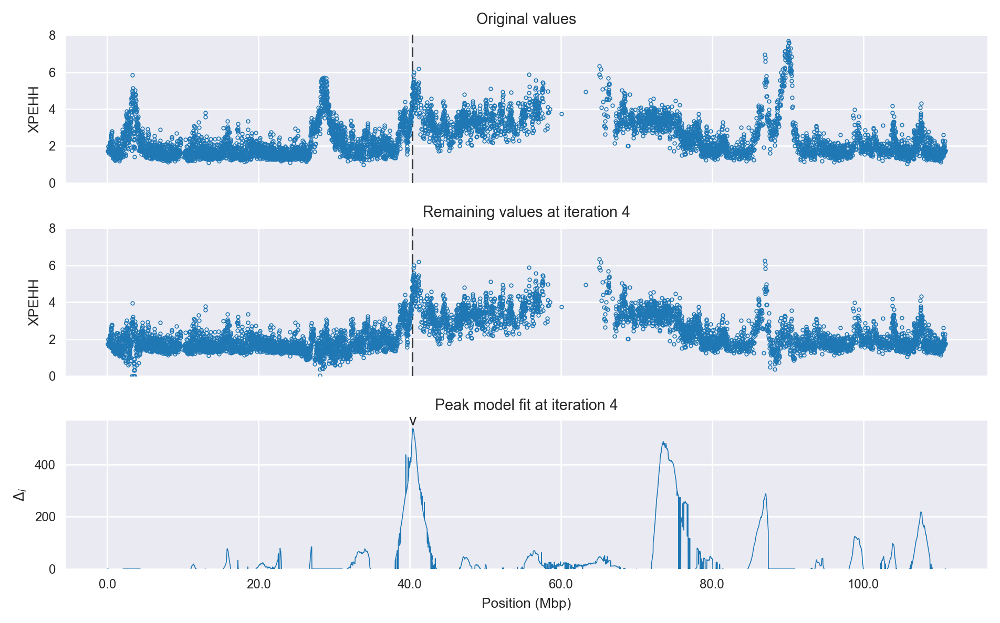

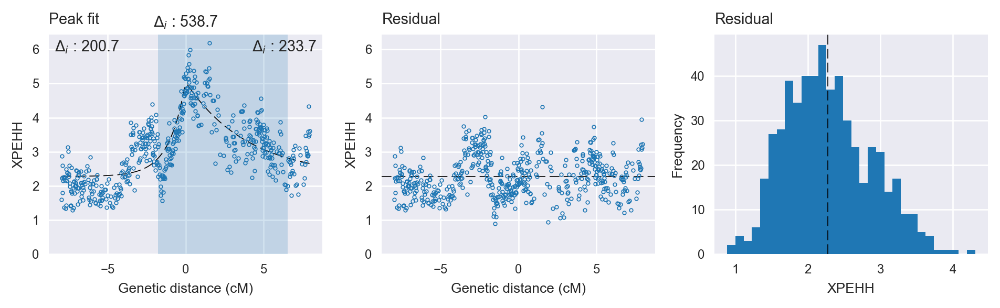

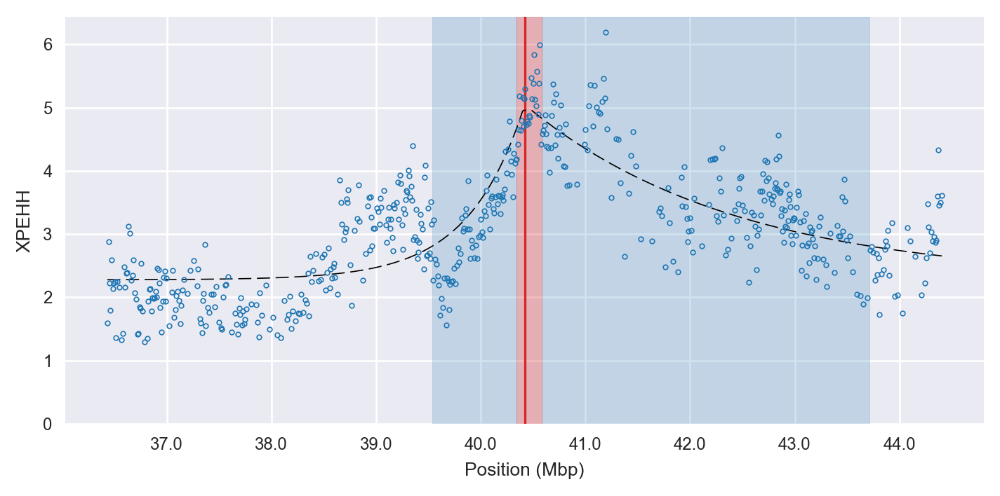

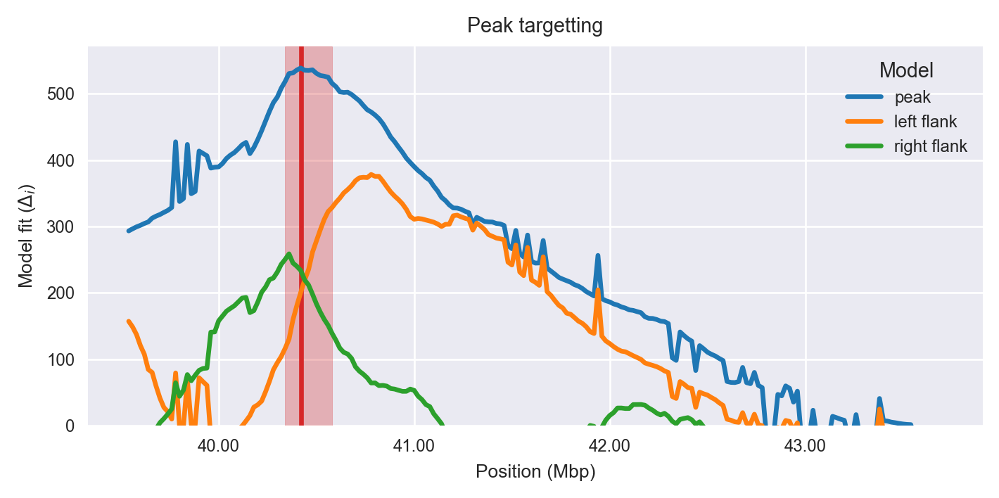

find the next peak
next peak: 3677 488.66
Iteration 5
Peak center (index, location): 3677, 73540001.0
Delta AIC: 488.7
Flank delta AICs: 7.2, 268.2
find limits of peak
peak limits: 69540443 76709575 3478 3837
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 65
    # data points      = 591
    # variables        = 4
    chi-square         = 88.584
    reduced chi-square = 0.151
    Akaike info crit   = -1113.637
    Bayesian info crit = -1096.110
[[Variables]]
    center:      0 (fixed)
    amplitude:   1.36174793 +/- 0.103955 (7.63%) (init= 3)
    sigma:       3.53131714 +/- 0.318747 (9.03%) (init= 1)
    skew:        1.82264810 +/- 0.230735 (12.66%) (init= 0)
    baseline:    2.11711278 +/- 0.106798 (5.04%) (init= 1)
    ceiling:     500 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, baseline)       = -0.966 
   

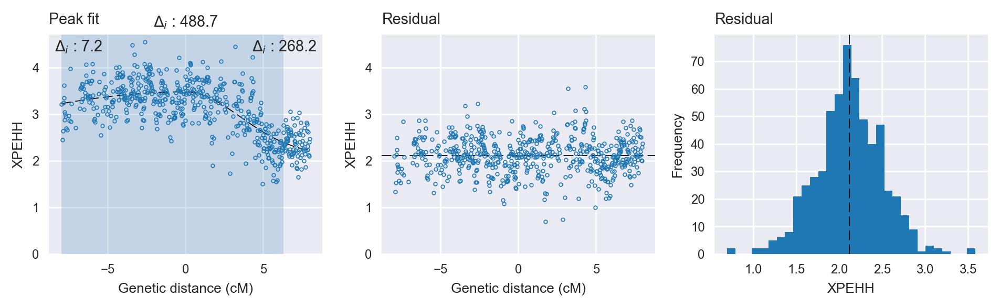

find the next peak
next peak: 4356 288.401
Iteration 5
Peak center (index, location): 4356, 87120001.0
Delta AIC: 288.4
Flank delta AICs: 201.7, 99.8
find limits of peak
peak limits: 85762660 87440147 4289 4374
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 121
    # data points      = 370
    # variables        = 5
    chi-square         = 126.311
    reduced chi-square = 0.346
    Akaike info crit   = -387.660
    Bayesian info crit = -368.092
[[Variables]]
    center:      0 (fixed)
    amplitude:   3.61997635 +/- 0.287019 (7.93%) (init= 3)
    decay:       0.38514342 +/- 0.056182 (14.59%) (init= 1)
    skew:        1.99997234 +/- 0.177021 (8.85%) (init= 0)
    baseline:    1.75482304 +/- 0.041023 (2.34%) (init= 1)
    ceiling:     4.88534663 +/- 0.240158 (4.92%) (init= 5)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(decay, skew)               = -0.739 
  

KeyboardInterrupt: 

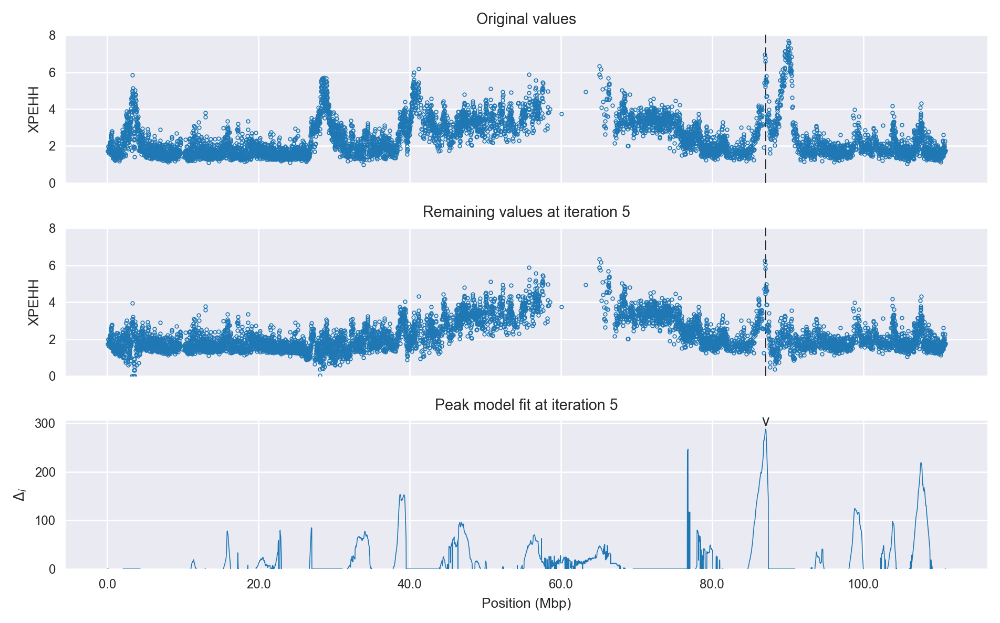

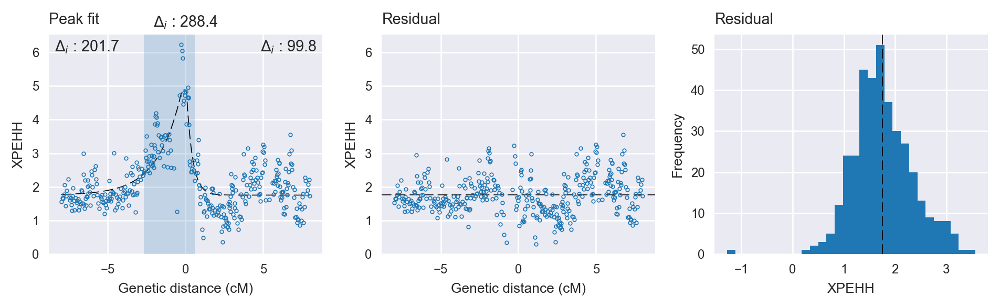

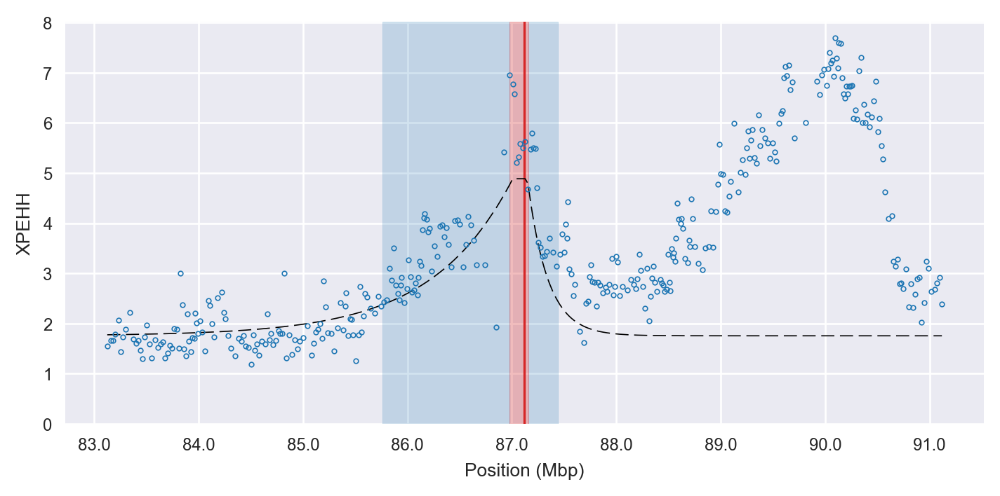

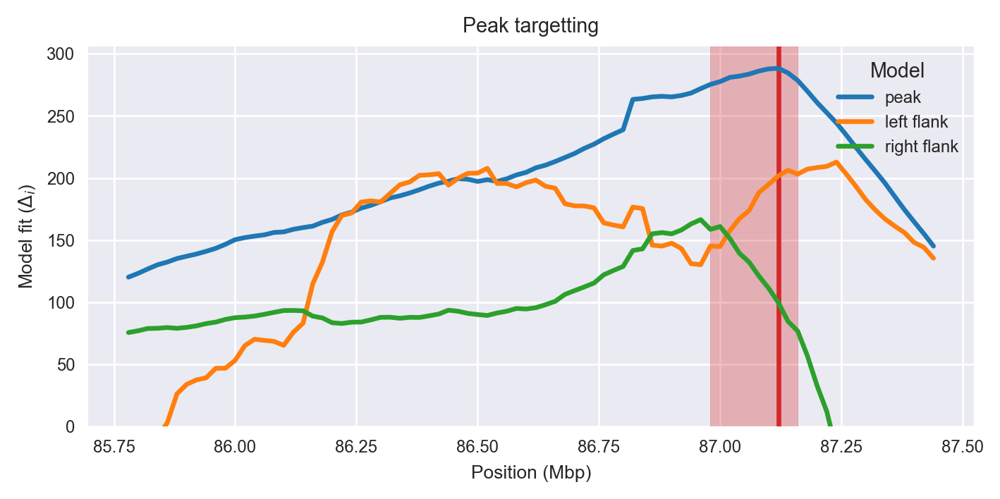

In [30]:
peaks = peakfit.find_peaks(starts=starts, ends=ends, values=values, percentiles=percentiles, centers=centers, 
                           gflank=8, gmap=gmap['2'], fitters=[skewed_exp_fitter, skewed_gauss_fitter], show_plots=True, statistic_label='XPEHH', 
                           log_file=None)
peaks = list(peaks)

In [ ]:
starts, ends, values, percentiles = peakfit.extract_windowed_values(df, seqid=('3R', '3L'), genome=genome)
peakfit.plot_windowed_values(starts, ends, values, ylabel='XPEHH');
peakfit.plot_windowed_values(starts, ends, values, ylabel='XPEHH', gmap=gmap['3']);
plt.show()
centers = np.arange(1, ends[-1], 20000)

In [ ]:
peaks = peakfit.find_peaks(starts=starts, ends=ends, values=values, percentiles=percentiles, centers=centers, 
                           gflank=8, gmap=gmap['3'], fitters=[skewed_gauss_fitter], show_plots=True, statistic_label='XPEHH', 
                           log_file=None)
peaks = list(peaks)

In [ ]:
peaks = peakfit.find_peaks(starts=starts, ends=ends, values=values, percentiles=percentiles, centers=centers, 
                           gflank=8, gmap=gmap['3'], fitters=[skewed_exp_fitter], show_plots=True, statistic_label='XPEHH', 
                           log_file=None)
peaks = list(peaks)

In [ ]:
peaks = peakfit.find_peaks(starts=starts, ends=ends, values=values, percentiles=percentiles, centers=centers, 
                           gflank=8, gmap=gmap['3'], fitters=[skewed_exp_fitter, skewed_gauss_fitter], show_plots=True, statistic_label='XPEHH', 
                           log_file=None)
peaks = list(peaks)